Details given in the project- Zomato Data Analysis is one of the most useful analysis for foodies who want to taste the best
cuisines of every part of the world which lies in their budget. This analysis is also for those who
want to find the value for money restaurants in various parts of the country for the cuisines.
Additionally, this analysis caters the needs of people who are striving to get the best cuisine of
the country and which locality of that country serves that cuisines with maximum number of
restaurants.

objective of the project- In this dataset predict 2 things –
1) Average Cost for two
2) Price range

The solution of the project is given below-

Part-1

lets import the necessary packages in order to eda, visual and non-visual analysis of our porject.

In [71]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy
from sklearn import *
import statsmodels.api as sm
import networkx as nx
import requests
from flask import Flask
import sqlalchemy
import pytest
import tkinter as tk
import openpyxl

lets upload the database from the url and create a dataframe from it. we will be using the read_excel comaand to read the excel file- country_code.csv

In [72]:
url = 'https://github.com/dsrscientist/dataset4/raw/main/Country-Code.xlsx'
zomato1_data = pd.read_excel(url)
print(zomato1_data)

    Country Code         Country
0              1           India
1             14       Australia
2             30          Brazil
3             37          Canada
4             94       Indonesia
5            148     New Zealand
6            162     Phillipines
7            166           Qatar
8            184       Singapore
9            189    South Africa
10           191       Sri Lanka
11           208          Turkey
12           214             UAE
13           215  United Kingdom
14           216   United States


now lets upload the database from the second url and create a dataframe using the encoding=ISO-8859-1 to read the Zomato.csv file.

In [73]:
url = 'https://raw.githubusercontent.com/dsrscientist/dataset4/main/zomato.csv'
zomato2_data = pd.read_csv(url, encoding='ISO-8859-1')
print(zomato2_data)

      Restaurant ID           Restaurant Name  Country Code              City  \
0           6317637          Le Petit Souffle           162       Makati City   
1           6304287          Izakaya Kikufuji           162       Makati City   
2           6300002    Heat - Edsa Shangri-La           162  Mandaluyong City   
3           6318506                      Ooma           162  Mandaluyong City   
4           6314302               Sambo Kojin           162  Mandaluyong City   
...             ...                       ...           ...               ...   
9546        5915730              NamlÛ± Gurme           208         ÛÁstanbul   
9547        5908749             Ceviz AÛôacÛ±           208         ÛÁstanbul   
9548        5915807                     Huqqa           208         ÛÁstanbul   
9549        5916112              Aôôk Kahve           208         ÛÁstanbul   
9550        5927402  Walter's Coffee Roastery           208         ÛÁstanbul   

                           

now lets merge the two dataframes using the pd.merge command with a inner join on their country code column. 

In [75]:
zomato_data = pd.merge(zomato1_data, zomato2_data, on='Country Code', how='inner')
print(zomato_data)

      Country Code        Country  Restaurant ID  \
0                1          India        3400025   
1                1          India        3400341   
2                1          India        3400005   
3                1          India        3400021   
4                1          India        3400017   
...            ...            ...            ...   
9546           216  United States       17697389   
9547           216  United States       17697424   
9548           216  United States       17697332   
9549           216  United States       17694056   
9550           216  United States       17559793   

                               Restaurant Name            City  \
0                                   Jahanpanah            Agra   
1                          Rangrezz Restaurant            Agra   
2                      Time2Eat - Mama Chicken            Agra   
3        Chokho Jeeman Marwari Jain Bhojanalya            Agra   
4                               Pinch Of Spic

now lets get the first 30 values of our merged dataframe

In [10]:
zomato_data.head(30)

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1,India,3400025,Jahanpanah,Agra,"E 23, Shopping Arcade, Sadar Bazaar, Agra Cant...",Agra Cantt,"Agra Cantt, Agra",78.011544,27.161661,...,Indian Rupees(Rs.),No,No,No,No,3,3.9,Yellow,Good,140
1,1,India,3400341,Rangrezz Restaurant,Agra,"E-20, Shopping Arcade, Sadar Bazaar, Agra Cant...",Agra Cantt,"Agra Cantt, Agra",0.000000,0.000000,...,Indian Rupees(Rs.),No,No,No,No,2,3.5,Yellow,Good,71
2,1,India,3400005,Time2Eat - Mama Chicken,Agra,"Main Market, Sadar Bazaar, Agra Cantt, Agra",Agra Cantt,"Agra Cantt, Agra",78.011608,27.160832,...,Indian Rupees(Rs.),No,No,No,No,2,3.6,Yellow,Good,94
3,1,India,3400021,Chokho Jeeman Marwari Jain Bhojanalya,Agra,"1/48, Delhi Gate, Station Road, Raja Mandi, Ci...",Civil Lines,"Civil Lines, Agra",77.998092,27.195928,...,Indian Rupees(Rs.),No,No,No,No,2,4.0,Green,Very Good,87
4,1,India,3400017,Pinch Of Spice,Agra,"23/453, Opposite Sanjay Cinema, Wazipura Road,...",Civil Lines,"Civil Lines, Agra",78.007553,27.201725,...,Indian Rupees(Rs.),No,No,No,No,3,4.2,Green,Very Good,177
5,1,India,3400325,MoMo Cafe,Agra,"Courtyard by Marriott Agra, Phase 2, Fatehabad...","Courtyard by Marriott Agra, Tajganj","Courtyard by Marriott Agra, Tajganj, Agra",0.000000,0.000000,...,Indian Rupees(Rs.),No,No,No,No,4,4.0,Green,Very Good,45
6,1,India,3400059,Peshawri - ITC Mughal,Agra,"ITC Mughal, Fatehabad Road, Tajganj, Agra","ITC Mughal, Tajganj","ITC Mughal, Tajganj, Agra",78.044095,27.160934,...,Indian Rupees(Rs.),No,No,No,No,4,4.3,Green,Very Good,133
7,1,India,3400060,Taj Bano - ITC Mughal,Agra,"ITC Mughal, Fatehabad Road, Tajganj, Agra","ITC Mughal, Tajganj","ITC Mughal, Tajganj, Agra",78.044095,27.160934,...,Indian Rupees(Rs.),No,No,No,No,4,4.0,Green,Very Good,41
8,1,India,3400348,G Thal,Agra,"3/20, KPS Tower, Near Tulsi Talkies, Bypass Ro...",Khandari,"Khandari, Agra",0.000000,0.000000,...,Indian Rupees(Rs.),No,No,No,No,3,3.6,Yellow,Good,59
9,1,India,3400072,Dawat-e-Nawab - Radisson Blu,Agra,"Radisson Blu, Taj East Gate Road, Tajganj, Agra","Radisson Blu, Tajganj","Radisson Blu, Tajganj, Agra",78.057044,27.163303,...,Indian Rupees(Rs.),No,No,No,No,4,3.8,Yellow,Good,46


now lets get the last 30 values in the dataframe

In [11]:
zomato_data.tail(30)

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
9521,216,United States,17678229,Masato Japanese,Valdosta,"1337 Baytree Rd, Valdosta, GA 31602",Valdosta,"Valdosta, Valdosta",-83.310343,30.846763,...,Dollar($),No,No,No,No,2,3.9,Yellow,Good,262
9522,216,United States,17678097,Mom & Dad's Italian Restaurant,Valdosta,"4143 N Valdosta Rd, Valdosta, GA 31602",Valdosta,"Valdosta, Valdosta",-83.328300,30.897100,...,Dollar($),No,No,No,No,2,3.7,Yellow,Good,183
9523,216,United States,17678216,Mori's Japanese Steakhouse & Sushi Bar,Valdosta,"1709 Norman Dr, Valdosta, GA 31601",Valdosta,"Valdosta, Valdosta",-83.318958,30.841547,...,Dollar($),No,No,No,No,4,3.5,Yellow,Good,208
9524,216,United States,17678233,Passage 2 India,Valdosta,"2910 N Ashley St Ste E, Valdosta, GA 31602",Valdosta,"Valdosta, Valdosta",-83.289338,30.871140,...,Dollar($),No,No,No,No,2,3.8,Yellow,Good,245
9525,216,United States,17678148,Rodeo Mexican Restaurant,Valdosta,"2801 N Ashley St, Valdosta, GA 31602",Valdosta,"Valdosta, Valdosta",-83.286800,30.868000,...,Dollar($),No,No,No,No,2,3.8,Yellow,Good,199
9526,216,United States,17678291,Steel Magnolias,Valdosta,"132 N. Patterson St, Valdosta, GA 31601",Valdosta,"Valdosta, Valdosta",-83.279600,30.831600,...,Dollar($),No,No,No,No,3,3.8,Yellow,Good,225
9527,216,United States,17678218,Smok'n Pig B-B-Q,Valdosta,"4228 N Valdosta Rd, Valdosta, GA 31602",Valdosta,"Valdosta, Valdosta",-83.332796,30.897087,...,Dollar($),No,No,No,No,2,4.1,Green,Very Good,575
9528,216,United States,17558738,Blue House Cafe,Vernonia,"919 Bridge St, Vernonia, OR 97064",Vernonia,"Vernonia, Vernonia",-123.195437,45.858667,...,Dollar($),No,No,No,No,1,4.3,Green,Very Good,88
9529,216,United States,17697444,Masala Grill & Coffee House,Waterloo,"911 W 23rd St, Cedar Falls, IA 50613",Cedar Falls,"Cedar Falls, Waterloo",-92.456343,42.516908,...,Dollar($),No,No,No,No,1,3.2,Orange,Average,18
9530,216,United States,17696871,Brown Bottle The Cedar Falls,Waterloo,"1111 Center St, Cedar Falls, IA 50613",Cedar Falls,"Cedar Falls, Waterloo",-92.450700,42.546400,...,Dollar($),No,No,No,No,2,3.7,Yellow,Good,134


We got the following details from the dataframe-

Restaurant Id: Unique id of every restaurant across various cities of the world
• Restaurant Name: Name of the restaurant
• Country Code: Country in which restaurant is located
• City: City in which restaurant is located
• Address: Address of the restaurant
• Locality: Location in the city
• Locality Verbose: Detailed description of the locality
• Longitude: Longitude coordinate of the restaurant&#39;s location
• Latitude: Latitude coordinate of the restaurant&#39;s location
• Cuisines: Cuisines offered by the restaurant
• Average Cost for two: Cost for two people in different currencies ��
• Currency: Currency of the country
• Has Table booking: yes/no
• Has Online delivery: yes/ no
• Is delivering: yes/ no
• Switch to order menu: yes/no
• Price range: range of price of food
• Aggregate Rating: Average rating out of 5
• Rating color: depending upon the average rating color
• Rating text: text on the basis of rating of rating
• Votes: Number of ratings casted by people


now lets label encode few columns in the dataframe to convert their non-integer values into integer values.

In [76]:
from sklearn.preprocessing import LabelEncoder
columns_to_encode = ['Restaurant Name', 'City', 'Address', 'Locality', 'Locality Verbose', 'Cuisines','Currency','Has Table booking','Has Online delivery','Is delivering now','Switch to order menu','Rating color','Rating text','Country']
label_encoder = LabelEncoder()
for column in columns_to_encode:
    zomato_data[column] = label_encoder.fit_transform(zomato_data[column])

now lets get the data types of our dataframe after conversion

In [16]:
zomato_data.dtypes

Country Code              int64
Country                   int32
Restaurant ID             int64
Restaurant Name           int64
City                      int64
Address                   int64
Locality                  int64
Locality Verbose          int64
Longitude               float64
Latitude                float64
Cuisines                  int64
Average Cost for two      int64
Currency                  int64
Has Table booking         int64
Has Online delivery       int64
Is delivering now         int64
Switch to order menu      int64
Price range               int64
Aggregate rating        float64
Rating color              int64
Rating text               int64
Votes                     int64
dtype: object

now lets convert the data types of the int 64 and int32 values in the dataframe into float64 values.

In [77]:
zomato_data['Country Code']= zomato_data['Country Code'].astype(float)
zomato_data['Country']= zomato_data['Country'].astype(float)
zomato_data['Restaurant ID']= zomato_data['Restaurant ID'].astype(float)
zomato_data['Restaurant Name']= zomato_data['Restaurant Name'].astype(float)
zomato_data['City']= zomato_data['City'].astype(float)
zomato_data['Address']= zomato_data['Address'].astype(float)
zomato_data['Locality']= zomato_data['Locality'].astype(float)
zomato_data['Locality Verbose']= zomato_data['Locality Verbose'].astype(float)
zomato_data['Cuisines']= zomato_data['Cuisines'].astype(float)
zomato_data['Average Cost for two']= zomato_data['Average Cost for two'].astype(float)
zomato_data['Currency']= zomato_data['Currency'].astype(float)
zomato_data['Has Table booking']= zomato_data['Has Table booking'].astype(float)
zomato_data['Has Online delivery']= zomato_data['Has Online delivery'].astype(float)
zomato_data['Is delivering now']= zomato_data['Is delivering now'].astype(float)
zomato_data['Switch to order menu']= zomato_data['Switch to order menu'].astype(float)
zomato_data['Price range']= zomato_data['Price range'].astype(float)
zomato_data['Rating color']= zomato_data['Rating color'].astype(float)
zomato_data['Rating text']= zomato_data['Rating text'].astype(float)
zomato_data['Votes']= zomato_data['Votes'].astype(float)

lets check the data types of the dataframe again.

In [78]:
zomato_data.dtypes

Country Code            float64
Country                 float64
Restaurant ID           float64
Restaurant Name         float64
City                    float64
Address                 float64
Locality                float64
Locality Verbose        float64
Longitude               float64
Latitude                float64
Cuisines                float64
Average Cost for two    float64
Currency                float64
Has Table booking       float64
Has Online delivery     float64
Is delivering now       float64
Switch to order menu    float64
Price range             float64
Aggregate rating        float64
Rating color            float64
Rating text             float64
Votes                   float64
dtype: object

now lets declare the x variable/input variable for the first part of our project using the iloc and join method

In [19]:
zomato_dataxvariable_data = zomato_data.iloc[:, :11].join(zomato_data.iloc[:, 12:])
zomato_dataxvariable_data

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1.0,3.0,3400025.0,3201.0,1.0,4553.0,17.0,17.0,78.011544,27.161661,...,4.0,0.0,0.0,0.0,0.0,3.0,3.9,5.0,2.0,140.0
1,1.0,3.0,3400341.0,5261.0,1.0,4605.0,17.0,17.0,0.000000,0.000000,...,4.0,0.0,0.0,0.0,0.0,2.0,3.5,5.0,2.0,71.0
2,1.0,3.0,3400005.0,6919.0,1.0,6234.0,17.0,17.0,78.011608,27.160832,...,4.0,0.0,0.0,0.0,0.0,2.0,3.6,5.0,2.0,94.0
3,1.0,3.0,3400021.0,1637.0,1.0,100.0,204.0,205.0,77.998092,27.195928,...,4.0,0.0,0.0,0.0,0.0,2.0,4.0,1.0,5.0,87.0
4,1.0,3.0,3400017.0,4922.0,1.0,1316.0,204.0,205.0,78.007553,27.201725,...,4.0,0.0,0.0,0.0,0.0,3.0,4.2,1.0,5.0,177.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,14.0,17697389.0,6794.0,135.0,1279.0,1174.0,1231.0,-92.335523,42.498400,...,2.0,0.0,0.0,0.0,0.0,1.0,3.7,5.0,2.0,101.0
9547,216.0,14.0,17697424.0,6839.0,135.0,2667.0,1174.0,1231.0,-92.335769,42.497919,...,2.0,0.0,0.0,0.0,0.0,1.0,3.5,5.0,2.0,58.0
9548,216.0,14.0,17697332.0,6945.0,135.0,957.0,1174.0,1231.0,-92.323400,42.465580,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,156.0
9549,216.0,14.0,17694056.0,6883.0,136.0,1910.0,1176.0,1233.0,-80.529488,40.396043,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,156.0


now lets get the y variable/output variable for the first part of the project= average cost for two

In [20]:
zomato_datayvariable_data = zomato_data.iloc[:, 11:12]
zomato_datayvariable_data

,Average Cost for two
0,850.0
1,700.0
2,500.0
3,400.0
4,1000.0
...,...
9546,10.0
9547,10.0
9548,25.0
9549,25.0


lets get the shape/dimensions of the dataframe

In [21]:
zomato_data.shape

(9551, 22)

now lets see if there are any null-values in the dataframe

In [22]:
zomato_data.isnull().sum().sum()

0

In [23]:
zomato_data.isnull().sum()

Country Code            0
Country                 0
Restaurant ID           0
Restaurant Name         0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                0
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

In [ ]:
There are no null-values in the dataframe, so lets visualise it using the heatmap.

<Axes: >

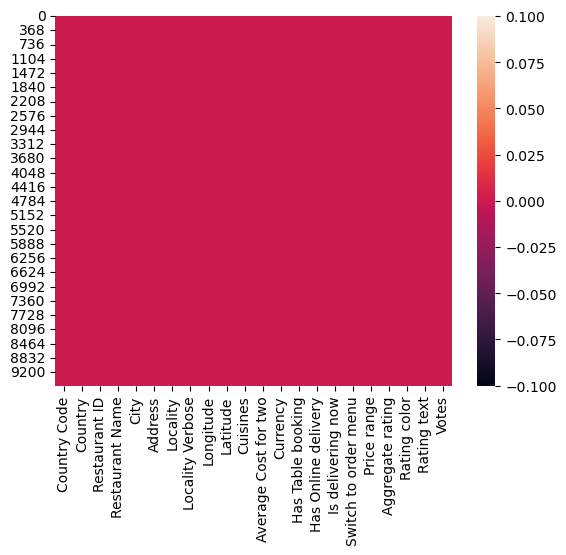

In [24]:
sns.heatmap(zomato_data.isnull())

now lets get the value counts of the output column

In [25]:
zomato_data_counts = zomato_data['Average Cost for two'].value_counts()
print(zomato_data_counts)

500.0       900
300.0       897
400.0       857
200.0       687
600.0       652
           ... 
70000.0       1
165000.0      1
450000.0      1
120000.0      1
4300.0        1
Name: Average Cost for two, Length: 140, dtype: int64


now lets get some description from the dataframe

In [26]:
zomato_data_details =  zomato_data.describe()
print(zomato_data_details)

       Country Code      Country  Restaurant ID  Restaurant Name         City  \
count   9551.000000  9551.000000   9.551000e+03      9551.000000  9551.000000   
mean      18.365616     3.736781   9.051128e+06      3653.204586    78.301434   
std       56.750546     2.651963   8.791521e+06      2142.917876    23.198915   
min        1.000000     0.000000   5.300000e+01         0.000000     0.000000   
25%        1.000000     3.000000   3.019625e+05      1777.500000    76.000000   
50%        1.000000     3.000000   6.004089e+06      3595.000000    88.000000   
75%        1.000000     3.000000   1.835229e+07      5485.500000    88.000000   
max      216.000000    14.000000   1.850065e+07      7445.000000   140.000000   

           Address     Locality  Locality Verbose    Longitude     Latitude  \
count  9551.000000  9551.000000       9551.000000  9551.000000  9551.000000   
mean   4542.439430   658.128468        677.304994    64.126574    25.854381   
std    2565.717005   315.866515  

Since there are way too many columns, it is not possible to get the details of all the columns in the dataframe. the only conclusion we can get is that the total count of all the columns is 9551.000000. 

In [ ]:
lets get some information from the dataframe.

In [27]:
zomato_data_info = zomato_data.info
print(zomato_data_info)

<bound method DataFrame.info of       Country Code  Country  Restaurant ID  Restaurant Name   City  Address  \
0              1.0      3.0      3400025.0           3201.0    1.0   4553.0   
1              1.0      3.0      3400341.0           5261.0    1.0   4605.0   
2              1.0      3.0      3400005.0           6919.0    1.0   6234.0   
3              1.0      3.0      3400021.0           1637.0    1.0    100.0   
4              1.0      3.0      3400017.0           4922.0    1.0   1316.0   
...            ...      ...            ...              ...    ...      ...   
9546         216.0     14.0     17697389.0           6794.0  135.0   1279.0   
9547         216.0     14.0     17697424.0           6839.0  135.0   2667.0   
9548         216.0     14.0     17697332.0           6945.0  135.0    957.0   
9549         216.0     14.0     17694056.0           6883.0  136.0   1910.0   
9550         216.0     14.0     17559793.0           2342.0  138.0    962.0   

      Locality  Loc

now lets get the absolute values from the dataframe

In [28]:
absolute_df = zomato_data.abs()
print(absolute_df)

      Country Code  Country  Restaurant ID  Restaurant Name   City  Address  \
0              1.0      3.0      3400025.0           3201.0    1.0   4553.0   
1              1.0      3.0      3400341.0           5261.0    1.0   4605.0   
2              1.0      3.0      3400005.0           6919.0    1.0   6234.0   
3              1.0      3.0      3400021.0           1637.0    1.0    100.0   
4              1.0      3.0      3400017.0           4922.0    1.0   1316.0   
...            ...      ...            ...              ...    ...      ...   
9546         216.0     14.0     17697389.0           6794.0  135.0   1279.0   
9547         216.0     14.0     17697424.0           6839.0  135.0   2667.0   
9548         216.0     14.0     17697332.0           6945.0  135.0    957.0   
9549         216.0     14.0     17694056.0           6883.0  136.0   1910.0   
9550         216.0     14.0     17559793.0           2342.0  138.0    962.0   

      Locality  Locality Verbose   Longitude   Lati

now lets get the list of all the columns in the dataframe

In [29]:
zomato_data.columns

Index(['Country Code', 'Country', 'Restaurant ID', 'Restaurant Name', 'City',
       'Address', 'Locality', 'Locality Verbose', 'Longitude', 'Latitude',
       'Cuisines', 'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')

lets get the list of uniaue values of our output column in the dataframe

In [30]:
(zomato_data['Average Cost for two'].unique())

array([8.50e+02, 7.00e+02, 5.00e+02, 4.00e+02, 1.00e+03, 2.00e+03,
       2.50e+03, 8.00e+02, 3.60e+03, 0.00e+00, 5.50e+02, 1.10e+03,
       1.50e+03, 9.00e+02, 1.80e+03, 3.00e+02, 1.40e+03, 3.50e+02,
       4.50e+02, 6.00e+02, 9.50e+02, 1.20e+03, 2.00e+02, 1.00e+02,
       1.50e+02, 6.50e+02, 1.30e+03, 2.40e+03, 2.50e+02, 1.60e+03,
       2.20e+03, 7.50e+02, 1.70e+03, 1.25e+03, 1.90e+03, 2.70e+03,
       3.50e+03, 5.00e+03, 2.30e+03, 1.75e+03, 3.20e+03, 3.00e+03,
       2.10e+03, 1.85e+03, 4.50e+03, 4.00e+03, 3.30e+03, 1.20e+02,
       1.35e+03, 1.65e+03, 1.95e+03, 1.05e+03, 2.90e+02, 5.00e+01,
       1.45e+03, 2.80e+03, 2.60e+02, 3.65e+03, 4.80e+03, 1.55e+03,
       7.20e+02, 6.50e+03, 7.00e+03, 1.15e+03, 2.90e+03, 2.60e+03,
       4.70e+03, 3.70e+03, 3.80e+03, 4.10e+03, 4.30e+03, 2.65e+03,
       6.00e+03, 5.10e+03, 5.50e+03, 4.40e+03, 4.20e+03, 8.00e+03,
       2.35e+03, 2.00e+01, 7.00e+00, 3.00e+01, 5.50e+01, 4.50e+01,
       6.00e+01, 8.00e+01, 9.00e+01, 2.30e+02, 2.40e+02, 1.40e

now lets get the number of unique values in the dataframe

In [31]:
(zomato_data['Average Cost for two'].nunique())

140

now lets get the value counts of all the columns in the dataframe

In [32]:
for i in zomato_data.columns:
    print(zomato_data[i].value_counts())
    print("/n")

1.0      8652
216.0     434
215.0      80
30.0       60
189.0      60
214.0      60
148.0      40
208.0      34
14.0       24
162.0      22
94.0       21
166.0      20
184.0      20
191.0      20
37.0        4
Name: Country Code, dtype: int64
/n
3.0     8652
14.0     434
13.0      80
1.0       60
9.0       60
12.0      60
5.0       40
11.0      34
0.0       24
6.0       22
4.0       21
7.0       20
8.0       20
10.0      20
2.0        4
Name: Country, dtype: int64
/n
3400025.0     1
309811.0      1
18460981.0    1
18287389.0    1
1629.0        1
             ..
4096.0        1
18358700.0    1
2217.0        1
18398571.0    1
17559793.0    1
Name: Restaurant ID, Length: 9551, dtype: int64
/n
1099.0    83
2099.0    79
6106.0    63
2717.0    51
4077.0    48
          ..
1650.0     1
6896.0     1
6688.0     1
1189.0     1
2342.0     1
Name: Restaurant Name, Length: 7446, dtype: int64
/n
88.0     5473
50.0     1118
89.0     1080
43.0      251
48.0       25
         ... 
133.0       1
139.0  

Below are the details(most number of occurences) from the above lists

1)Country Code:1.0   =   8652
2)Country:3.0   =  8652
3)Restaurant Name:1099.0  =  83
4)City: 88.0   =  5473
5)Address:7486.0  =  11
6)Locality:216.0  =   122
7)Locality Verbose:222.0   =  122
8)Longitude:0 = 498
9)Latitude:0.000000  =   498
10)Cuisines:1306.0  =  936
11)Average Cost for two:500.0   =    900
12)Currency:4.0  =   8652
13)Has Table booking:0.0  =  8393
14)Has Online delivery:0.0 =   7100
15)Is delivering now:0.0  =  9517
16)Switch to order menu:0.0  =  9551
17)Price range:1.0  =  4444
18)Aggregate rating:0.0  =  2148
19)Rating color:2.0  =  3737
20)Rating text:0.0  =  3737
21)Votes:0.0    =   1094

lets create the dataframe made of columns with float64 values 

In [85]:
zomato_data_col=[]
for i in zomato_data.dtypes.index:
    if zomato_data.dtypes[i] == 'float64':
        zomato_data_col.append(i)
print("zomato_data_cateogry columns:", zomato_data_col)
print("/n")

zomato_data_cateogry columns: ['Country Code', 'Country', 'Restaurant ID', 'Restaurant Name', 'City', 'Address', 'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines', 'Average Cost for two', 'Currency', 'Has Table booking', 'Has Online delivery', 'Is delivering now', 'Switch to order menu', 'Price range', 'Aggregate rating', 'Rating color', 'Rating text', 'Votes']
/n


now lets check that all our columns doesnt consist of any null values

In [34]:
zomato_data.loc[zomato_data["Average Cost for two"]==""]

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes


lets get the mean of our output column 

In [35]:
print(zomato_data["Average Cost for two"].mean())

1199.2107632708617


now lets get the number of unique values of all the columns in the dataframe.

In [36]:
zomato_data.nunique().to_frame("No. of Unique values")

,No. of Unique values
Country Code,15
Country,15
Restaurant ID,9551
Restaurant Name,7446
City,141
Address,8918
Locality,1208
Locality Verbose,1265
Longitude,8120
Latitude,8677


lets get the maximum and minimum scores of the output column

In [8]:
print("max scores:",zomato_data["Average Cost for two"].max())
print("min scores:",zomato_data["Average Cost for two"].min())

max scores: 800000.0
min scores: 0.0


In [ ]:
Univariate analysis

Below are the details(most number of occurences) from the above lists

1)Country Code:1.0   =   8652
2)Country:3.0   =  8652
3)Restaurant Name:1099.0  =  83
4)City: 88.0   =  5473
5)Address:7486.0  =  11
6)Locality:216.0  =   122
7)Locality Verbose:222.0   =  122
8)Longitude:0 = 498
9)Latitude:0.000000  =   498
10)Cuisines:1306.0  =  936
11)Average Cost for two:500.0   =    900
12)Currency:4.0  =   8652
13)Has Table booking:0.0  =  8393
14)Has Online delivery:0.0 =   7100
15)Is delivering now:0.0  =  9517
16)Switch to order menu:0.0  =  9551
17)Price range:1.0  =  4444
18)Aggregate rating:0.0  =  2148
19)Rating color:2.0  =  3737
20)Rating text:0.0  =  3737
21)Votes:0.0    =   1094

Countplots

1.0      8652
216.0     434
215.0      80
30.0       60
189.0      60
214.0      60
148.0      40
208.0      34
14.0       24
162.0      22
94.0       21
166.0      20
184.0      20
191.0      20
37.0        4
Name: Country Code, dtype: int64


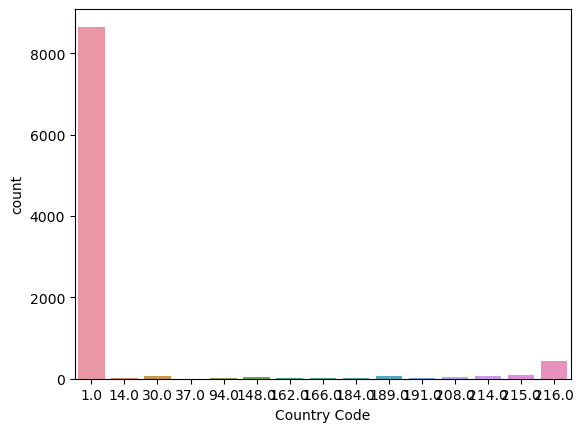

In [40]:
zc=sns.countplot(x='Country Code',data=zomato_data)
print(zomato_data['Country Code'].value_counts())

3.0     8652
14.0     434
13.0      80
1.0       60
9.0       60
12.0      60
5.0       40
11.0      34
0.0       24
6.0       22
4.0       21
7.0       20
8.0       20
10.0      20
2.0        4
Name: Country, dtype: int64


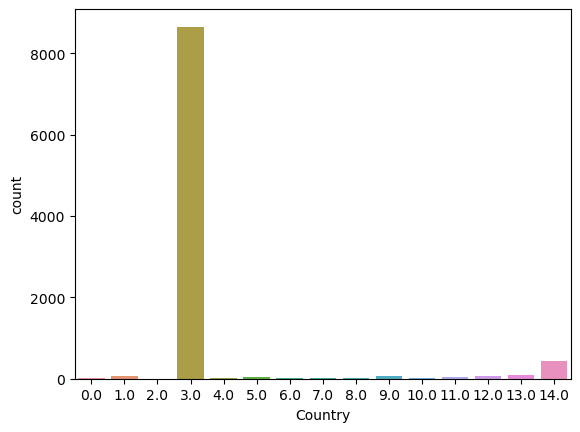

In [41]:
zc=sns.countplot(x='Country',data=zomato_data)
print(zomato_data['Country'].value_counts())

3400025.0     1
309811.0      1
18460981.0    1
18287389.0    1
1629.0        1
             ..
4096.0        1
18358700.0    1
2217.0        1
18398571.0    1
17559793.0    1
Name: Restaurant ID, Length: 9551, dtype: int64


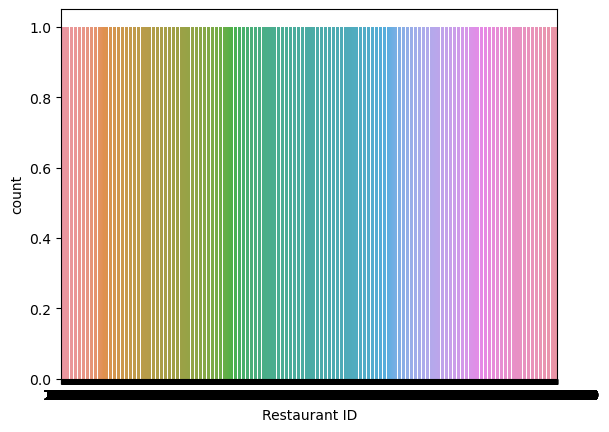

In [42]:
zc=sns.countplot(x='Restaurant ID',data=zomato_data)
print(zomato_data['Restaurant ID'].value_counts())

1099.0    83
2099.0    79
6106.0    63
2717.0    51
4077.0    48
          ..
1650.0     1
6896.0     1
6688.0     1
1189.0     1
2342.0     1
Name: Restaurant Name, Length: 7446, dtype: int64


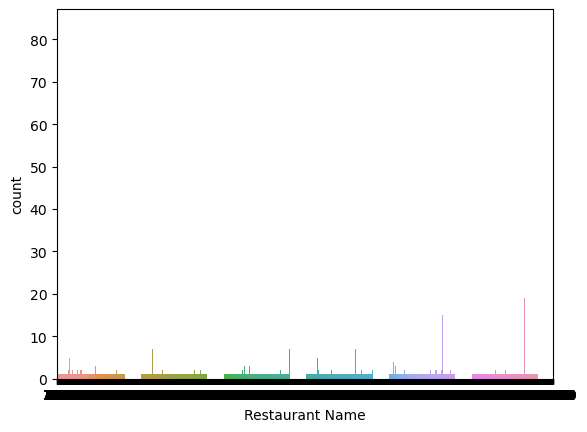

In [43]:
zc=sns.countplot(x='Restaurant Name',data=zomato_data)
print(zomato_data['Restaurant Name'].value_counts())

88.0     5473
50.0     1118
89.0     1080
43.0      251
48.0       25
         ... 
133.0       1
139.0       1
13.0        1
107.0       1
138.0       1
Name: City, Length: 141, dtype: int64


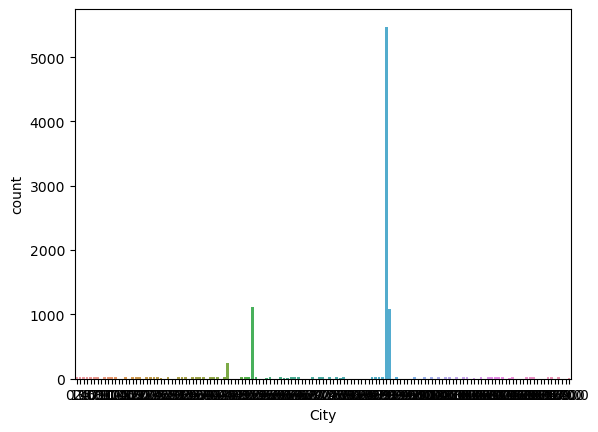

In [44]:
zc=sns.countplot(x='City',data=zomato_data)
print(zomato_data['City'].value_counts())

7486.0    11
4527.0    11
5312.0    10
8649.0     9
8652.0     8
          ..
5077.0     1
8570.0     1
8281.0     1
3258.0     1
962.0      1
Name: Address, Length: 8918, dtype: int64


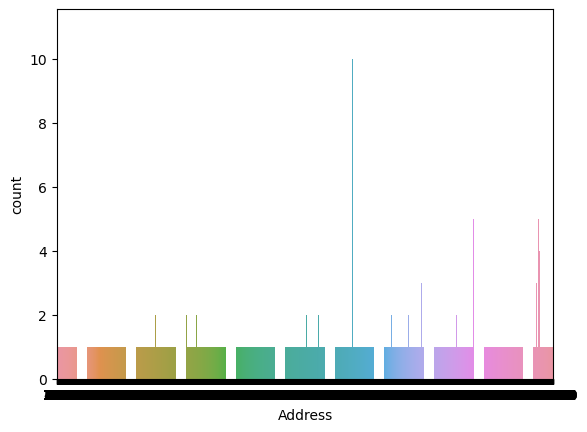

In [45]:
zc=sns.countplot(x='Address',data=zomato_data)
print(zomato_data['Address'].value_counts())

216.0     122
835.0      99
971.0      87
274.0      86
794.0      85
         ... 
1169.0      1
65.0        1
93.0        1
111.0       1
1186.0      1
Name: Locality, Length: 1208, dtype: int64


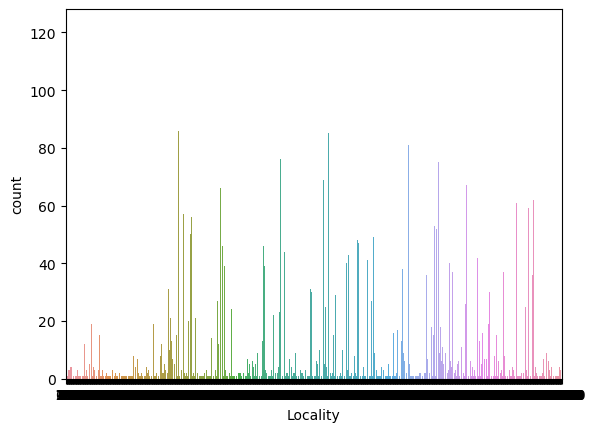

In [46]:
zc=sns.countplot(x='Locality',data=zomato_data)
print(zomato_data['Locality'].value_counts())

222.0     122
848.0      99
1024.0     87
280.0      86
805.0      85
         ... 
440.0       1
661.0       1
787.0       1
416.0       1
1243.0      1
Name: Locality Verbose, Length: 1265, dtype: int64


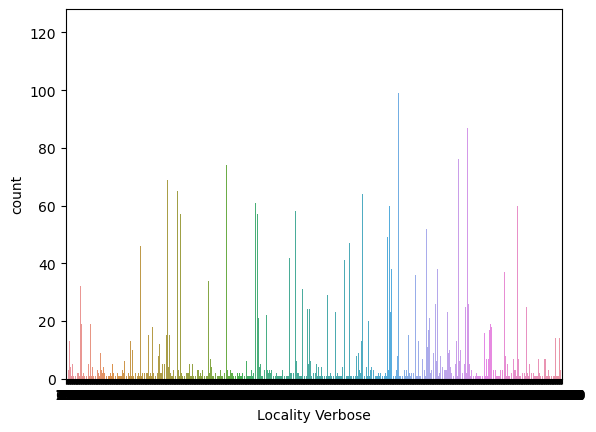

In [47]:
zc=sns.countplot(x='Locality Verbose',data=zomato_data)
print(zomato_data['Locality Verbose'].value_counts())

 0.000000      498
 77.353663      19
 77.230412      12
 77.088688      10
 77.251426       9
              ... 
 77.303872       1
 77.307939       1
 77.299597       1
 77.299004       1
-124.175346      1
Name: Longitude, Length: 8120, dtype: int64


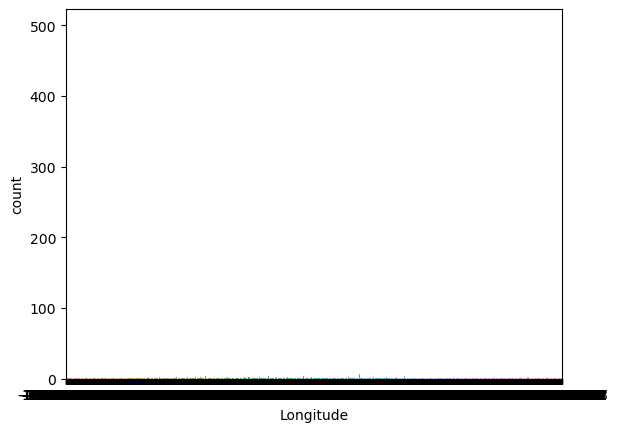

In [48]:
zc=sns.countplot(x='Longitude',data=zomato_data)
print(zomato_data['Longitude'].value_counts())

0.000000     498
28.574309     16
28.551456      9
28.574300      9
28.597103      8
            ... 
28.701519      1
28.699157      1
28.694336      1
28.699116      1
43.678998      1
Name: Latitude, Length: 8677, dtype: int64


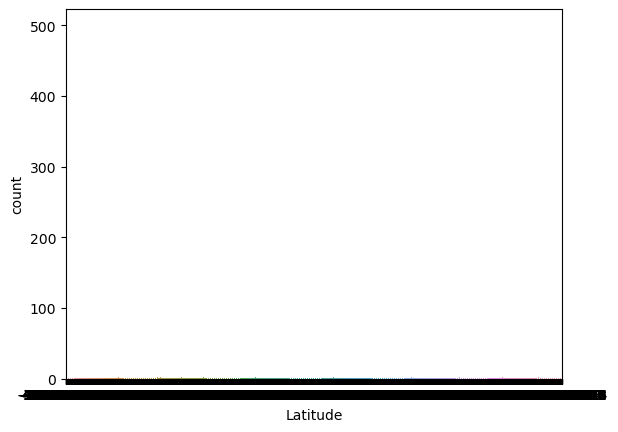

In [49]:
zc=sns.countplot(x='Latitude',data=zomato_data)
print(zomato_data['Latitude'].value_counts())

1306.0    936
1329.0    511
497.0     354
828.0     354
1514.0    334
         ... 
457.0       1
1404.0      1
647.0       1
1326.0      1
317.0       1
Name: Cuisines, Length: 1826, dtype: int64


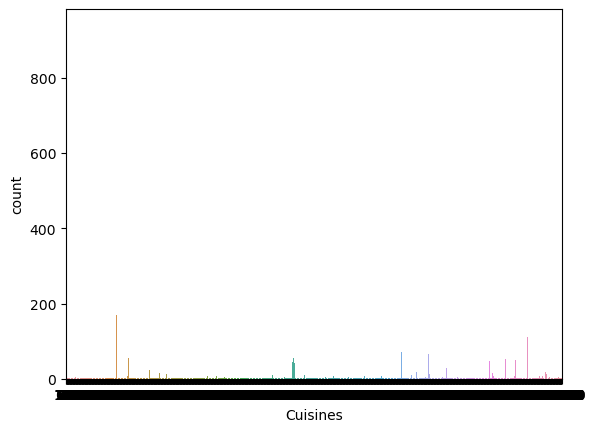

In [50]:
zc=sns.countplot(x='Cuisines',data=zomato_data)
print(zomato_data['Cuisines'].value_counts())

500.0       900
300.0       897
400.0       857
200.0       687
600.0       652
           ... 
70000.0       1
165000.0      1
450000.0      1
120000.0      1
4300.0        1
Name: Average Cost for two, Length: 140, dtype: int64


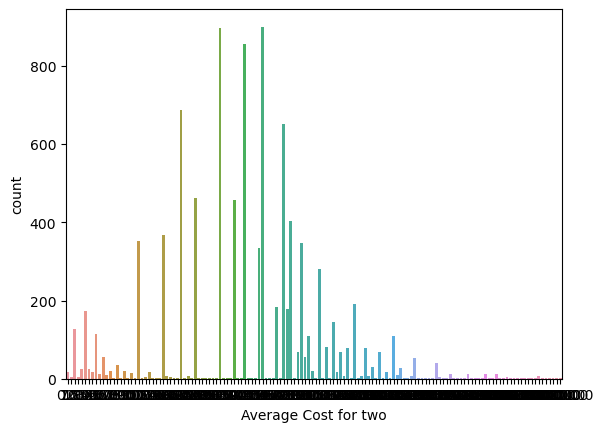

In [51]:
zc=sns.countplot(x='Average Cost for two',data=zomato_data)
print(zomato_data['Average Cost for two'].value_counts())

4.0     8652
2.0      482
7.0       80
1.0       60
9.0       60
3.0       60
6.0       40
11.0      34
0.0       22
5.0       21
8.0       20
10.0      20
Name: Currency, dtype: int64


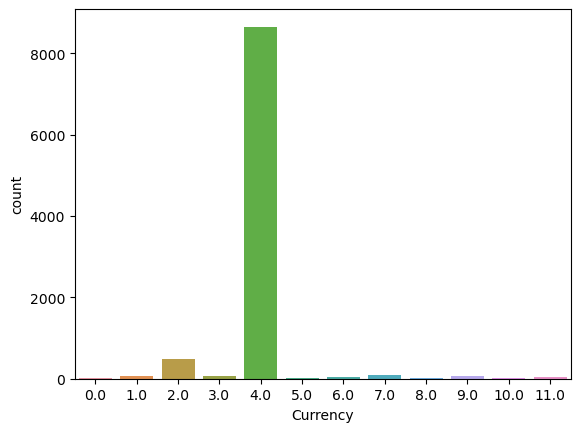

In [52]:
zc=sns.countplot(x='Currency',data=zomato_data)
print(zomato_data['Currency'].value_counts())

0.0    8393
1.0    1158
Name: Has Table booking, dtype: int64


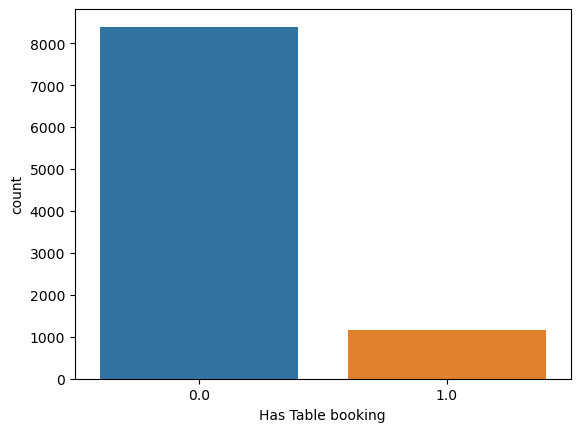

In [53]:
zc=sns.countplot(x='Has Table booking',data=zomato_data)
print(zomato_data['Has Table booking'].value_counts())

0.0    7100
1.0    2451
Name: Has Online delivery, dtype: int64


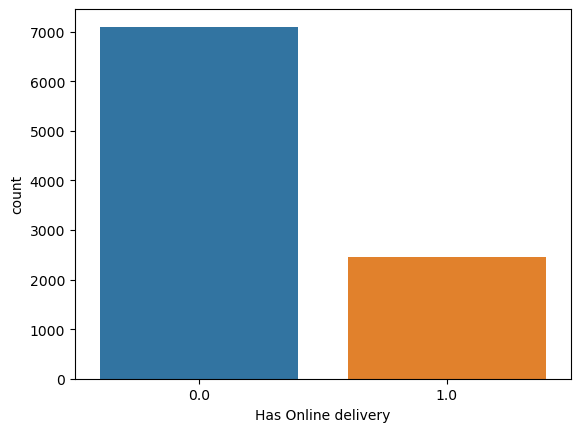

In [54]:
zc=sns.countplot(x='Has Online delivery',data=zomato_data)
print(zomato_data['Has Online delivery'].value_counts())

0.0    9517
1.0      34
Name: Is delivering now, dtype: int64


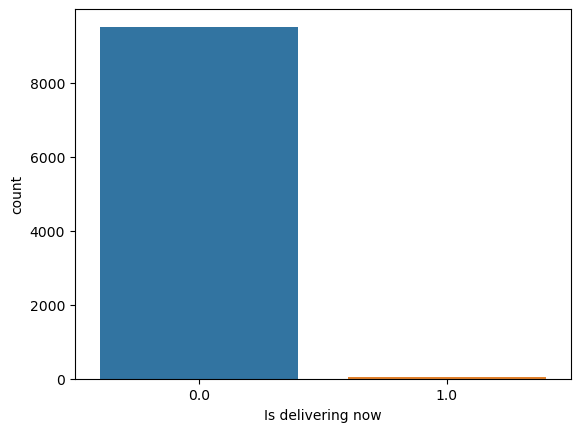

In [55]:
zc=sns.countplot(x='Is delivering now',data=zomato_data)
print(zomato_data['Is delivering now'].value_counts())

0.0    9551
Name: Switch to order menu, dtype: int64


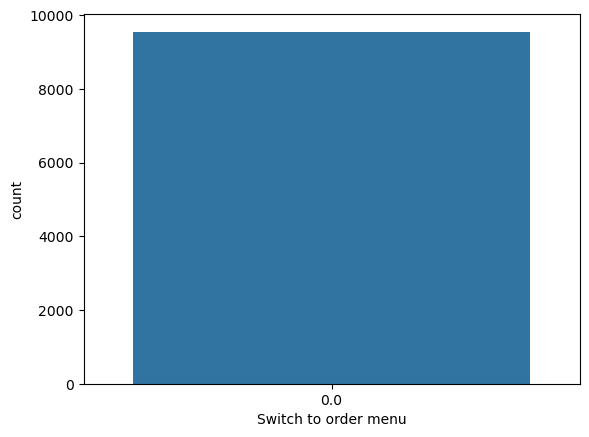

In [56]:
zc=sns.countplot(x='Switch to order menu',data=zomato_data)
print(zomato_data['Switch to order menu'].value_counts())

1.0    4444
2.0    3113
3.0    1408
4.0     586
Name: Price range, dtype: int64


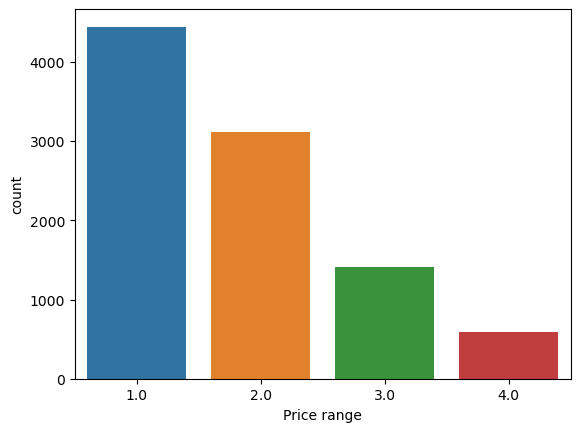

In [57]:
zc=sns.countplot(x='Price range',data=zomato_data)
print(zomato_data['Price range'].value_counts())

0.0    2148
3.2     522
3.1     519
3.4     498
3.3     483
3.5     480
3.0     468
3.6     458
3.7     427
3.8     400
2.9     381
3.9     335
2.8     315
4.1     274
4.0     266
2.7     250
4.2     221
2.6     191
4.3     174
4.4     144
2.5     110
4.5      95
2.4      87
4.6      78
4.9      61
2.3      47
4.7      42
2.2      27
4.8      25
2.1      15
2.0       7
1.9       2
1.8       1
Name: Aggregate rating, dtype: int64


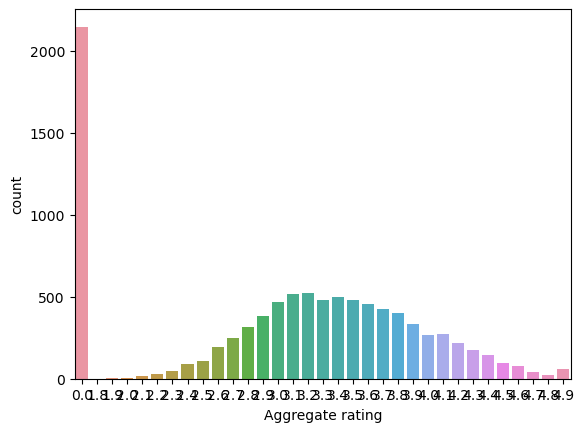

In [58]:
zc=sns.countplot(x='Aggregate rating',data=zomato_data)
print(zomato_data['Aggregate rating'].value_counts())

2.0    3737
4.0    2148
5.0    2100
1.0    1079
0.0     301
3.0     186
Name: Rating color, dtype: int64


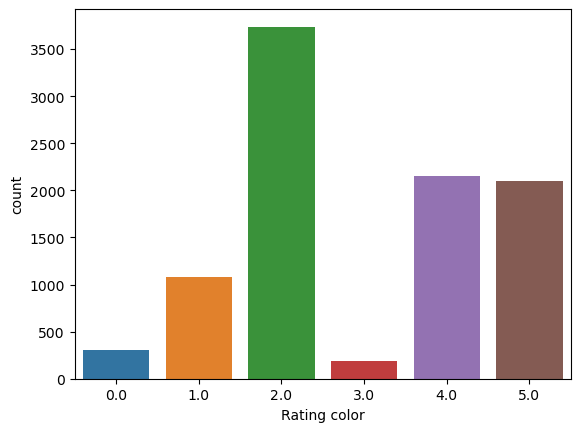

In [59]:
zc=sns.countplot(x='Rating color',data=zomato_data)
print(zomato_data['Rating color'].value_counts())

0.0    3737
3.0    2148
2.0    2100
5.0    1079
1.0     301
4.0     186
Name: Rating text, dtype: int64


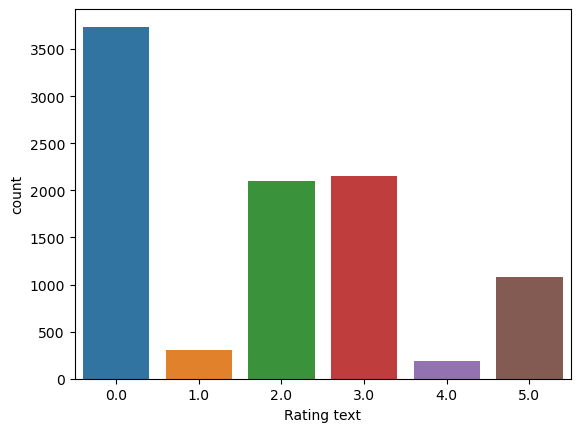

In [60]:
zc=sns.countplot(x='Rating text',data=zomato_data)
print(zomato_data['Rating text'].value_counts())

0.0       1094
1.0        483
2.0        327
3.0        244
4.0        207
          ... 
1801.0       1
1333.0       1
1863.0       1
1134.0       1
575.0        1
Name: Votes, Length: 1012, dtype: int64


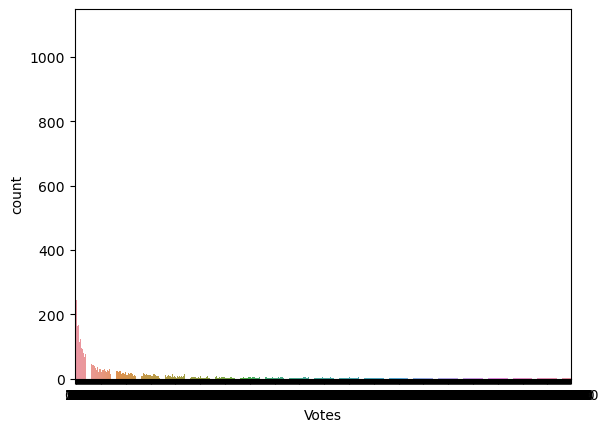

In [61]:
zc=sns.countplot(x='Votes',data=zomato_data)
print(zomato_data['Votes'].value_counts())

Distribution Plots

C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_17472\1467029836.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(zomato_data[col],color="b")
C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_17472\1467029836.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(zomato_data[col],color="b")


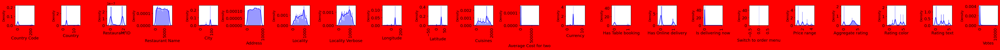

In [64]:
plt.figure(figsize=(45,45),facecolor = "red")
plotnumber=1
for col in zomato_data_col:
    if plotnumber<=23:
        wc=plt.subplot(22,22,plotnumber)
        sns.distplot(zomato_data[col],color="b")
        plt.xlabel(col,rotation=0,fontsize = 13)
        plt.xticks(rotation=90, fontsize=13)
        plt.yticks(rotation = 0, fontsize = 13)
    plotnumber+=1
plt.tight_layout()

Below are the details from the aboe distribution plots=

1)Country_code, Country,average cost for two, has table booking, has online delivery,is delivering now,price range,rating text, and votes are skewed to the left.
2)city,locality,locality verbose,longitude, latitude,  and cuisines are skewed to the right.

Bivariate analysis

Strip plots

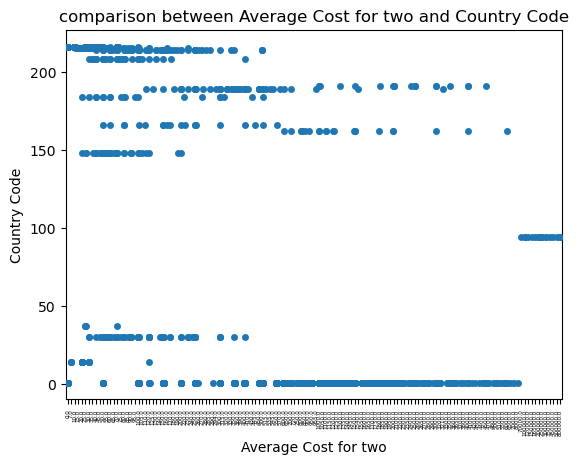

<Figure size 2800x200 with 0 Axes>

In [65]:
plt.title("comparison between Average Cost for two and Country Code")
sns.stripplot(x= "Average Cost for two", y= "Country Code", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

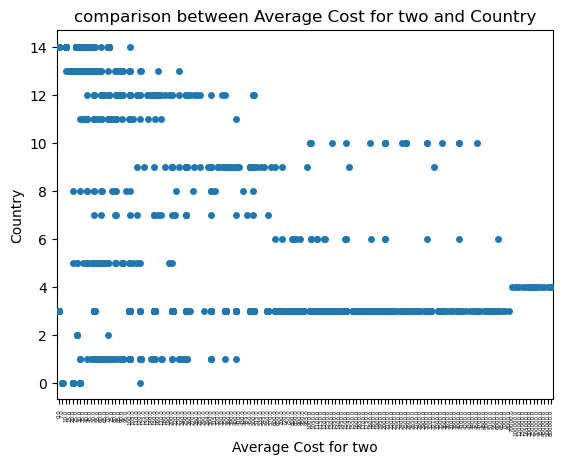

<Figure size 2800x200 with 0 Axes>

In [66]:
plt.title("comparison between Average Cost for two and Country")
sns.stripplot(x= "Average Cost for two", y= "Country", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

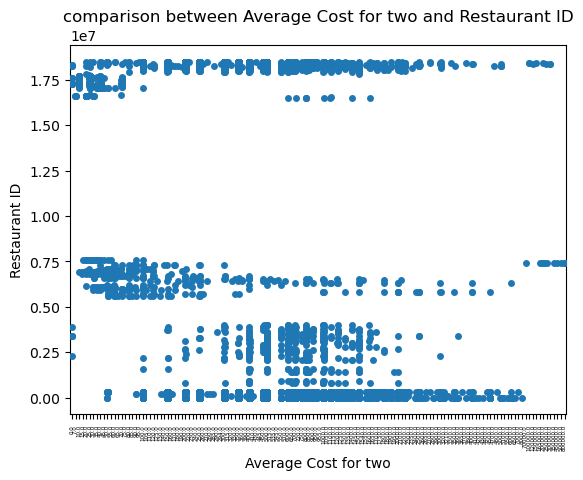

<Figure size 2800x200 with 0 Axes>

In [67]:
plt.title("comparison between Average Cost for two and Restaurant ID")
sns.stripplot(x= "Average Cost for two", y= "Restaurant ID", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

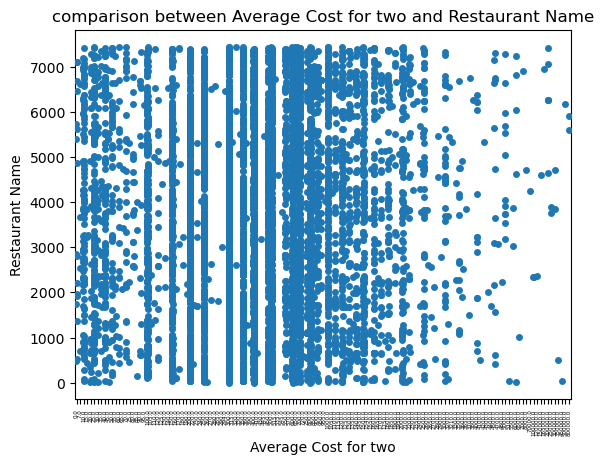

<Figure size 2800x200 with 0 Axes>

In [68]:
plt.title("comparison between Average Cost for two and Restaurant Name")
sns.stripplot(x= "Average Cost for two", y= "Restaurant Name", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

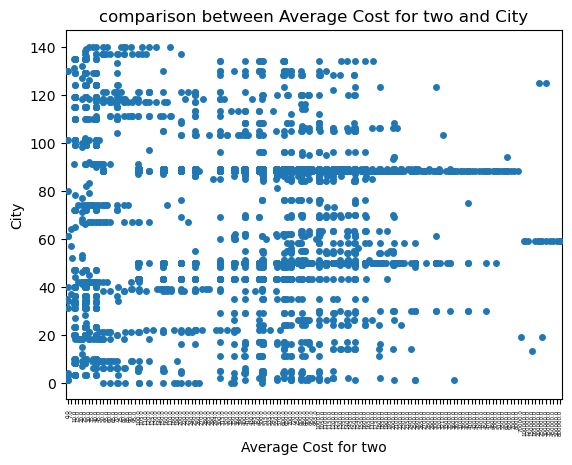

<Figure size 2800x200 with 0 Axes>

In [69]:
plt.title("comparison between Average Cost for two and City")
sns.stripplot(x= "Average Cost for two", y= "City", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

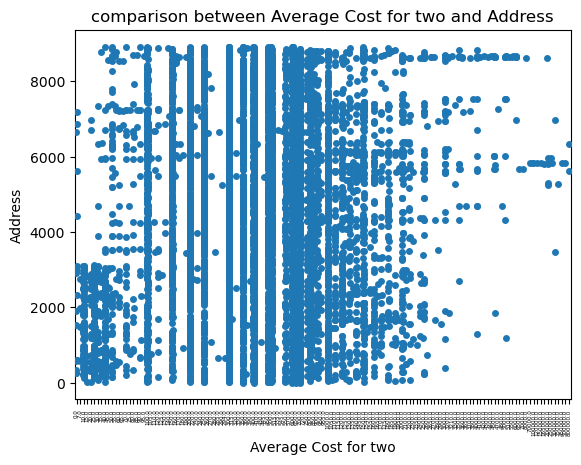

<Figure size 2800x200 with 0 Axes>

In [70]:
plt.title("comparison between Average Cost for two and Address")
sns.stripplot(x= "Average Cost for two", y= "Address", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

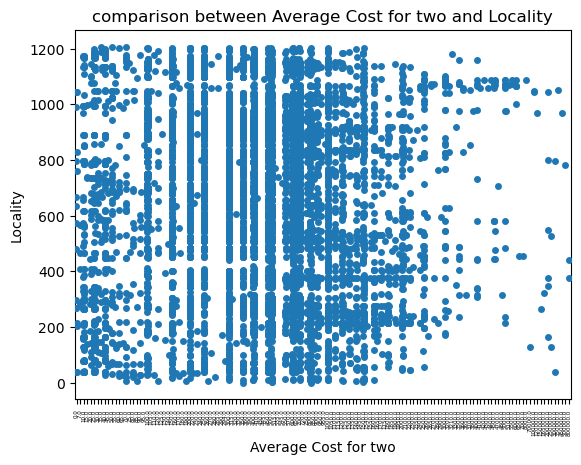

<Figure size 2800x200 with 0 Axes>

In [71]:
plt.title("comparison between Average Cost for two and Locality")
sns.stripplot(x= "Average Cost for two", y= "Locality", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

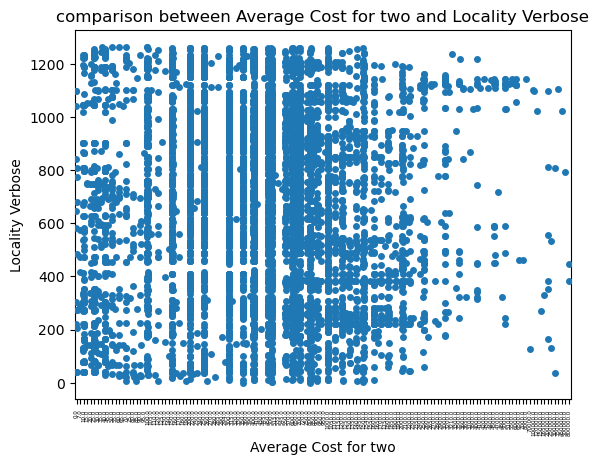

<Figure size 2800x200 with 0 Axes>

In [72]:
plt.title("comparison between Average Cost for two and Locality Verbose")
sns.stripplot(x= "Average Cost for two", y= "Locality Verbose", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

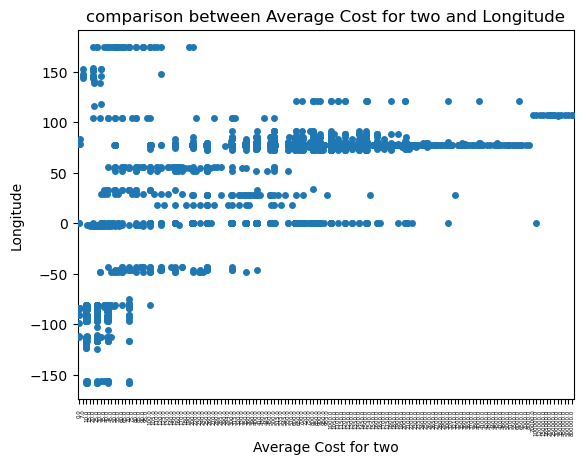

<Figure size 2800x200 with 0 Axes>

In [73]:
plt.title("comparison between Average Cost for two and Longitude")
sns.stripplot(x= "Average Cost for two", y= "Longitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

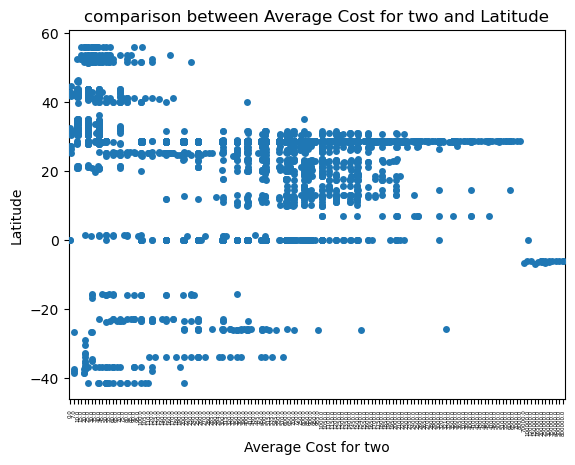

<Figure size 2800x200 with 0 Axes>

In [74]:
plt.title("comparison between Average Cost for two and Latitude")
sns.stripplot(x= "Average Cost for two", y= "Latitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

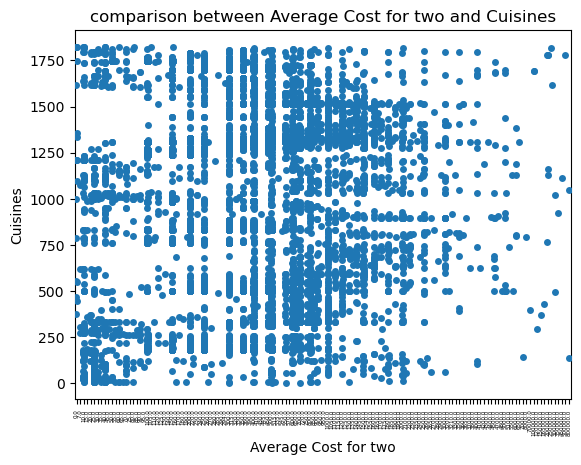

<Figure size 2800x200 with 0 Axes>

In [75]:
plt.title("comparison between Average Cost for two and Cuisines")
sns.stripplot(x= "Average Cost for two", y= "Cuisines", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

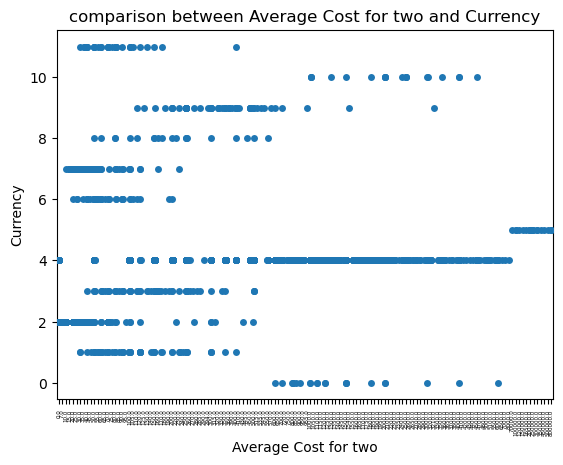

<Figure size 2800x200 with 0 Axes>

In [76]:
plt.title("comparison between Average Cost for two and Currency")
sns.stripplot(x= "Average Cost for two", y= "Currency", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

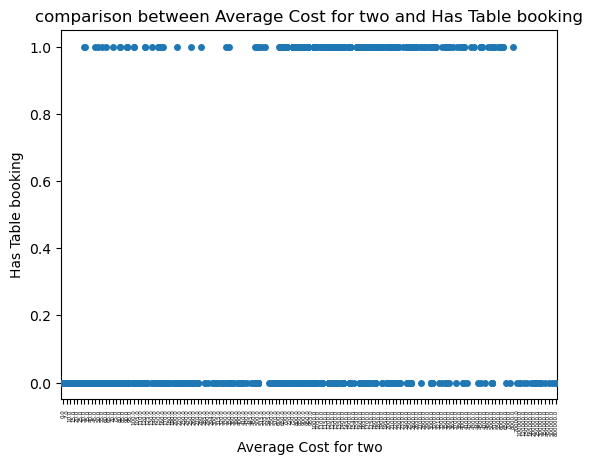

<Figure size 2800x200 with 0 Axes>

In [77]:
plt.title("comparison between Average Cost for two and Has Table booking")
sns.stripplot(x= "Average Cost for two", y= "Has Table booking", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

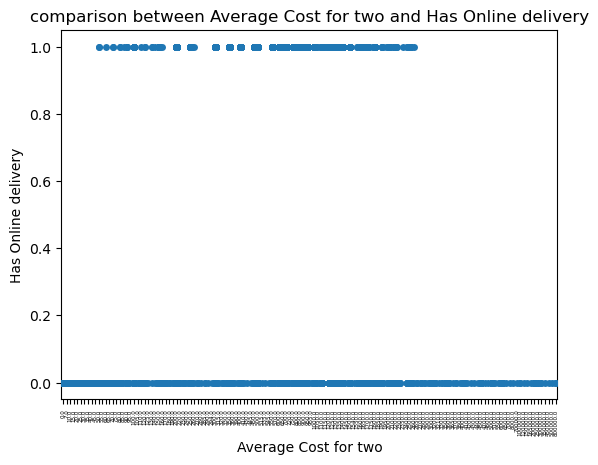

<Figure size 2800x200 with 0 Axes>

In [78]:
plt.title("comparison between Average Cost for two and Has Online delivery")
sns.stripplot(x= "Average Cost for two", y= "Has Online delivery", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

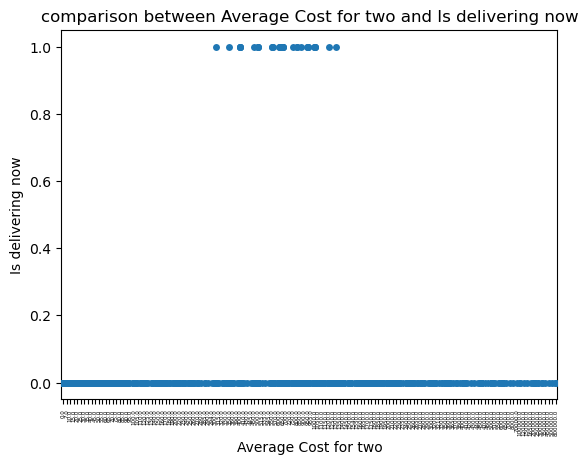

<Figure size 2800x200 with 0 Axes>

In [79]:
plt.title("comparison between Average Cost for two and Is delivering now")
sns.stripplot(x= "Average Cost for two", y= "Is delivering now", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

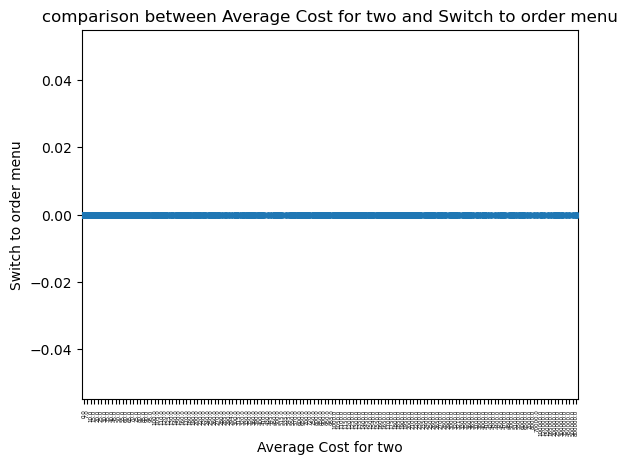

<Figure size 2800x200 with 0 Axes>

In [80]:
plt.title("comparison between Average Cost for two and Switch to order menu")
sns.stripplot(x= "Average Cost for two", y= "Switch to order menu", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

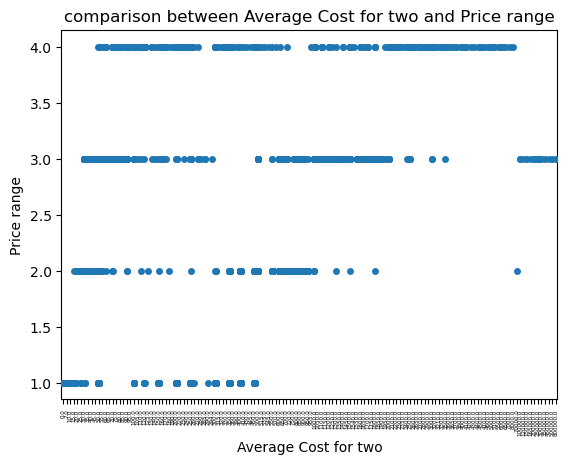

<Figure size 2800x200 with 0 Axes>

In [81]:
plt.title("comparison between Average Cost for two and Price range")
sns.stripplot(x= "Average Cost for two", y= "Price range", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

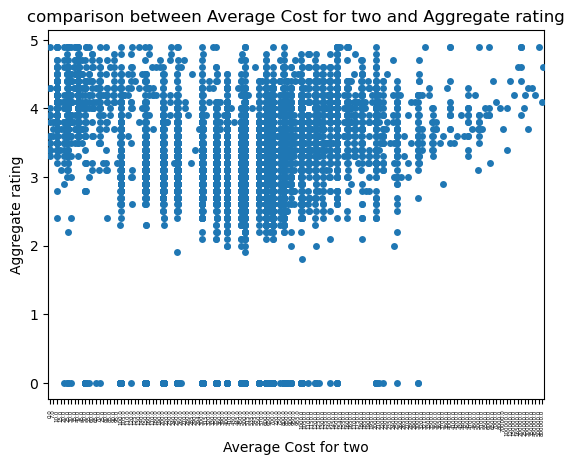

<Figure size 2800x200 with 0 Axes>

In [82]:
plt.title("comparison between Average Cost for two and Aggregate rating")
sns.stripplot(x= "Average Cost for two", y= "Aggregate rating", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

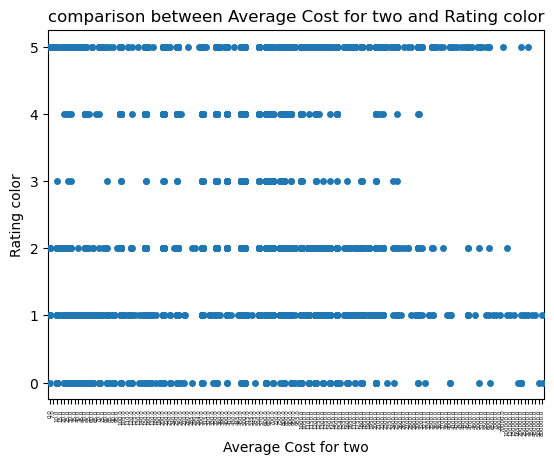

<Figure size 2800x200 with 0 Axes>

In [83]:
plt.title("comparison between Average Cost for two and Rating color")
sns.stripplot(x= "Average Cost for two", y= "Rating color", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

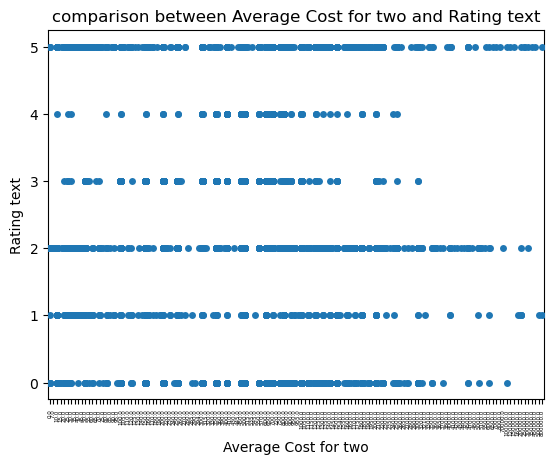

<Figure size 2800x200 with 0 Axes>

In [84]:
plt.title("comparison between Average Cost for two and Rating text")
sns.stripplot(x= "Average Cost for two", y= "Rating text", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

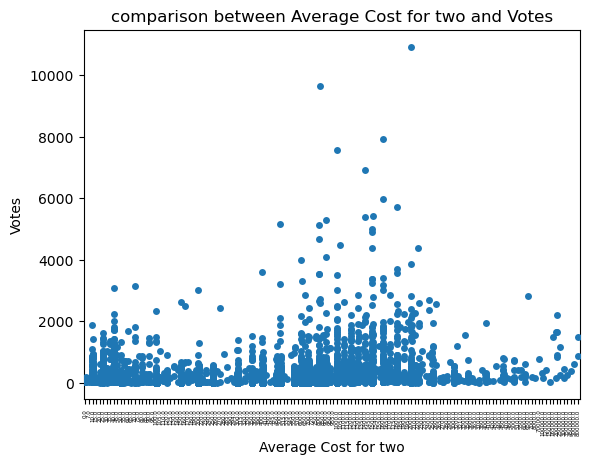

<Figure size 2800x200 with 0 Axes>

In [85]:
plt.title("comparison between Average Cost for two and Votes")
sns.stripplot(x= "Average Cost for two", y= "Votes", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

Scatterplots

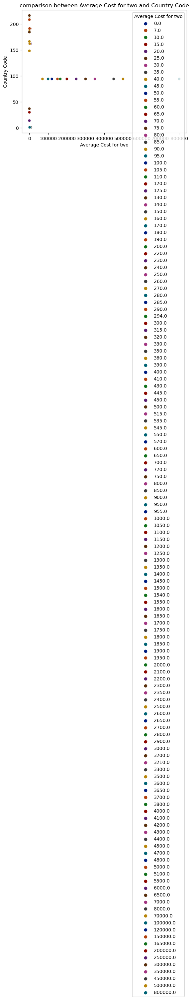

In [86]:
plt.title("comparison between Average Cost for two and Country Code")
sns.scatterplot(x= 'Average Cost for two', y= 'Country Code', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

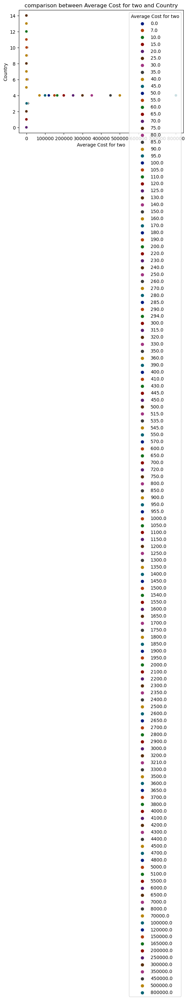

In [87]:
plt.title("comparison between Average Cost for two and Country")
sns.scatterplot(x= 'Average Cost for two', y= 'Country', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

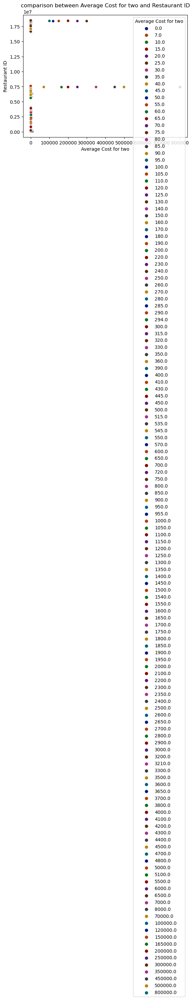

In [88]:
plt.title("comparison between Average Cost for two and Restaurant ID")
sns.scatterplot(x= 'Average Cost for two', y= 'Restaurant ID', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

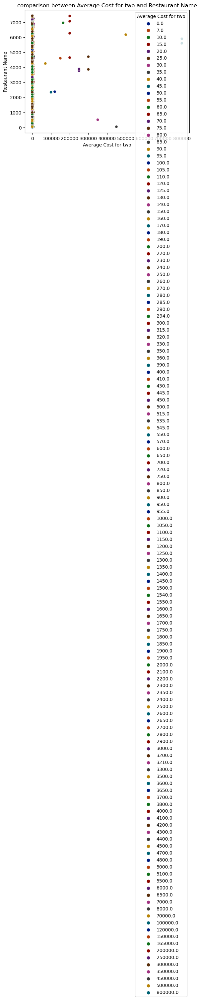

In [89]:
plt.title("comparison between Average Cost for two and Restaurant Name")
sns.scatterplot(x= 'Average Cost for two', y= 'Restaurant Name', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

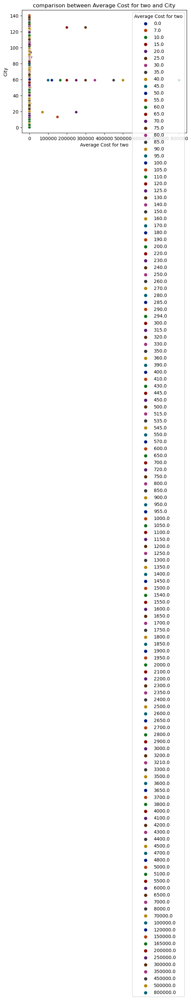

In [90]:
plt.title("comparison between Average Cost for two and City")
sns.scatterplot(x= 'Average Cost for two', y= 'City', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

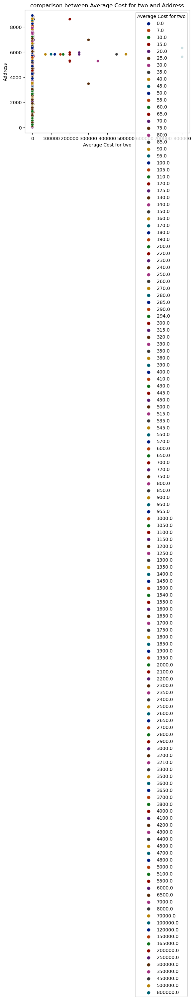

In [91]:
plt.title("comparison between Average Cost for two and Address")
sns.scatterplot(x= 'Average Cost for two', y= 'Address', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

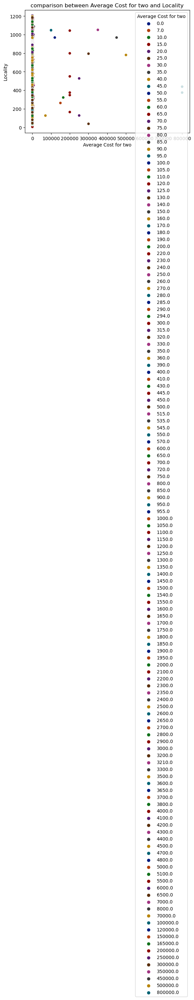

In [92]:
plt.title("comparison between Average Cost for two and Locality")
sns.scatterplot(x= 'Average Cost for two', y= 'Locality', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

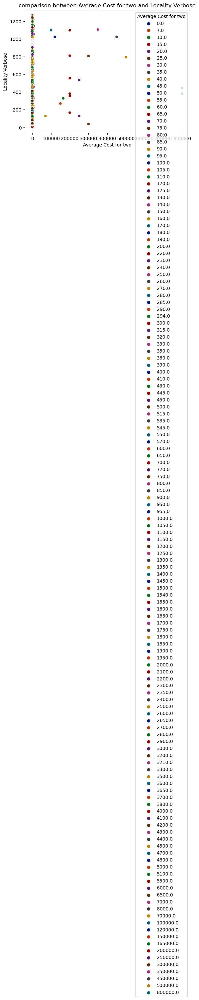

In [93]:
plt.title("comparison between Average Cost for two and Locality Verbose")
sns.scatterplot(x= 'Average Cost for two', y= 'Locality Verbose', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

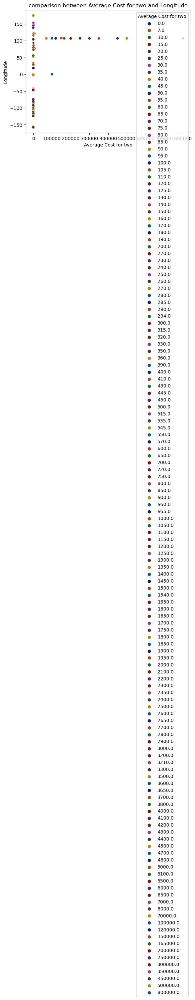

In [94]:
plt.title("comparison between Average Cost for two and Longitude")
sns.scatterplot(x= 'Average Cost for two', y= 'Longitude', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

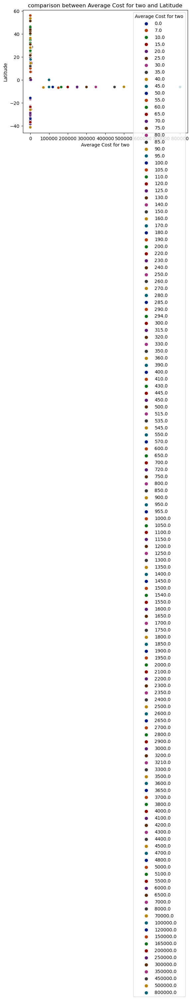

In [95]:
plt.title("comparison between Average Cost for two and Latitude")
sns.scatterplot(x= 'Average Cost for two', y= 'Latitude', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

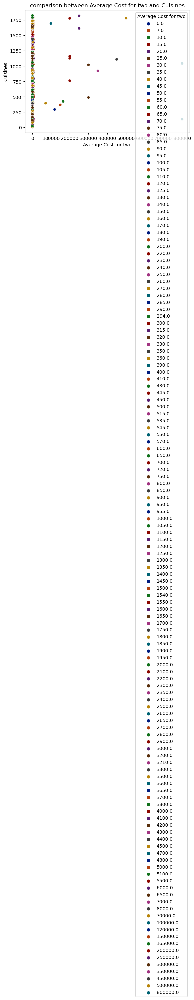

In [96]:
plt.title("comparison between Average Cost for two and Cuisines")
sns.scatterplot(x= 'Average Cost for two', y= 'Cuisines', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

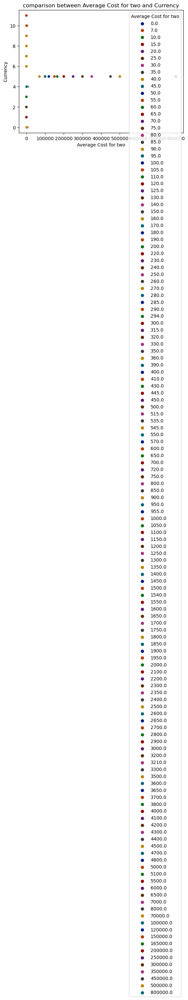

In [97]:
plt.title("comparison between Average Cost for two and Currency")
sns.scatterplot(x= 'Average Cost for two', y= 'Currency', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

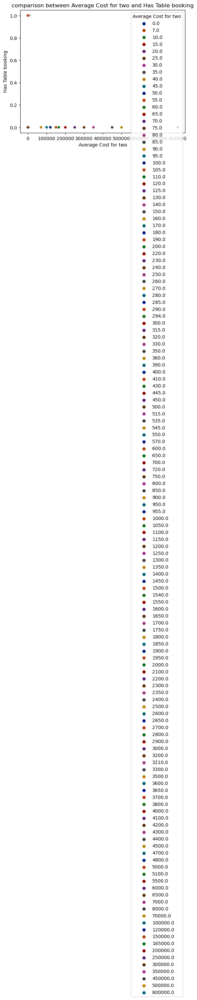

In [98]:
plt.title("comparison between Average Cost for two and Has Table booking")
sns.scatterplot(x= 'Average Cost for two', y= 'Has Table booking', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

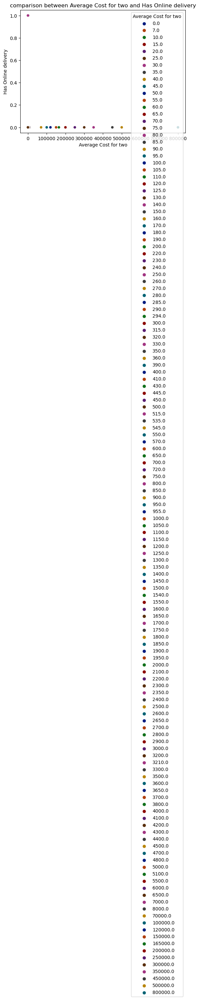

In [99]:
plt.title("comparison between Average Cost for two and Has Online delivery")
sns.scatterplot(x= 'Average Cost for two', y= 'Has Online delivery', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

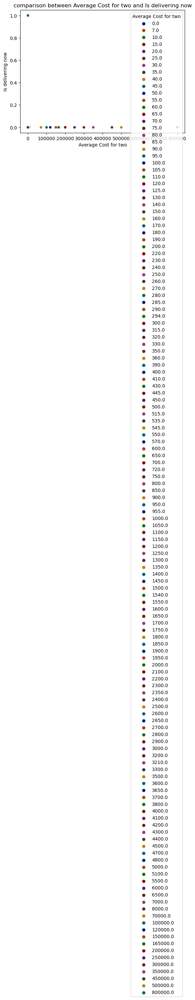

In [100]:
plt.title("comparison between Average Cost for two and Is delivering now")
sns.scatterplot(x= 'Average Cost for two', y= 'Is delivering now', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

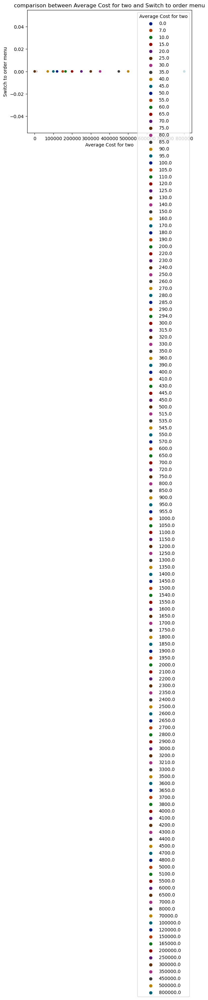

In [101]:
plt.title("comparison between Average Cost for two and Switch to order menu")
sns.scatterplot(x= 'Average Cost for two', y= 'Switch to order menu', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

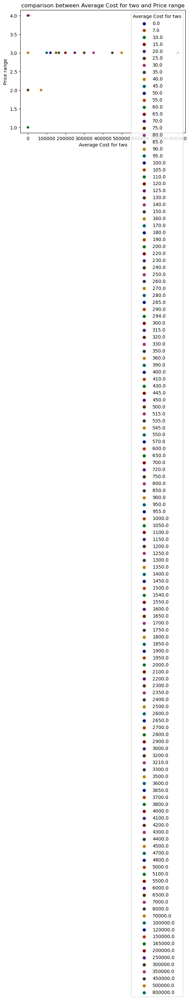

In [102]:
plt.title("comparison between Average Cost for two and Price range")
sns.scatterplot(x= 'Average Cost for two', y= 'Price range', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

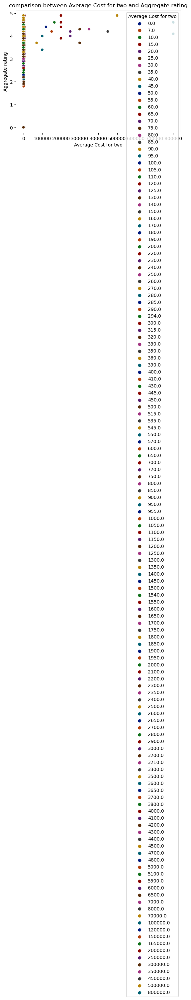

In [103]:
plt.title("comparison between Average Cost for two and Aggregate rating")
sns.scatterplot(x= 'Average Cost for two', y= 'Aggregate rating', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

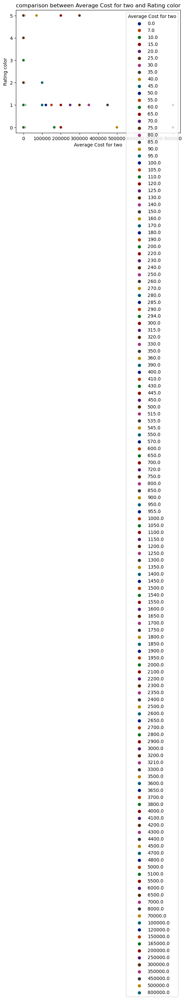

In [104]:
plt.title("comparison between Average Cost for two and Rating color")
sns.scatterplot(x= 'Average Cost for two', y= 'Rating color', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

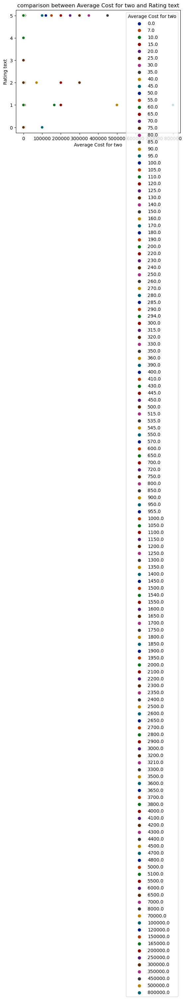

In [105]:
plt.title("comparison between Average Cost for two and Rating text")
sns.scatterplot(x= 'Average Cost for two', y= 'Rating text', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

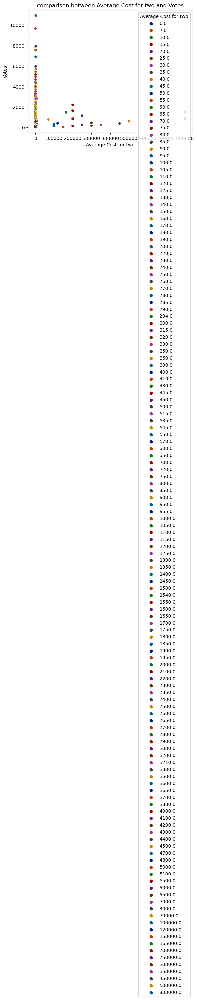

In [106]:
plt.title("comparison between Average Cost for two and Votes")
sns.scatterplot(x= 'Average Cost for two', y= 'Votes', data = zomato_data,hue='Average Cost for two', palette='dark')
plt.show()

no cocnclusive statement can be made from the above plot.

In [ ]:
Barplots

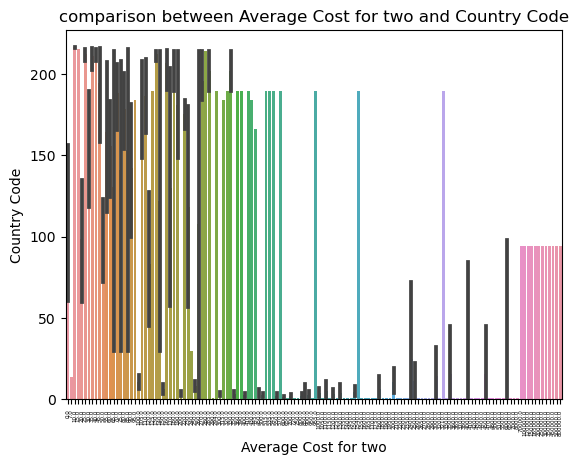

<Figure size 2800x200 with 0 Axes>

In [107]:
plt.title("comparison between Average Cost for two and Country Code")
sns.barplot(x= "Average Cost for two", y= "Country Code", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

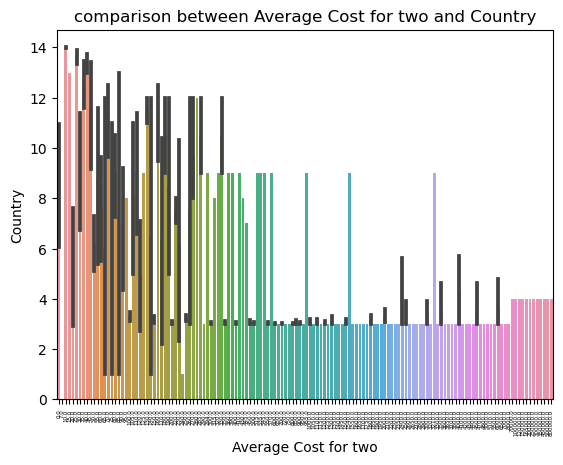

<Figure size 2800x200 with 0 Axes>

In [108]:
plt.title("comparison between Average Cost for two and Country")
sns.barplot(x= "Average Cost for two", y= "Country", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

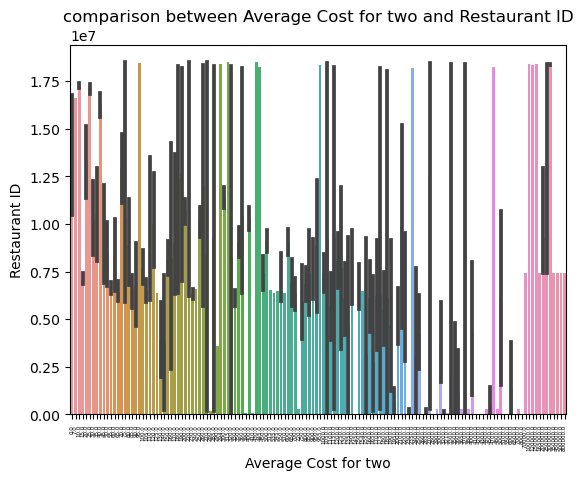

<Figure size 2800x200 with 0 Axes>

In [109]:
plt.title("comparison between Average Cost for two and Restaurant ID")
sns.barplot(x= "Average Cost for two", y= "Restaurant ID", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

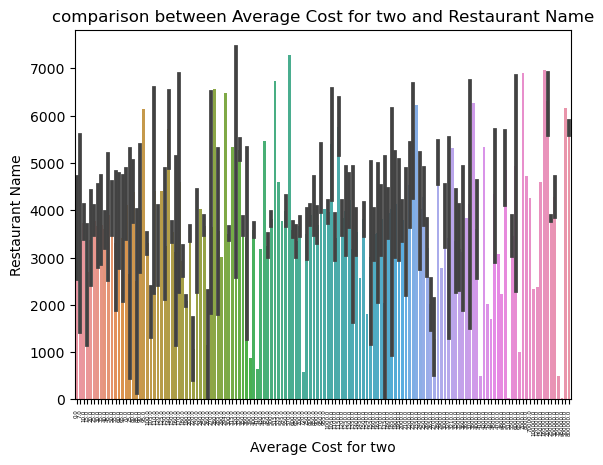

<Figure size 2800x200 with 0 Axes>

In [110]:
plt.title("comparison between Average Cost for two and Restaurant Name")
sns.barplot(x= "Average Cost for two", y= "Restaurant Name", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

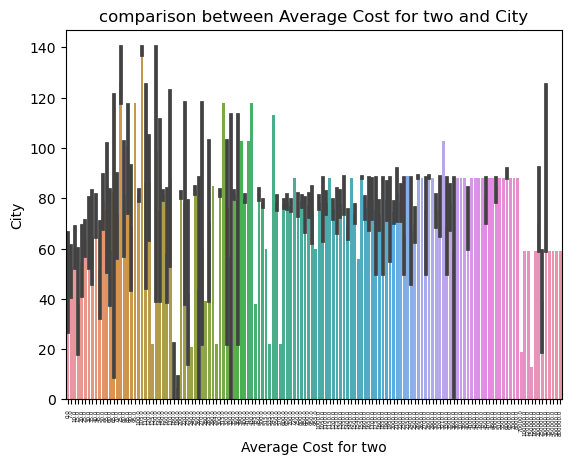

<Figure size 2800x200 with 0 Axes>

In [111]:
plt.title("comparison between Average Cost for two and City")
sns.barplot(x= "Average Cost for two", y= "City", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

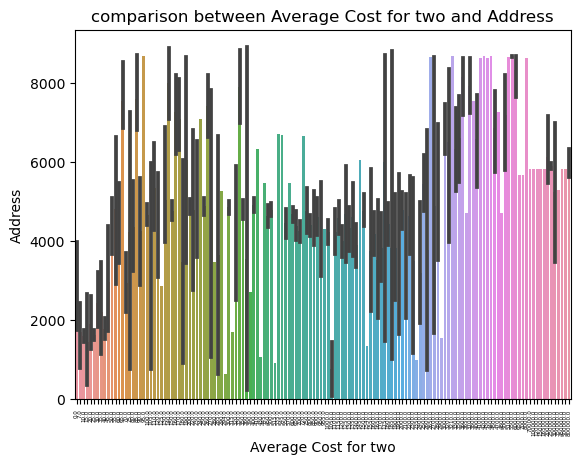

<Figure size 2800x200 with 0 Axes>

In [112]:
plt.title("comparison between Average Cost for two and Address")
sns.barplot(x= "Average Cost for two", y= "Address", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

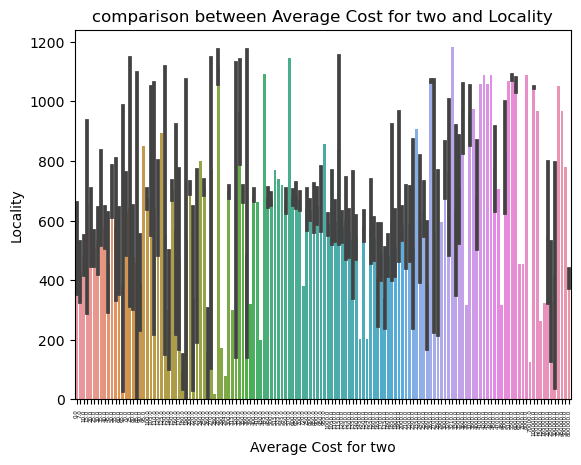

<Figure size 2800x200 with 0 Axes>

In [113]:
plt.title("comparison between Average Cost for two and Locality")
sns.barplot(x= "Average Cost for two", y= "Locality", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be made from the above plot.

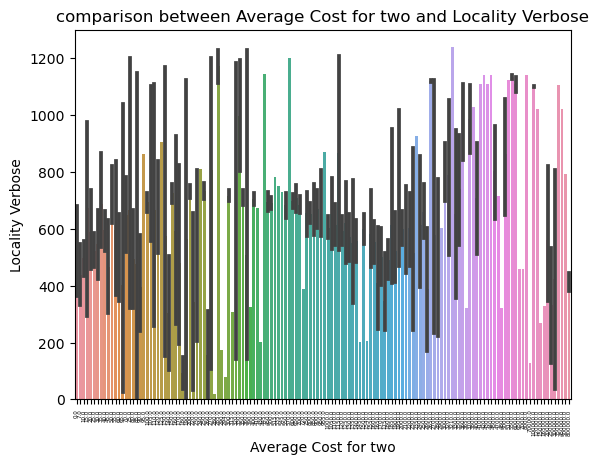

<Figure size 2800x200 with 0 Axes>

In [114]:
plt.title("comparison between Average Cost for two and Locality Verbose")
sns.barplot(x= "Average Cost for two", y= "Locality Verbose", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

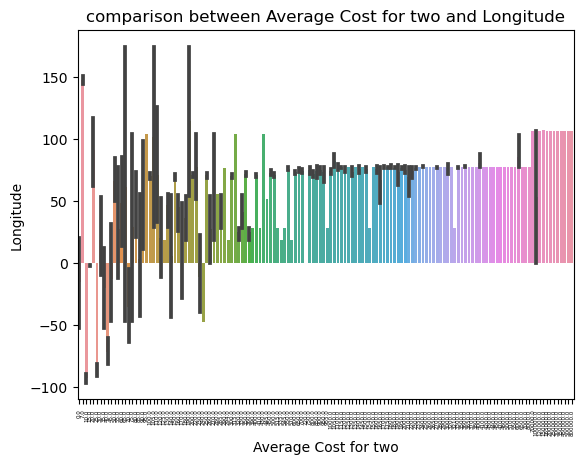

<Figure size 2800x200 with 0 Axes>

In [115]:
plt.title("comparison between Average Cost for two and Longitude")
sns.barplot(x= "Average Cost for two", y= "Longitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

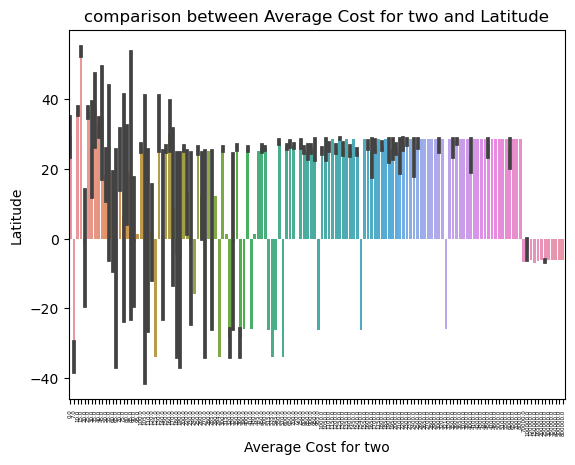

<Figure size 2800x200 with 0 Axes>

In [116]:
plt.title("comparison between Average Cost for two and Latitude")
sns.barplot(x= "Average Cost for two", y= "Latitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

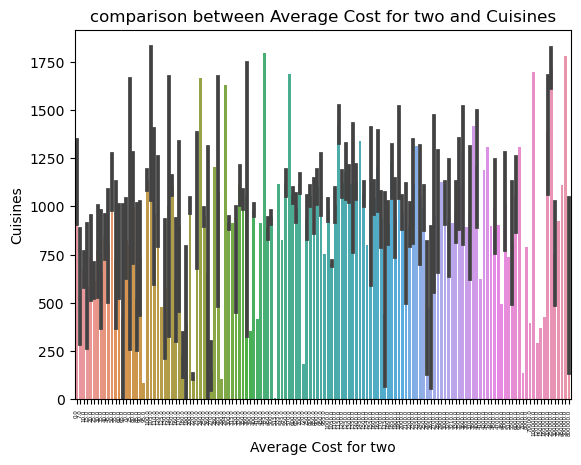

<Figure size 2800x200 with 0 Axes>

In [117]:
plt.title("comparison between Average Cost for two and Cuisines")
sns.barplot(x= "Average Cost for two", y= "Cuisines", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

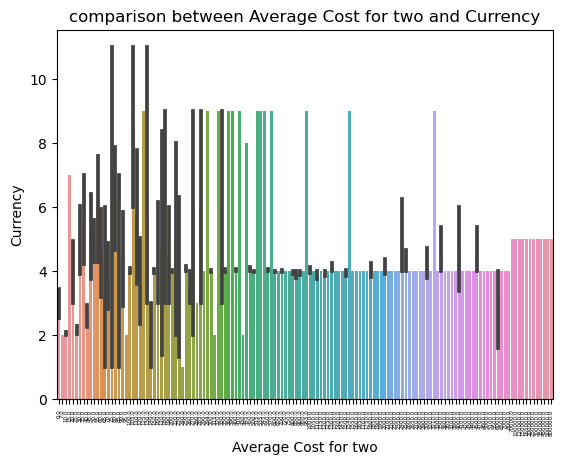

<Figure size 2800x200 with 0 Axes>

In [118]:
plt.title("comparison between Average Cost for two and Currency")
sns.barplot(x= "Average Cost for two", y= "Currency", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

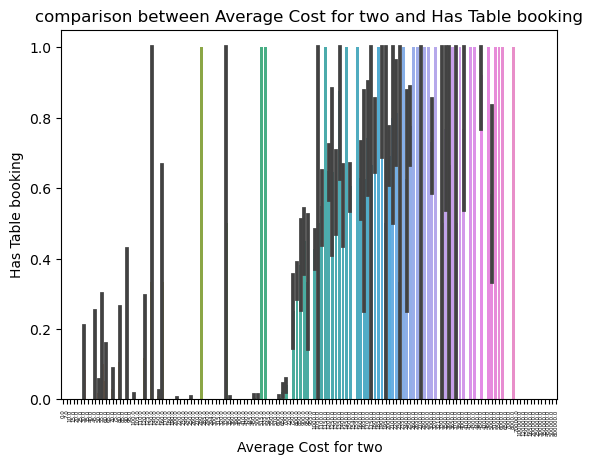

<Figure size 2800x200 with 0 Axes>

In [119]:
plt.title("comparison between Average Cost for two and Has Table booking")
sns.barplot(x= "Average Cost for two", y= "Has Table booking", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

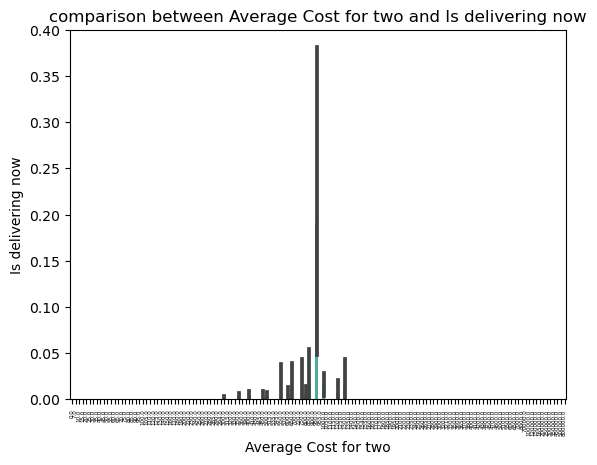

<Figure size 2800x200 with 0 Axes>

In [120]:
plt.title("comparison between Average Cost for two and Is delivering now")
sns.barplot(x= "Average Cost for two", y= "Is delivering now", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be made from the above plot.

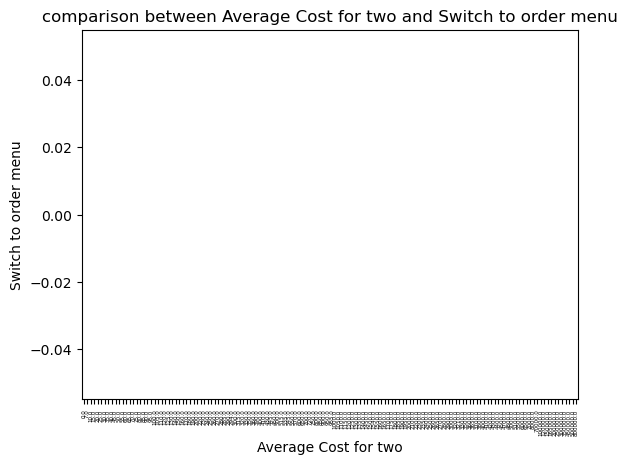

<Figure size 2800x200 with 0 Axes>

In [121]:
plt.title("comparison between Average Cost for two and Switch to order menu")
sns.barplot(x= "Average Cost for two", y= "Switch to order menu", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

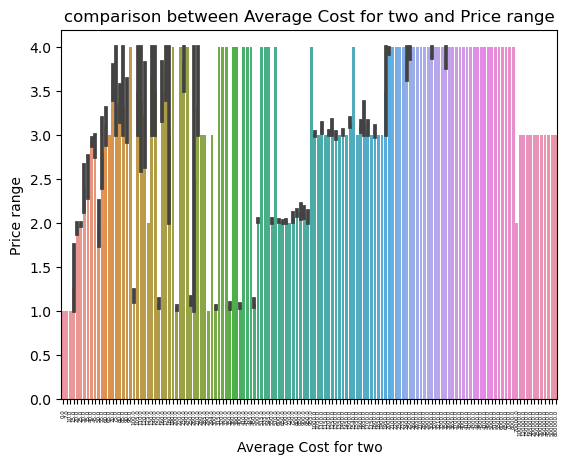

<Figure size 2800x200 with 0 Axes>

In [122]:
plt.title("comparison between Average Cost for two and Price range")
sns.barplot(x= "Average Cost for two", y= "Price range", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

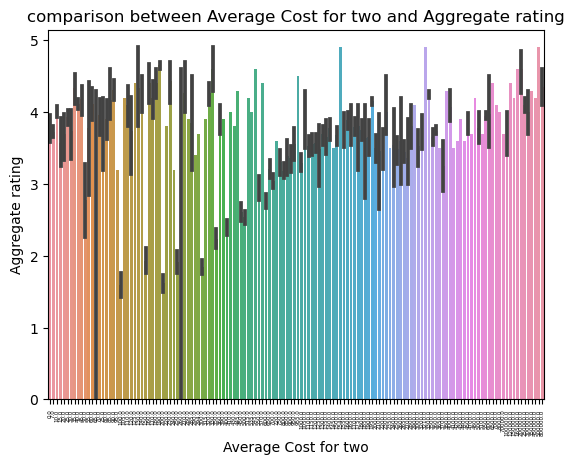

<Figure size 2800x200 with 0 Axes>

In [123]:
plt.title("comparison between Average Cost for two and Aggregate rating")
sns.barplot(x= "Average Cost for two", y= "Aggregate rating", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

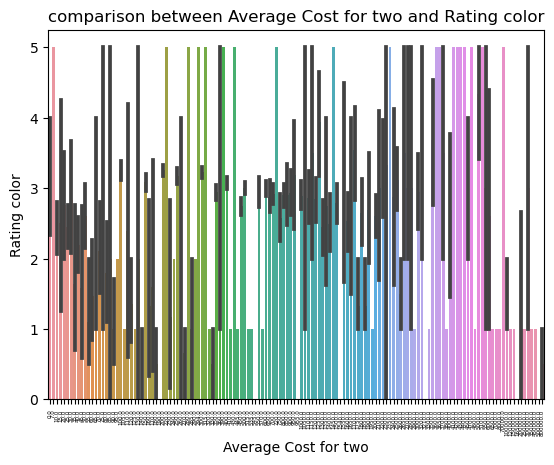

<Figure size 2800x200 with 0 Axes>

In [124]:
plt.title("comparison between Average Cost for two and Rating color")
sns.barplot(x= "Average Cost for two", y= "Rating color", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

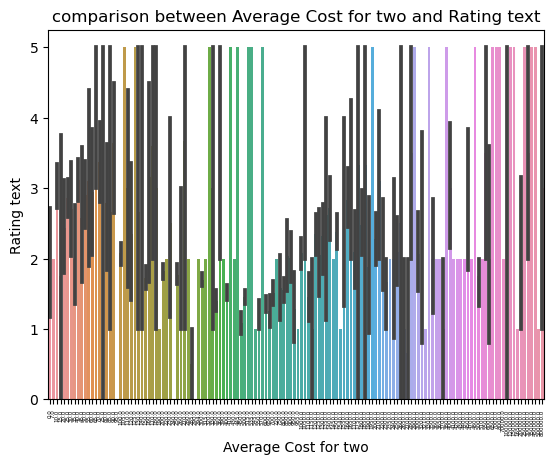

<Figure size 2800x200 with 0 Axes>

In [125]:
plt.title("comparison between Average Cost for two and Rating text")
sns.barplot(x= "Average Cost for two", y= "Rating text", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

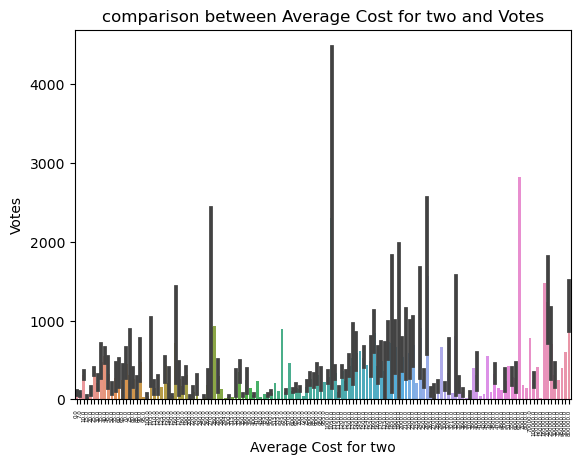

<Figure size 2800x200 with 0 Axes>

In [126]:
plt.title("comparison between Average Cost for two and Votes")
sns.barplot(x= "Average Cost for two", y= "Votes", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no cocnclusive statement can be made from the above plot.

Linear regression plots

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:447: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=figsize)


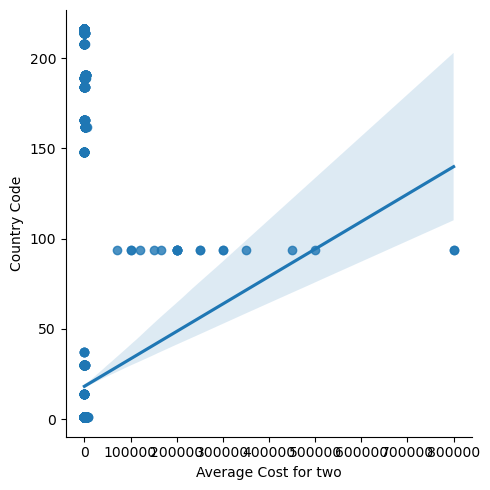

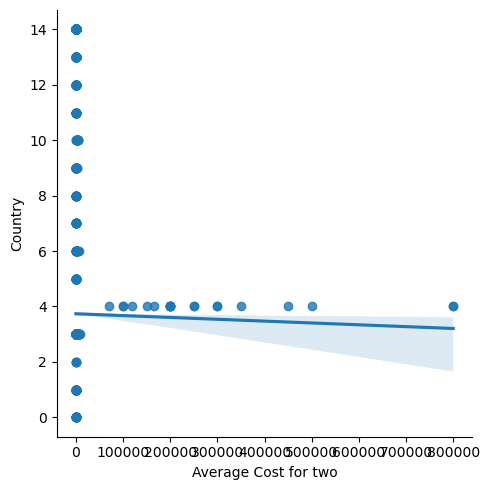

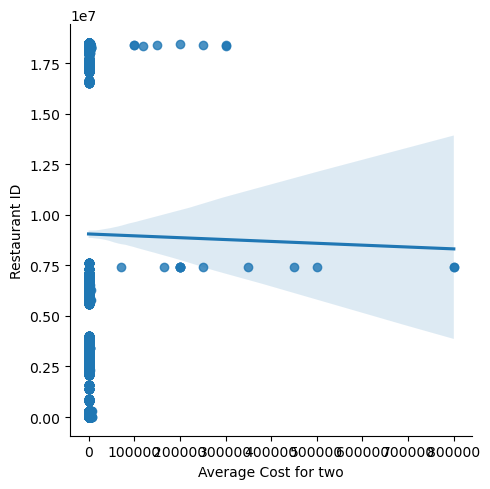

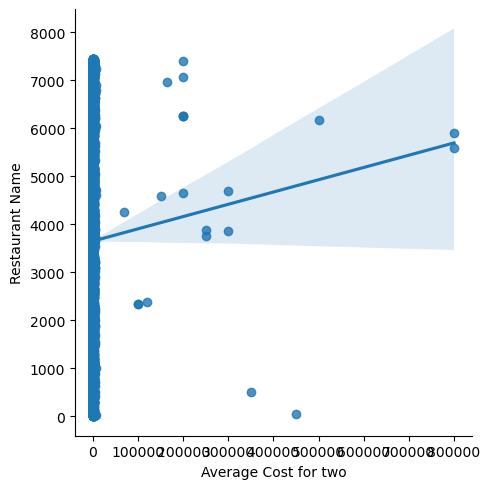

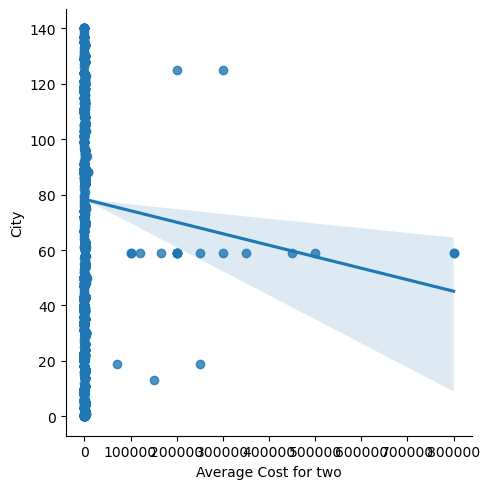

...

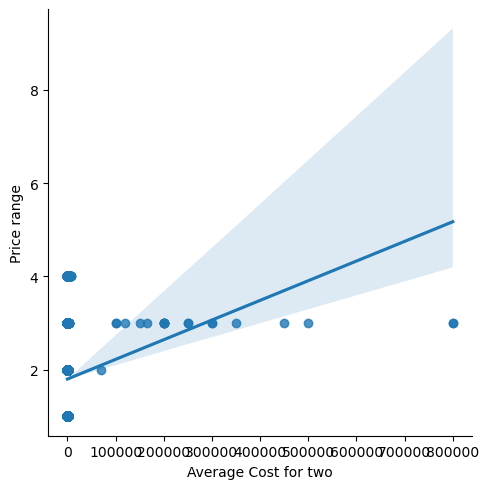

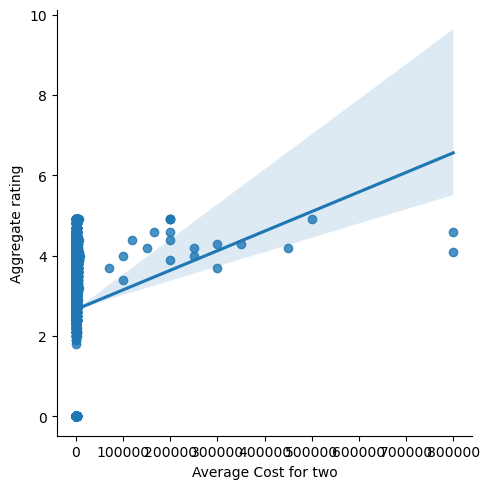

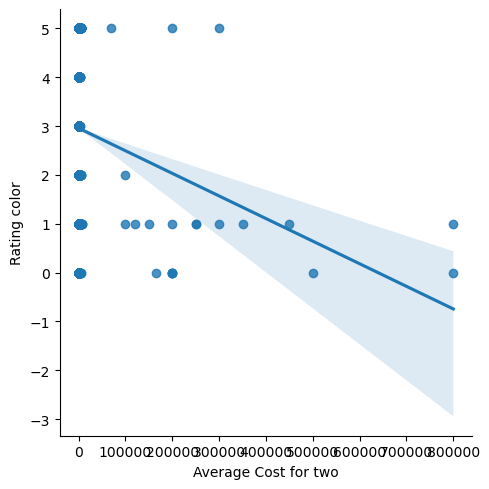

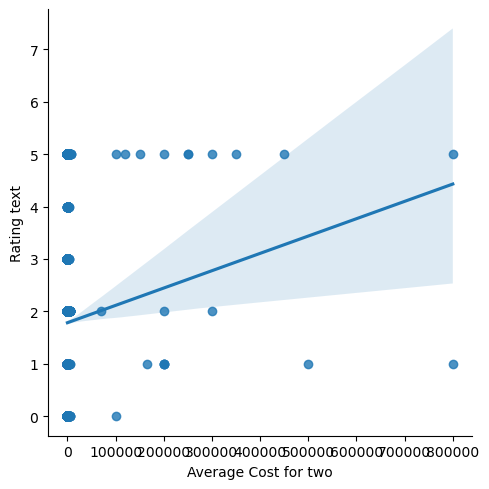

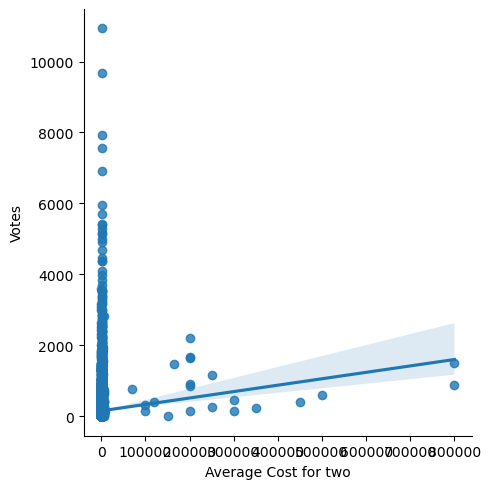

In [127]:
sns.lmplot(x='Average Cost for two', y= 'Country Code', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Country', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Restaurant ID', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Restaurant Name', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'City', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Address', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Locality', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Locality Verbose', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Longitude', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Latitude', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Cuisines', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Currency', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Has Table booking', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Has Online delivery', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Is delivering now', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Switch to order menu', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Price range', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Aggregate rating', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Rating color', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Rating text', data=zomato_data,palette='colorblind')
sns.lmplot(x='Average Cost for two', y= 'Votes', data=zomato_data,palette='colorblind')


The above plots show no or very low correlation between the output column and the input variables. 

In [ ]:
Catplots

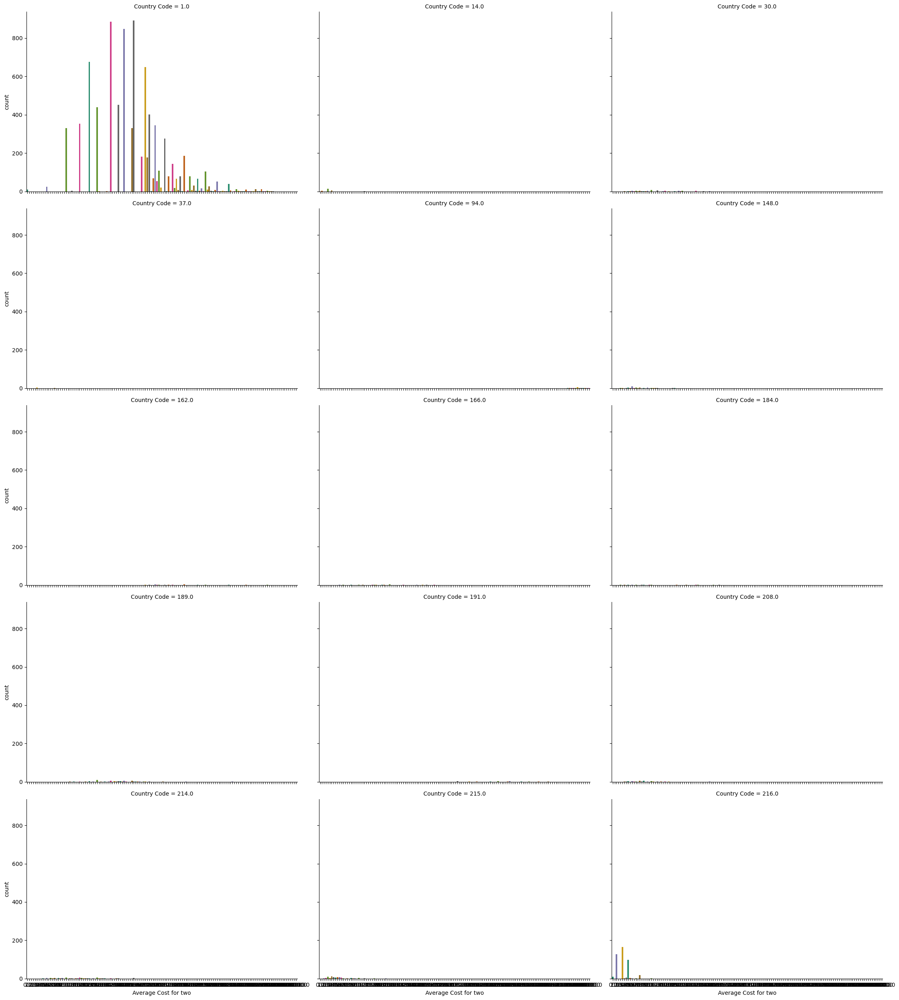

<Figure size 200x200 with 0 Axes>

In [128]:
sns.catplot(x= 'Average Cost for two', col= 'Country Code', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

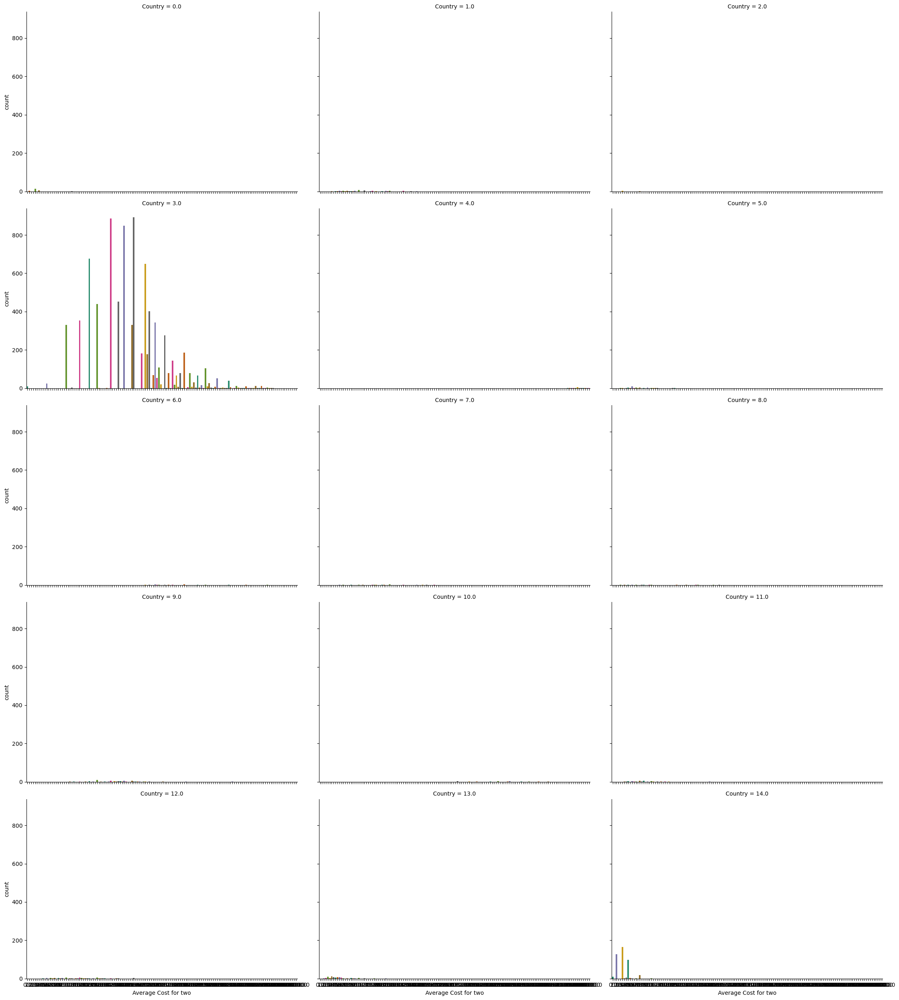

<Figure size 200x200 with 0 Axes>

In [129]:
sns.catplot(x= 'Average Cost for two', col= 'Country', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

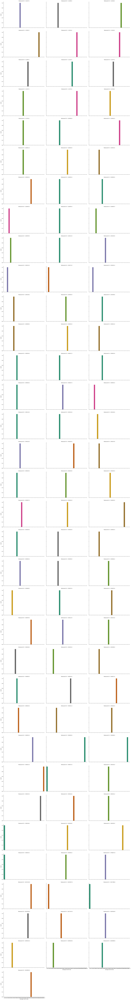

<Figure size 200x200 with 0 Axes>

In [131]:
sns.catplot(x= 'Average Cost for two', col= 'Restaurant ID', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

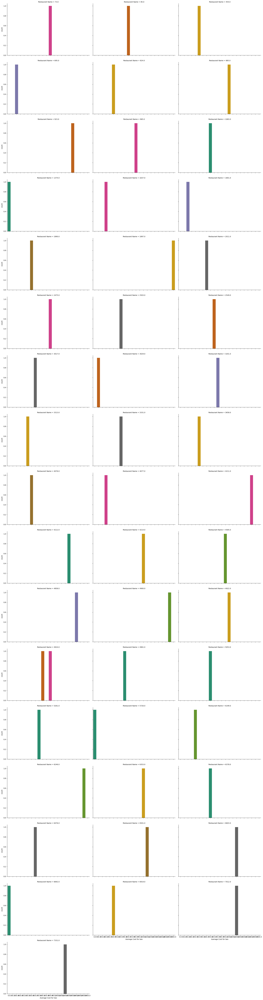

<Figure size 200x200 with 0 Axes>

In [134]:
sns.catplot(x= 'Average Cost for two', col= 'Restaurant Name', data = zomato_data.head(50), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

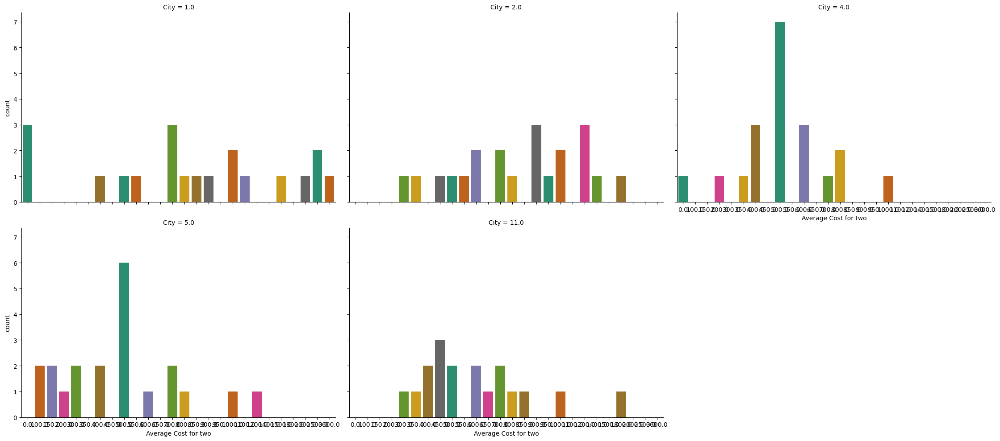

<Figure size 200x200 with 0 Axes>

In [135]:
sns.catplot(x= 'Average Cost for two', col= 'City', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

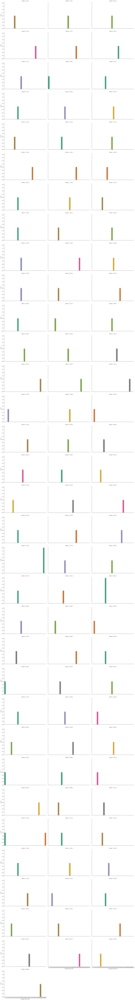

<Figure size 200x200 with 0 Axes>

In [136]:
sns.catplot(x= 'Average Cost for two', col= 'Address', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

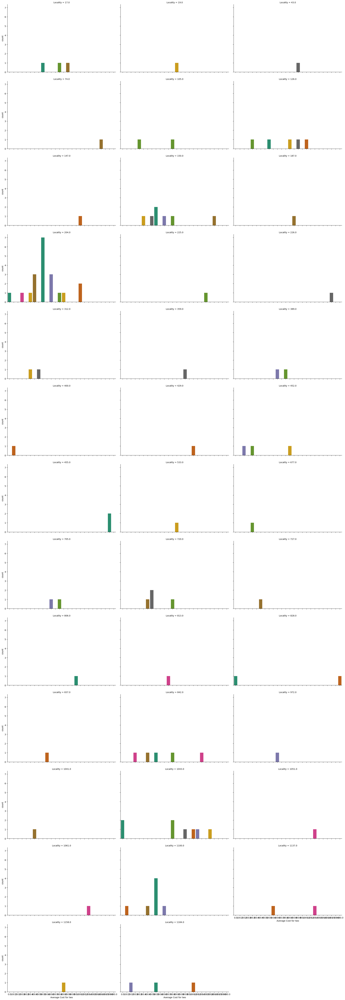

<Figure size 200x200 with 0 Axes>

In [137]:
sns.catplot(x= 'Average Cost for two', col= 'Locality', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

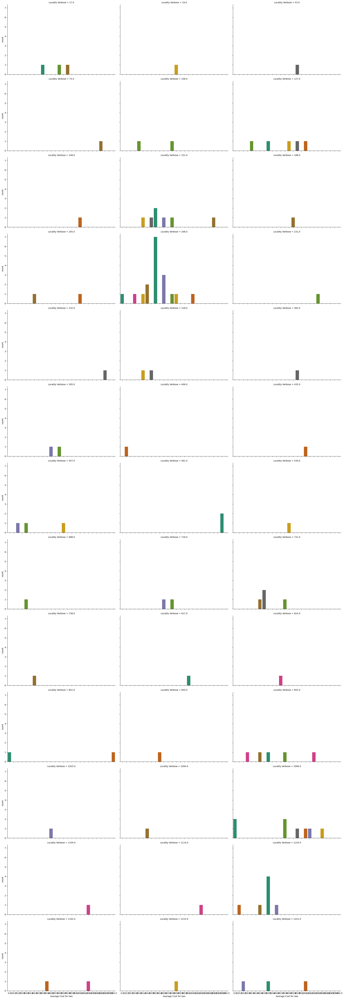

<Figure size 200x200 with 0 Axes>

In [138]:
sns.catplot(x= 'Average Cost for two', col= 'Locality Verbose', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

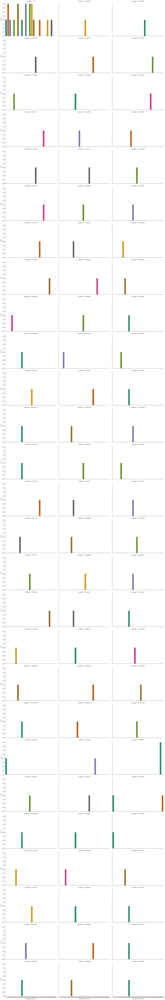

<Figure size 200x200 with 0 Axes>

In [139]:
sns.catplot(x= 'Average Cost for two', col= 'Longitude', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

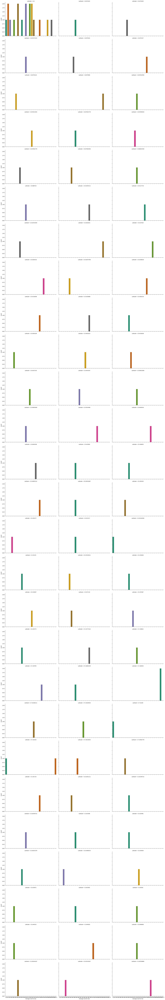

<Figure size 200x200 with 0 Axes>

In [140]:
sns.catplot(x= 'Average Cost for two', col= 'Latitude', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plots

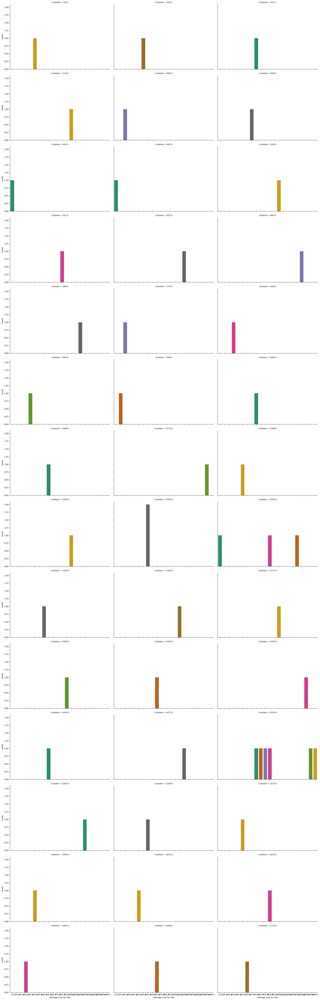

<Figure size 200x200 with 0 Axes>

In [142]:
sns.catplot(x= 'Average Cost for two', col= 'Cuisines', data = zomato_data.head(50), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot

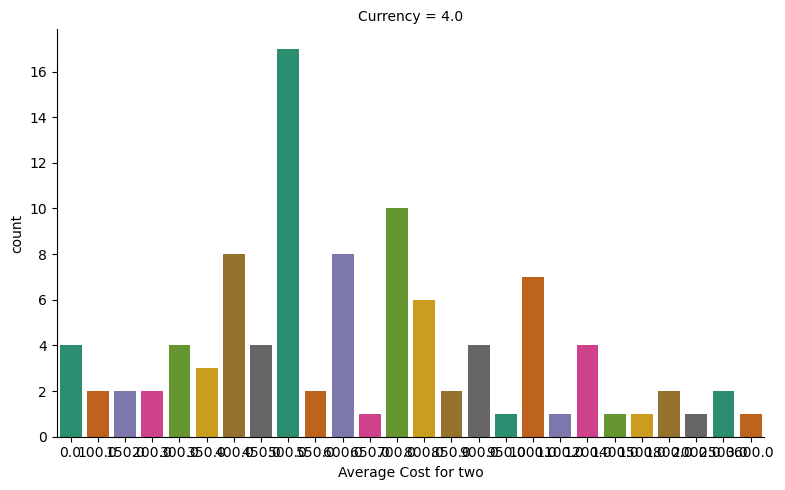

<Figure size 200x200 with 0 Axes>

In [143]:
sns.catplot(x= 'Average Cost for two', col= 'Currency', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot other currency 500 being the most paid fees.

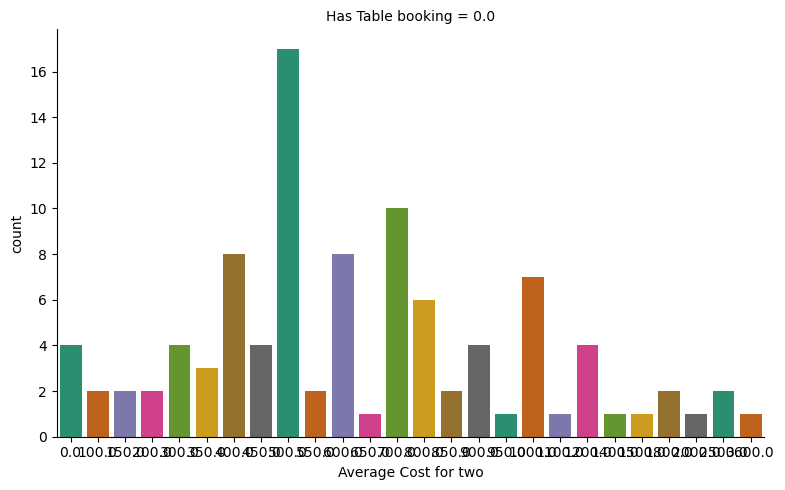

<Figure size 200x200 with 0 Axes>

In [144]:
sns.catplot(x= 'Average Cost for two', col= 'Has Table booking', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot other than currency 500 being the most paid for table for two.

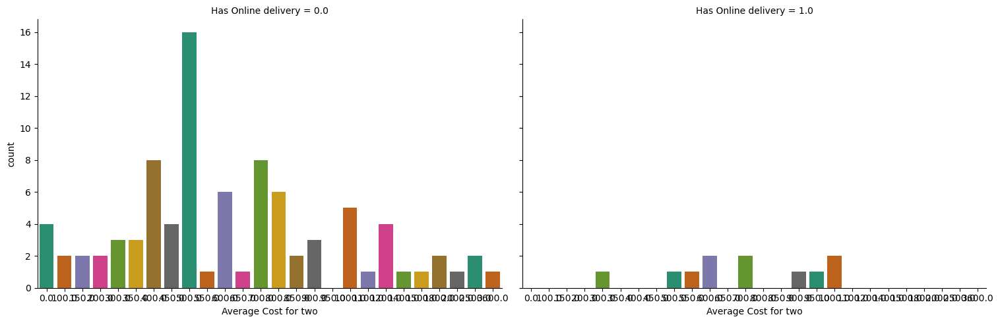

<Figure size 200x200 with 0 Axes>

In [145]:
sns.catplot(x= 'Average Cost for two', col= 'Has Online delivery', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot other than 500 being the most paid when their no online delivery

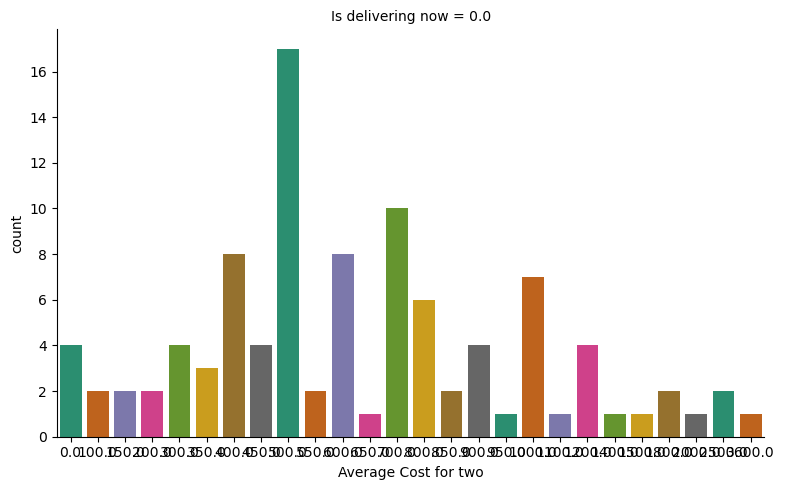

<Figure size 200x200 with 0 Axes>

In [146]:
sns.catplot(x= 'Average Cost for two', col= 'Is delivering now', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot other than 500 being the most paid when it is delivering now.

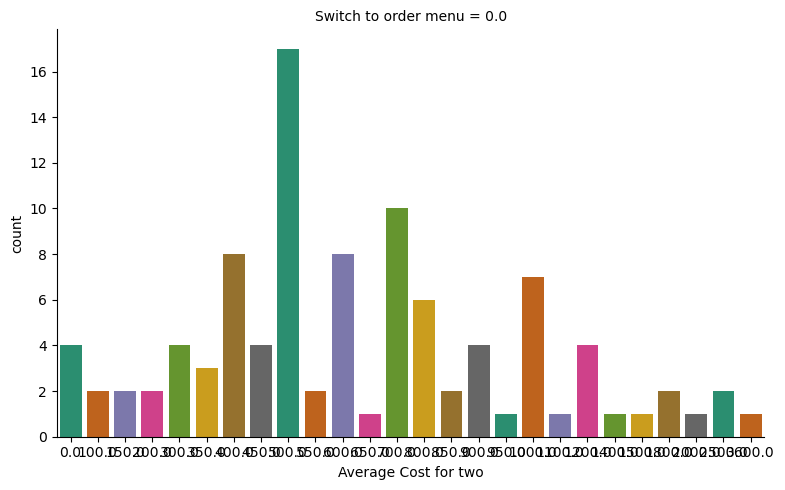

<Figure size 200x200 with 0 Axes>

In [147]:
sns.catplot(x= 'Average Cost for two', col= 'Switch to order menu', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot other than 500 being the most paid when they switch to order menu.

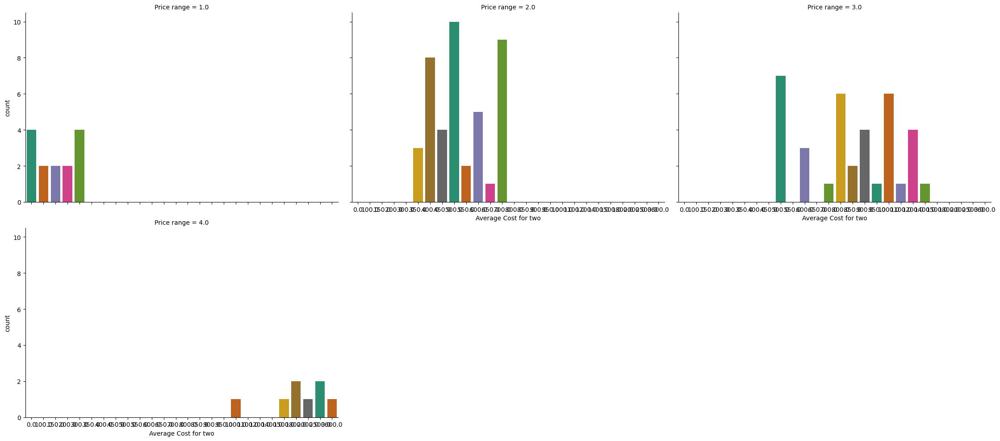

<Figure size 200x200 with 0 Axes>

In [148]:
sns.catplot(x= 'Average Cost for two', col= 'Price range', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

price range 2.0 has the most number of average cost for two.

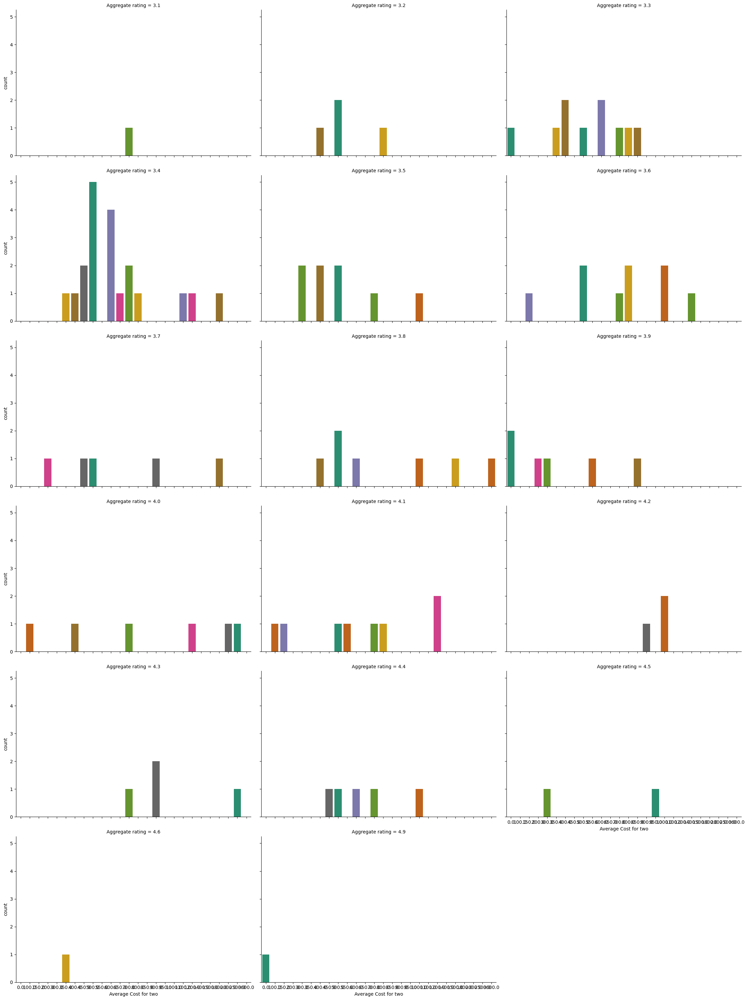

<Figure size 200x200 with 0 Axes>

In [149]:
sns.catplot(x= 'Average Cost for two', col= 'Aggregate rating', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

Aggregate rating 3.4 has the highest number of average cost for two numbers.

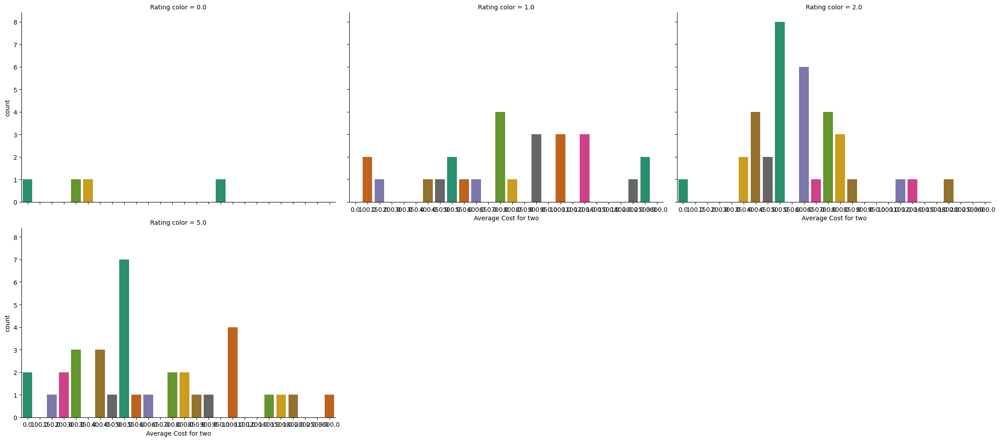

<Figure size 200x200 with 0 Axes>

In [150]:
sns.catplot(x= 'Average Cost for two', col= 'Rating color', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

rating color 2.0 has the highest number of average cost for two 

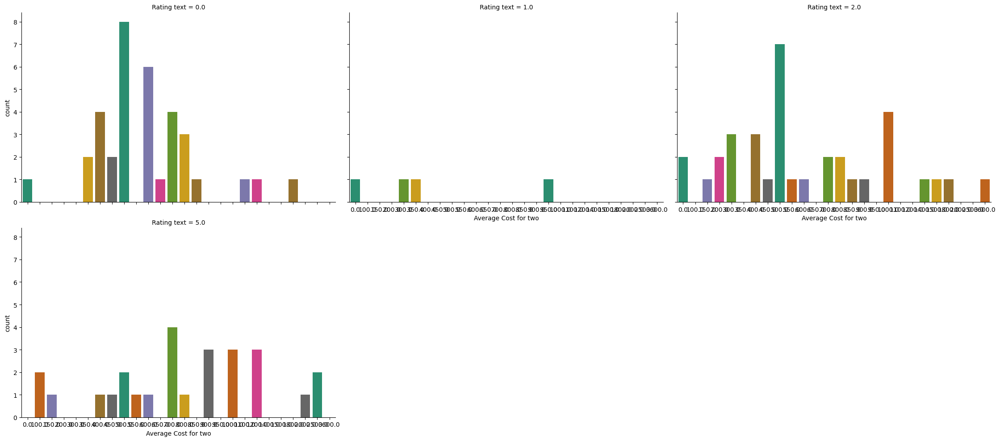

<Figure size 200x200 with 0 Axes>

In [151]:
sns.catplot(x= 'Average Cost for two', col= 'Rating text', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

rating text 0.0 has the highest number of average cost for two values.

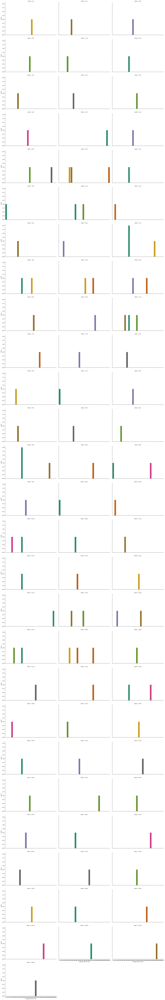

<Figure size 200x200 with 0 Axes>

In [152]:
sns.catplot(x= 'Average Cost for two', col= 'Votes', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

In [ ]:
no conclusive statement can be derived from the above plot.

Multivariate analysis

Pairplots

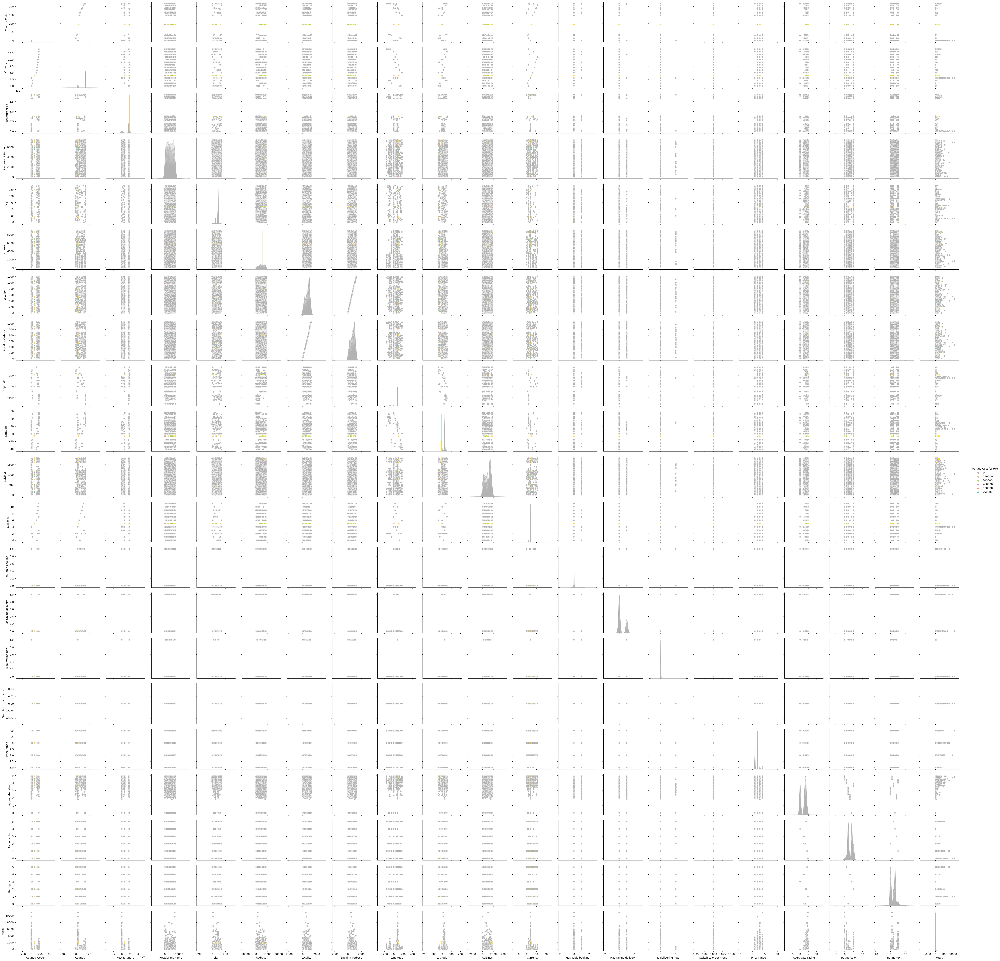

In [10]:
sns.pairplot(zomato_data,hue='Average Cost for two',palette="Set2_r")
plt.show()

Locality and locality verbose are positively correlated to each other
There are no other correlations to different variables in the dataframe.

Boxplots

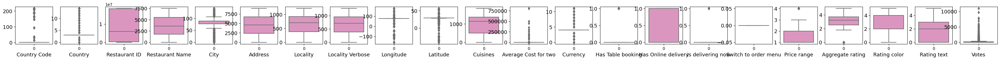

In [11]:
plt.figure(figsize=(45,45),facecolor = "white")
plotnumber=1
for col in zomato_data:
    if plotnumber<=23:
        wc=plt.subplot(22,22,plotnumber)
        sns.boxplot(zomato_data[col],palette="Set2_r")
        plt.xlabel(col,rotation=0,fontsize = 13)
        plt.yticks(rotation = 0, fontsize = 13)
    plotnumber+=1
plt.show()

Below are the findings from the above plots-
1) Country code, country, city, longitude, latitude, average cost for two, currency, has table booking, is delivering now,price range and votes have outliers above the 75 th percentile of all its values in its column.
2) Country, city,longitude, latitude,currency, and aggregate rating have outliers below 25th percentile from all of their columns. 

Skewness

In [175]:
zomato_data.skew()

Country Code             3.043965
Country                  3.312721
Restaurant ID            0.061570
Restaurant Name          0.044637
City                    -1.193777
Address                 -0.040407
Locality                -0.253554
Locality Verbose        -0.183064
Longitude               -2.807328
Latitude                -3.081635
Cuisines                -0.305484
Average Cost for two    35.477915
Currency                 2.858093
Has Table booking        2.321100
Has Online delivery      1.114620
Is delivering now       16.673412
Switch to order menu     0.000000
Price range              0.889618
Aggregate rating        -0.954130
Rating color             0.046009
Rating text              0.431408
Votes                    8.807637
dtype: float64

lets correct the skewness for three variables and check the skewness again-Average Cost for two,Is delivering now and Votes.

In [176]:
zomato_data['Average Cost for two']=np.cbrt(zomato_data['Average Cost for two'])
zomato_data['Is delivering now']=np.cbrt(zomato_data['Is delivering now'])
zomato_data['Votes']=np.cbrt(zomato_data['Votes'])

In [177]:
zomato_data.skew()

Country Code             3.043965
Country                  3.312721
Restaurant ID            0.061570
Restaurant Name          0.044637
City                    -1.193777
Address                 -0.040407
Locality                -0.253554
Locality Verbose        -0.183064
Longitude               -2.807328
Latitude                -3.081635
Cuisines                -0.305484
Average Cost for two     9.626632
Currency                 2.858093
Has Table booking        2.321100
Has Online delivery      1.114620
Is delivering now       16.673412
Switch to order menu     0.000000
Price range              0.889618
Aggregate rating        -0.954130
Rating color             0.046009
Rating text              0.431408
Votes                    1.204920
dtype: float64

The skewness has been corrected.

Distribution plot- output column

C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_7228\2876926636.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(zomato_data['Average Cost for two'],color="b", kde_kws={"shade":True}, hist=False)
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\distributions.py:2511: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  kdeplot(**{axis: a}, ax=ax, color=kde_color, **kde_kws)


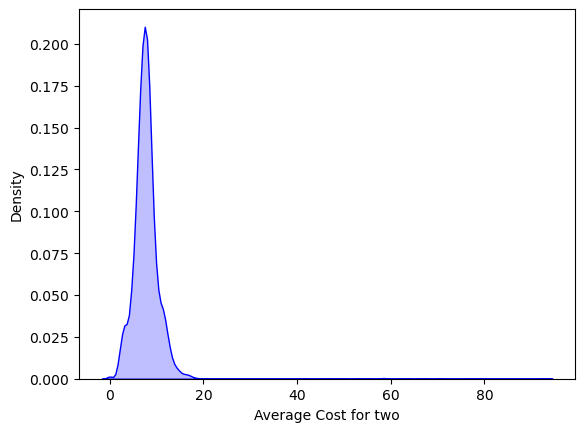

In [15]:
sns.distplot(zomato_data['Average Cost for two'],color="b", kde_kws={"shade":True}, hist=False)
plt.show()

the output column average cost for two has been skewed to the left.

lets convert the values into float64 values using ordinal encoding method.

In [10]:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in zomato_data.columns:
    if zomato_data[i].dtypes=='int64':
         zomato_data[i]=OE.fit_transform(zomato_data[i].values.reshape(-1,1))
zomato_data

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1.0,3.0,3400025.0,3201.0,1.0,4553.0,17.0,17.0,78.011544,27.161661,...,4.0,0.0,0.0,0.0,0.0,3.0,3.9,5.0,2.0,5.192494
1,1.0,3.0,3400341.0,5261.0,1.0,4605.0,17.0,17.0,0.000000,0.000000,...,4.0,0.0,0.0,0.0,0.0,2.0,3.5,5.0,2.0,4.140818
2,1.0,3.0,3400005.0,6919.0,1.0,6234.0,17.0,17.0,78.011608,27.160832,...,4.0,0.0,0.0,0.0,0.0,2.0,3.6,5.0,2.0,4.546836
3,1.0,3.0,3400021.0,1637.0,1.0,100.0,204.0,205.0,77.998092,27.195928,...,4.0,0.0,0.0,0.0,0.0,2.0,4.0,1.0,5.0,4.431048
4,1.0,3.0,3400017.0,4922.0,1.0,1316.0,204.0,205.0,78.007553,27.201725,...,4.0,0.0,0.0,0.0,0.0,3.0,4.2,1.0,5.0,5.614672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,14.0,17697389.0,6794.0,135.0,1279.0,1174.0,1231.0,-92.335523,42.498400,...,2.0,0.0,0.0,0.0,0.0,1.0,3.7,5.0,2.0,4.657010
9547,216.0,14.0,17697424.0,6839.0,135.0,2667.0,1174.0,1231.0,-92.335769,42.497919,...,2.0,0.0,0.0,0.0,0.0,1.0,3.5,5.0,2.0,3.870877
9548,216.0,14.0,17697332.0,6945.0,135.0,957.0,1174.0,1231.0,-92.323400,42.465580,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,5.383213
9549,216.0,14.0,17694056.0,6883.0,136.0,1910.0,1176.0,1233.0,-80.529488,40.396043,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,5.383213


Correlation

In [180]:
correlation = zomato_data.corr()
correlation

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
Country Code,1.000000,0.968700,0.148471,0.020012,-0.181728,-0.220342,-0.120075,-0.117543,-0.698299,0.019792,...,-0.033466,-0.061682,-0.154605,-0.018291,NaN,0.243327,0.282189,-0.187174,0.222685,0.308535
Country,0.968700,1.000000,0.161763,0.017560,-0.180959,-0.235815,-0.118784,-0.116406,-0.766221,0.181299,...,-0.105296,-0.062076,-0.140464,-0.016607,NaN,0.178035,0.255591,-0.155486,0.203846,0.299344
Restaurant ID,0.148471,0.161763,1.000000,0.003999,-0.005844,0.080615,0.069511,0.070102,-0.226081,-0.052081,...,-0.121472,-0.110071,-0.085089,0.012548,NaN,-0.134540,-0.326212,0.130540,0.251114,-0.328241
Restaurant Name,0.020012,0.017560,0.003999,1.000000,-0.001399,0.000763,0.004322,0.004281,-0.001920,0.009922,...,0.009669,0.041173,0.028082,0.011984,NaN,0.061275,0.029367,-0.007311,0.012131,0.035905
City,-0.181728,-0.180959,-0.005844,-0.001399,1.000000,-0.019763,0.096444,0.093142,0.117391,-0.004301,...,-0.071996,-0.003762,0.012723,-0.014039,NaN,-0.105759,-0.132163,0.110887,-0.098985,-0.125856
Address,-0.220342,-0.235815,0.080615,0.000763,-0.019763,1.000000,0.159555,0.160495,0.185801,-0.038654,...,0.069499,0.006428,0.029874,0.031267,NaN,-0.034952,-0.151153,0.071264,-0.008029,-0.178531
Locality,-0.120075,-0.118784,0.069511,0.004322,0.096444,0.159555,1.000000,0.999465,0.086448,-0.020424,...,0.023723,-0.065594,-0.030993,-0.007299,NaN,-0.114459,-0.174336,0.036831,-0.036969,-0.202118
Locality Verbose,-0.117543,-0.116406,0.070102,0.004281,0.093142,0.160495,0.999465,1.000000,0.084342,-0.020905,...,0.022966,-0.065132,-0.031766,-0.007353,NaN,-0.112313,-0.173254,0.037104,-0.035430,-0.200445
Longitude,-0.698299,-0.766221,-0.226081,-0.001920,0.117391,0.185801,0.086448,0.084342,1.000000,0.043207,...,0.337334,0.100488,0.178757,0.018787,NaN,-0.078939,-0.116818,0.059979,-0.181466,-0.147268
Latitude,0.019792,0.181299,-0.052081,0.009922,-0.004301,-0.038654,-0.020424,-0.020905,0.043207,1.000000,...,-0.101864,0.054658,0.118722,0.015001,NaN,-0.166688,0.000516,0.042590,-0.129447,0.005973


lets visualise it using the heatmap

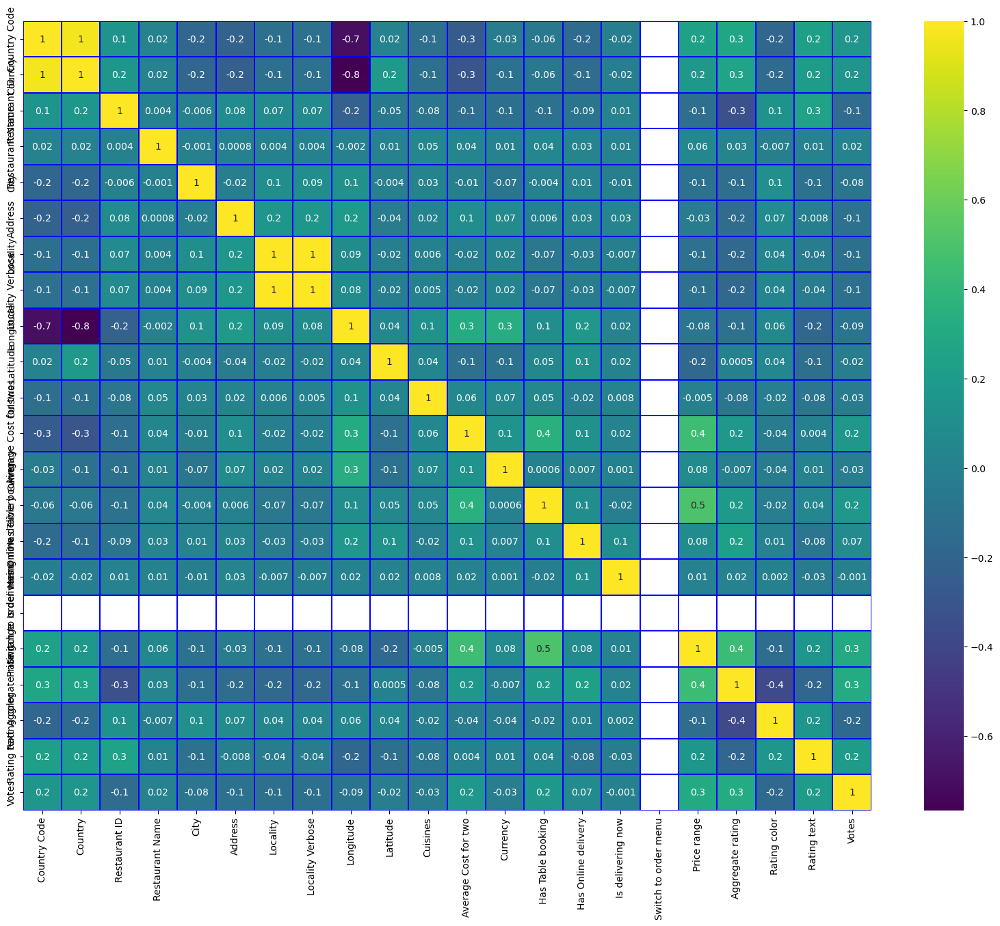

In [18]:
plt.figure(figsize = (20,15))
sns.heatmap(zomato_data.corr(), linewidths = 0.1, fmt = ".1g", linecolor= "blue", annot=True, cmap= "viridis")
plt.yticks(rotation=90);
plt.show()

Below are the findings from the above table-
1) longitude and latitude are positively correlated to country code and country.
2) has table booking and price range are positively correlated to each other.

Correlations sorted by average cost for two.

In [19]:
correlation['Average Cost for two'].sort_values(ascending = False)

Average Cost for two    1.000000
Price range             0.449487
Has Table booking       0.354593
Longitude               0.316831
Votes                   0.170341
Aggregate rating        0.169649
Currency                0.138611
Has Online delivery     0.121491
Address                 0.102814
Cuisines                0.057773
Restaurant Name         0.040538
Is delivering now       0.016381
Rating text             0.003819
City                   -0.012940
Locality Verbose       -0.016003
Locality               -0.016264
Rating color           -0.035285
Latitude               -0.113216
Restaurant ID          -0.137003
Country Code           -0.260619
Country                -0.303323
Switch to order menu         NaN
Name: Average Cost for two, dtype: float64

lets visualise it using boxplots

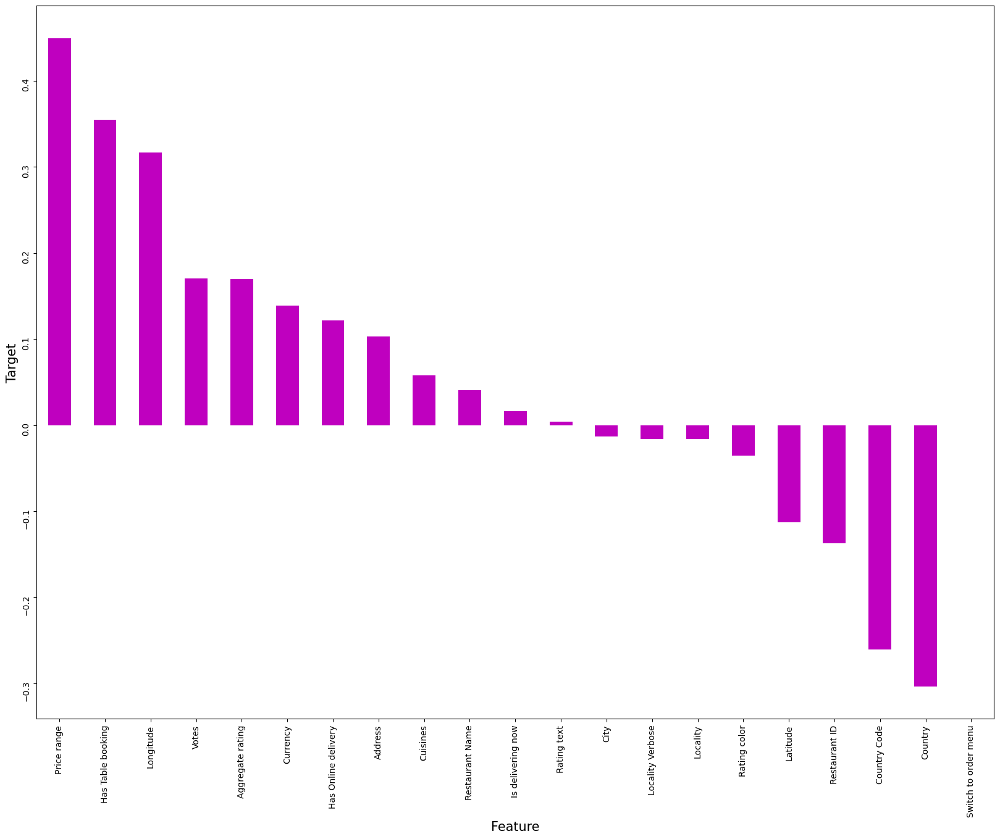

In [20]:
plt.figure(figsize = (20,15))
correlation['Average Cost for two'].sort_values(ascending=False).drop(['Average Cost for two']).plot(kind='bar',color="m")
plt.xlabel('Feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.yticks(rotation=90);
plt.show()

lets declare the x and y variable of the dataframe.

In [11]:
x = zomato_data.drop("Average Cost for two", axis=1)
y = zomato_data["Average Cost for two"]

lets scale the data using the standard scaler

In [12]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,-0.306015,-0.277839,-0.642824,-0.211034,-3.332289,0.004116,-2.029851,-1.990609,0.334861,0.118764,...,0.024395,-0.371446,-0.587547,-0.059771,0.0,1.319803,0.813580,1.371170,0.124686,0.564373
1,-0.306015,-0.277839,-0.642788,0.750323,-3.332289,0.024385,-2.029851,-1.990609,-1.546527,-2.348827,...,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.549780,1.371170,0.124686,0.184617
2,-0.306015,-0.277839,-0.642826,1.524074,-3.332289,0.659328,-2.029851,-1.990609,0.334862,0.118689,...,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.615730,1.371170,0.124686,0.331228
3,-0.306015,-0.277839,-0.642824,-0.940918,-3.332289,-1.731552,-1.437798,-1.423849,0.334536,0.121877,...,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.879530,-1.308053,1.895070,0.289418
4,-0.306015,-0.277839,-0.642825,0.592119,-3.332289,-1.257585,-1.437798,-1.423849,0.334765,0.122404,...,0.024395,-0.371446,-0.587547,-0.059771,0.0,1.319803,1.011430,-1.308053,1.895070,0.716820
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,3.482693,3.870249,0.983529,1.465740,2.444146,-1.272007,1.633280,1.669214,-3.773364,1.512081,...,-2.163326,-0.371446,-0.587547,-0.059771,0.0,-0.888771,0.681680,1.371170,0.124686,0.371012
9547,3.482693,3.870249,0.983533,1.486740,2.444146,-0.730999,1.633280,1.669214,-3.773370,1.512037,...,-2.163326,-0.371446,-0.587547,-0.059771,0.0,-0.888771,0.549780,1.371170,0.124686,0.087142
9548,3.482693,3.870249,0.983522,1.536208,2.444146,-1.397515,1.633280,1.669214,-3.773071,1.509099,...,-2.163326,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.813580,1.371170,0.124686,0.633240
9549,3.482693,3.870249,0.983150,1.507274,2.487254,-1.026059,1.639612,1.675243,-3.488640,1.321086,...,-2.163326,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.813580,1.371170,0.124686,0.633240


Variance Inflation Factors

In [13]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

C:\ProgramData\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1754: RuntimeWarning: invalid value encountered in scalar divide
  return 1 - self.ssr/self.uncentered_tss


,VIF values,Features
0,48.291470,Country Code
1,67.083156,Country
2,1.407941,Restaurant ID
3,1.008374,Restaurant Name
4,1.086732,City
5,1.119511,Address
6,956.103011,Locality
7,955.069883,Locality Verbose
8,5.133051,Longitude
9,3.073284,Latitude


lets remove the columns with very low correlation and very high vif values

In [14]:
columns_with_low_corelation_and_high_VIF = ['Switch to order menu','Cuisines','Restaurant Name','Is delivering now','Rating text','City','Locality Verbose','Locality','Rating color','Country Code','Country','Aggregate rating','Currency','Has Online delivery','Address']
zomato_data = zomato_data.drop(columns=columns_with_low_corelation_and_high_VIF)

Now lets repeat the process again, declare the variables, scale the data and get vif values of our new dataframe

In [15]:
x = zomato_data.drop("Average Cost for two", axis=1)
y = zomato_data["Average Cost for two"]

In [16]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,Restaurant ID,Longitude,Latitude,Has Table booking,Price range,Votes
0,-0.642824,0.334861,0.118764,-0.371446,1.319803,0.564373
1,-0.642788,-1.546527,-2.348827,-0.371446,0.215516,0.184617
2,-0.642826,0.334862,0.118689,-0.371446,0.215516,0.331228
3,-0.642824,0.334536,0.121877,-0.371446,0.215516,0.289418
4,-0.642825,0.334765,0.122404,-0.371446,1.319803,0.716820
...,...,...,...,...,...,...
9546,0.983529,-3.773364,1.512081,-0.371446,-0.888771,0.371012
9547,0.983533,-3.773370,1.512037,-0.371446,-0.888771,0.087142
9548,0.983522,-3.773071,1.509099,-0.371446,0.215516,0.633240
9549,0.983150,-3.488640,1.321086,-0.371446,0.215516,0.633240


In [17]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,1.230659,Restaurant ID
1,1.148867,Longitude
2,1.070265,Latitude
3,1.410267,Has Table booking
4,1.808163,Price range
5,1.598459,Votes


the vif values are corrected.

lets get y value counts

In [18]:
y.value_counts()

7.937005     900
6.694330     897
7.368063     857
5.848035     687
8.434327     652
            ... 
41.212853      1
54.848066      1
76.630943      1
49.324241      1
16.261333      1
Name: Average Cost for two, Length: 140, dtype: int64

z-scores

In [19]:
from scipy.stats import zscore
out_features=zomato_data[['Restaurant ID', 'Longitude', 'Latitude', 'Has Table booking', 'Price range','Votes']]
z=np.abs(zscore(out_features))
z

,Restaurant ID,Longitude,Latitude,Has Table booking,Price range,Votes
0,0.642824,0.334861,0.118764,0.371446,1.319803,0.564373
1,0.642788,1.546527,2.348827,0.371446,0.215516,0.184617
2,0.642826,0.334862,0.118689,0.371446,0.215516,0.331228
3,0.642824,0.334536,0.121877,0.371446,0.215516,0.289418
4,0.642825,0.334765,0.122404,0.371446,1.319803,0.716820
...,...,...,...,...,...,...
9546,0.983529,3.773364,1.512081,0.371446,0.888771,0.371012
9547,0.983533,3.773370,1.512037,0.371446,0.888771,0.087142
9548,0.983522,3.773071,1.509099,0.371446,0.215516,0.633240
9549,0.983150,3.488640,1.321086,0.371446,0.215516,0.633240


now lets get z scores of the rows above 3/-3

In [20]:
np.where(z>3)

(array([ 102,  103,  104,  107,  111,  112,  115,  119,  181,  189,  190,
         191,  197,  200,  523,  539,  623,  624,  628,  629,  632,  634,
         840,  930,  931, 1237, 1242, 1676, 1678, 1680, 1683, 1687, 1690,
        1778, 1782, 1785, 1786, 1787, 1788, 1789, 1790, 1856, 1859, 1861,
        1864, 1866, 1868, 1871, 2011, 2384, 2389, 2392, 2394, 2402, 2404,
        2417, 2425, 2431, 2432, 2433, 2436, 2444, 2451, 2459, 2461, 2469,
        2470, 2471, 2477, 2483, 2486, 2488, 2491, 2492, 2493, 2495, 2692,
        2695, 2712, 2814, 2965, 2975, 2977, 3352, 3359, 3360, 3362, 3368,
        3369, 3370, 3463, 3554, 3696, 4014, 4025, 4049, 4383, 4402, 5520,
        5693, 6077, 6088, 6224, 6409, 6463, 7239, 7810, 8533, 8543, 8652,
        8653, 8654, 8655, 8656, 8657, 8658, 8659, 8660, 8661, 8662, 8663,
        8664, 8665, 8666, 8667, 8668, 8669, 8670, 8671, 8672, 8673, 8674,
        8675, 8676, 8677, 8678, 8679, 8680, 8681, 8682, 8683, 8684, 8685,
        8686, 8687, 8688, 8689, 8690, 

now lets get the shape of the new dataframe after removing the rows with z-score above 3/-3

In [21]:
zomato_data_new=zomato_data[(z<3).all(axis=1)]
zomato_data_new.shape

(8818, 7)

lets get the data loss percentage after removing the rows

In [22]:
data_loss_percentage = ((zomato_data.shape[0] - zomato_data_new.shape[0]) / zomato_data.shape[0]) * 100
print("Data Loss Percentage:", data_loss_percentage)

Data Loss Percentage: 7.674589048267197


now lets declare the x and y variable of our new processed dataframe

In [23]:
x = zomato_data_new.drop("Average Cost for two", axis=1)
y = zomato_data_new["Average Cost for two"]

In [24]:
y.value_counts()

7.937005     894
6.694330     889
7.368063     850
5.848035     679
8.434327     648
            ... 
6.463304       1
7.547842       1
6.804092       1
11.318512      1
10.163964      1
Name: Average Cost for two, Length: 124, dtype: int64

Predictions

In [25]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor,ExtraTreesRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR

lets get the best r2 score at the maximum random state using the linear regression with train test split 60-40.

In [26]:
maxaccuracy = 0
maxrandomstate = 0
for i in range(1,200):
      x_train,x_test,y_train,y_test = train_test_split(x,y, test_size = 0.40, random_state=i)
      LR = LinearRegression()
      LR.fit(x_train,y_train)
pred=LR.predict(x_test)
acc = r2_score(y_test, pred)
if acc>maxaccuracy:
    maxaccuracy=acc
    maxrandomstate=i
print("the best r2 score",maxaccuracy,"at the following random state",maxrandomstate)

the best r2 score 0.4239179584765972 at the following random state 199


lets train the model using a 70-30 split model using the maximum random state

In [27]:
x_train,x_test,y_train,y_test = train_test_split(x,y, test_size = 0.30, random_state=maxrandomstate)

We will be using the following regression models- GradientBoostingRegressor, RandomForestRegressor,ExtraTreesRegressor,LinearRegression, LogisticRegression,KNeighborsRegressor,Lasso, Ridge,DecisionTreeRegressor and support vector regressor.

In [28]:
LinReg = LinearRegression()
LinReg.fit(x_train,y_train)
predLinReg=LinReg.predict(x_test)
predtrain=LinReg.predict(x_train)
print(r2_score(y_test, predLinReg))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predLinReg))
print(mean_squared_error(y_test,predLinReg))
print(np.sqrt(mean_squared_error(y_test,predLinReg)))

0.4049798819771989
43.8566474808113
0.9078152566407646
6.381300987335459
2.52612370784478


linear regression gives an r2 score of 43.8566474808113 with mae 0.9078152566407646 and mse 6.381300987335459.

In [29]:
GradReg = GradientBoostingRegressor()
GradReg.fit(x_train,y_train)
predGradReg=GradReg.predict(x_test)
predtrain=GradReg.predict(x_train)
print(r2_score(y_test, predGradReg))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predGradReg))
print(mean_squared_error(y_test,predGradReg))
print(np.sqrt(mean_squared_error(y_test,predGradReg)))

0.8908191784717888
94.88867423484686
0.6279893562211241
1.1709111391581095
1.0820864748984296


gradient boosting regression gives an r2 score of 94.88867423484686 with mae 0.6279893562211241 and mse 1.1709111391581095.

In [30]:
RFR = RandomForestRegressor()
RFR.fit(x_train,y_train)
predRFR=RFR.predict(x_test)
predtrain=RFR.predict(x_train)
print(r2_score(y_test, predRFR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predRFR))
print(mean_squared_error(y_test,predRFR))
print(np.sqrt(mean_squared_error(y_test,predRFR)))

0.8934746774428156
98.42085640477869
0.6190863957385312
1.1424322059381873
1.068846203126618


random forest regression gives an r2 score of 98.42085640477869 with mae 0.6190863957385312 and mse 1.1424322059381873.

In [31]:
ETR = ExtraTreesRegressor()
ETR.fit(x_train,y_train)
predETR=ETR.predict(x_test)
predtrain=ETR.predict(x_train)
print(r2_score(y_test, predETR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predETR))
print(mean_squared_error(y_test,predETR))
print(np.sqrt(mean_squared_error(y_test,predETR)))

0.8757937570855927
99.99837035985651
0.6436450692013665
1.332051466052385
1.1541453400904


extra tree regression gives an r2 score of 99.99837035985651 with mae 0.6436450692013665 and mse 1.332051466052385.

In [32]:
Lasso = Lasso()
Lasso.fit(x_train,y_train)
predLasso=Lasso.predict(x_test)
predtrain=Lasso.predict(x_train)
print(r2_score(y_test, predLasso))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predLasso))
print(mean_squared_error(y_test,predLasso))
print(np.sqrt(mean_squared_error(y_test,predLasso)))

0.28809344109172097
32.02604768116382
1.2531777981040895
7.63485114141621
2.7631234394098665


lasso regression gives an r2 score of 32.02604768116382 with mae 1.2531777981040895 and mse 7.63485114141621.

In [33]:
Ridge = Ridge()
Ridge.fit(x_train,y_train)
predRidge=Ridge.predict(x_test)
predtrain=Ridge.predict(x_train)
print(r2_score(y_test, predRidge))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predRidge))
print(mean_squared_error(y_test,predRidge))
print(np.sqrt(mean_squared_error(y_test,predRidge)))

0.4049799169506868
43.85664585208552
0.9078203952618145
6.381300612261834
2.5261236336058124


ridge regression gives an r2 score of 43.85664585208552 with mae 0.9078203952618145 and mse 6.381300612261834.

In [34]:
DTR = DecisionTreeRegressor()
DTR.fit(x_train,y_train)
predDTR=DTR.predict(x_test)
predtrain=DTR.predict(x_train)
print(r2_score(y_test, predDTR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predDTR))
print(mean_squared_error(y_test,predDTR))
print(np.sqrt(mean_squared_error(y_test,predDTR)))

0.8413233691506623
99.99837035985651
0.7621172282418346
1.701729589363467
1.3045035796667892


decision tree regression gives an r2 score of 99.99837035985651 with mae 0.762117228241834 and mse 1.701729589363467.

In [35]:
SVR = SVR()
SVR.fit(x_train,y_train)
predSVR=SVR.predict(x_test)
predtrain=SVR.predict(x_train)
print(r2_score(y_test, predSVR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predSVR))
print(mean_squared_error(y_test,predSVR))
print(np.sqrt(mean_squared_error(y_test,predSVR)))

-0.01718376427081858
-1.598804124542852
1.6261557014125079
10.908800497051834
3.302847331780843


support vector regression gives an r2 score of -1.598804124542852 with mae 1.6261557014125079 and mse 10.908800497051834.

In [36]:
KNN = KNeighborsRegressor(n_neighbors=5) 
KNN.fit(x_train, y_train)
predKNN = KNN.predict(x_test)
predTrain = KNN.predict(x_train)
print("R-squared (Test):", r2_score(y_test, predKNN))
print("R-squared (Train):", r2_score(y_train, predTrain) * 100)
print("Mean Absolute Error:", mean_absolute_error(y_test, predKNN))
print("Mean Squared Error:", mean_squared_error(y_test, predKNN))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(y_test, predKNN)))

R-squared (Test): 0.4954570413651651
R-squared (Train): 61.23680434392611
Mean Absolute Error: 1.5397702644496292
Mean Squared Error: 5.410977515832918
Root Mean Squared Error: 2.32615079387234


k neighbours regression gives an r2 score of 61.23680434392611 with mae 1.5397702644496292 and mse 5.410977515832918.

Cross Validation Scores

In [37]:
from sklearn.model_selection import cross_val_score

In [38]:
score = cross_val_score(RFR,x,y,cv=5,scoring='r2')
print(score)
print(score.mean())
print("r2-cv-",(r2_score(y_test,predRFR)-score.mean()))

[0.81317641 0.83288367 0.816729   0.86013132 0.07505081]
0.6795942427331555
r2-cv- 0.21388043470966012


In [39]:
score2 = cross_val_score(GradReg,x,y,cv=5,scoring='r2')
print(score2)
print(score2.mean())
print("r2-cv-",(r2_score(y_test,predGradReg)-score.mean()))

[0.81341469 0.85609366 0.82573291 0.86180202 0.08051076]
0.6875108066963131
r2-cv- 0.21122493573863332


In [40]:
score3 = cross_val_score(LinReg,x,y,cv=5,scoring='r2')
print(score3)
print(score3.mean())
print("r2-cv-",(r2_score(y_test,predLinReg)-score.mean()))

[ 0.53934663  0.76425255  0.81464194  0.80935075 -0.02725941]
0.5800664905413713
r2-cv- -0.2746143607559566


In [41]:
score4 = cross_val_score(DTR,x,y,cv=5,scoring='r2')
print(score4)
print(score4.mean())
print("r2-cv-",(r2_score(y_test,predDTR)-score.mean()))

[0.66991236 0.58153063 0.64076849 0.75080589 0.05650353]
0.5399041810263683
r2-cv- 0.1617291264175068


In [42]:
score5 = cross_val_score(Lasso,x,y,cv=5,scoring='r2')
print(score5)
print(score5.mean())
print("r2-cv-",(r2_score(y_test,predLasso)-score5.mean()))

[0.27603855 0.38994085 0.4348495  0.33967765 0.05874601]
0.2998505120727385
r2-cv- -0.011757070981017526


In [43]:
score6 = cross_val_score(Ridge,x,y,cv=5,scoring='r2')
print(score6)
print(score6.mean())
print("r2-cv-",(r2_score(y_test,predRidge)-score6.mean()))

[ 0.53930191  0.76422422  0.81463467  0.80929507 -0.0272526 ]
0.5800406535389675
r2-cv- -0.1750607365882807


In [44]:
score7 = cross_val_score(KNN,x,y,cv=5,scoring='r2')
print(score7)
print(score7.mean())
print("r2-cv-",(r2_score(y_test,predRidge)-score7.mean()))

[-0.27032718 -0.11280425 -0.29383624  0.08833792 -0.01078294]
-0.11988253886818678
r2-cv- 0.5248624558188736


In [45]:
score8 = cross_val_score(SVR,x,y,cv=5,scoring='r2')
print(score8)
print(score8.mean())
print("r2-cv-",(r2_score(y_test,predSVR)-score8.mean()))

[-0.14065144 -0.032231   -0.01129711  0.00024497  0.00984501]
-0.03481791341360441
r2-cv- 0.017634149142785827


In [46]:
score9 = cross_val_score(ETR,x,y,cv=5,scoring='r2')
print(score9)
print(score9.mean())
print("r2-cv-",(r2_score(y_test,predSVR)-score9.mean()))

[0.71598092 0.84049297 0.80188445 0.85576528 0.0706647 ]
0.6569576641456599
r2-cv- -0.6741414284164785


After careful analysis of the cv scores, we found that decision tree regressor is best model because it  doesn not underfit or overfit( like svr or linear regression) and has the least difference between r2 and cv scores= 0.1617291264175068.

Hyperparameter Tuning

We will be using the following parameters for decision tree regressor= 'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'],'splitter': ['best', 'random'],'max_depth': [None, 10, 20, 30],'min_samples_split': [2, 5, 10],'min_samples_leaf': [1, 2, 4],'max_features': ['auto', 'sqrt', 'log2', None]

In [47]:
from sklearn.model_selection import GridSearchCV

In [60]:
parameters = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'],'splitter': ['best', 'random'],'max_depth': [None, 10, 20, 30],'min_samples_split': [2, 5, 10],'min_samples_leaf': [1, 2, 4],'max_features': ['auto', 'sqrt', 'log2', None]}

In [61]:
gscv = GridSearchCV(DecisionTreeRegressor(), parameters, cv=5,n_jobs=-1)

In [62]:
gscv.fit(x_train, y_train)

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


GridSearchCV(cv=5, estimator=DecisionTreeRegressor(), n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'poisson',
                                       'squared_error', 'absolute_error'],
                         'max_depth': [None, 10, 20, 30],
                         'max_features': ['auto', 'sqrt', 'log2', None],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'splitter': ['best', 'random']})

now get the best parameters for the selected model

In [63]:
gscv.best_params_

{'criterion': 'poisson',
 'max_depth': 10,
 'max_features': 'auto',
 'min_samples_leaf': 4,
 'min_samples_split': 2,
 'splitter': 'random'}

now lets train the selected model with these parameters

In [65]:
Selected_model=DecisionTreeRegressor(criterion= 'poisson',max_depth= 10,max_features='auto',min_samples_leaf= 4,min_samples_split= 2,splitter='random')

now lets get the r2 scores of the selected model

In [66]:
Selected_model.fit(x_train,y_train)
pred = Selected_model.predict(x_test)
print(r2_score(y_test, pred))
print(mean_absolute_error(y_test,pred))
print(mean_squared_error(y_test,pred))
print(np.sqrt(mean_squared_error(y_test,pred)))

0.8923239471473279
0.6483012344011477
1.1547732279445573
1.0746037539226063


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


our selected model got an r2 score of 0.8923239471473279 with mae 0.6483012344011477 and mse 1.1547732279445573.

Saving the model

We will be using the joblib and pickle method to save the model

In [67]:
import joblib

In [68]:
import pickle
filename='average cost for two.pkl'
pickle.dump(Selected_model,open(filename,'wb'))

In [69]:
import pickle
loaded_model=pickle.load(open('average cost for two.pkl','rb'))
result=loaded_model.score(x_test,y_test)
print(result*100)

89.23239471473279


we got an r2 score of 89.23239471473279.

lets compare the predicted and original scores

In [70]:
Conclusion=pd.DataFrame([loaded_model.predict(x_test)[:],y_test[:]],index=["Predicted","Original"])
Conclusion

,0,1,2,3,4,5,6,7,8,9,...,2636,2637,2638,2639,2640,2641,2642,2643,2644,2645
Predicted,8.443315,6.486710,6.109925,6.714528,8.506267,8.168324,10.876813,6.670616,8.442810,5.904806,...,6.261393,6.691151,6.482012,8.443315,6.465276,11.334382,10.607480,5.991629,11.102663,6.802726
Original,8.193213,5.313293,7.047299,7.368063,8.434327,8.434327,11.447142,7.663094,8.434327,5.848035,...,4.641589,7.047299,6.299605,7.937005,5.313293,10.000000,11.186889,5.313293,10.322801,7.663094


We  can see that our model has performed well, which helps to conclude the first part of the project.

Part 2 - Classification model for price range

lets declare the input variables for the second part of the project

In [79]:
zomatodata_xvariable = zomato_data.iloc[:, :17].join(zomato_data.iloc[:, 18:])
zomatodata_xvariable

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Aggregate rating,Rating color,Rating text,Votes
0,1.0,3.0,3400025.0,3201.0,1.0,4553.0,17.0,17.0,78.011544,27.161661,...,850.0,4.0,0.0,0.0,0.0,0.0,3.9,5.0,2.0,140.0
1,1.0,3.0,3400341.0,5261.0,1.0,4605.0,17.0,17.0,0.000000,0.000000,...,700.0,4.0,0.0,0.0,0.0,0.0,3.5,5.0,2.0,71.0
2,1.0,3.0,3400005.0,6919.0,1.0,6234.0,17.0,17.0,78.011608,27.160832,...,500.0,4.0,0.0,0.0,0.0,0.0,3.6,5.0,2.0,94.0
3,1.0,3.0,3400021.0,1637.0,1.0,100.0,204.0,205.0,77.998092,27.195928,...,400.0,4.0,0.0,0.0,0.0,0.0,4.0,1.0,5.0,87.0
4,1.0,3.0,3400017.0,4922.0,1.0,1316.0,204.0,205.0,78.007553,27.201725,...,1000.0,4.0,0.0,0.0,0.0,0.0,4.2,1.0,5.0,177.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,14.0,17697389.0,6794.0,135.0,1279.0,1174.0,1231.0,-92.335523,42.498400,...,10.0,2.0,0.0,0.0,0.0,0.0,3.7,5.0,2.0,101.0
9547,216.0,14.0,17697424.0,6839.0,135.0,2667.0,1174.0,1231.0,-92.335769,42.497919,...,10.0,2.0,0.0,0.0,0.0,0.0,3.5,5.0,2.0,58.0
9548,216.0,14.0,17697332.0,6945.0,135.0,957.0,1174.0,1231.0,-92.323400,42.465580,...,25.0,2.0,0.0,0.0,0.0,0.0,3.9,5.0,2.0,156.0
9549,216.0,14.0,17694056.0,6883.0,136.0,1910.0,1176.0,1233.0,-80.529488,40.396043,...,25.0,2.0,0.0,0.0,0.0,0.0,3.9,5.0,2.0,156.0


now lets declare the y variable for the second part of the project.

In [80]:
zomatodata_yvariable=zomato_data.iloc[:, 17:18]
zomatodata_yvariable

,Price range
0,3.0
1,2.0
2,2.0
3,2.0
4,3.0
...,...
9546,1.0
9547,1.0
9548,2.0
9549,2.0


lets get the value counts of the output column from our dataframe.

In [81]:
zomato_data_counts = zomato_data['Price range'].value_counts()
print(zomato_data_counts)

1.0    4444
2.0    3113
3.0    1408
4.0     586
Name: Price range, dtype: int64


lets get the unique values of the output column in our dataframe

In [82]:
(zomato_data['Price range'].unique())

array([3., 2., 4., 1.])

lets get the total number of unique values in the dataframe

In [83]:
(zomato_data['Price range'].nunique())

4

now lets get the mean value of the output column in our dataframe

In [84]:
print(zomato_data["Price range"].mean())

1.804837189823055


now lets finalise if all the columns in our dataframe does not consist of any null values

In [86]:
zomato_data.loc[zomato_data["Price range"]==""]

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes


In [ ]:
now lets get the maximum and minimum score of our output column

In [87]:
print("max scores:",zomato_data["Price range"].max())
print("min scores:",zomato_data["Price range"].min())

max scores: 4.0
min scores: 1.0


Univariate analysis

In [ ]:
The countplots and distribution plots will remain the same as the first part of the project.

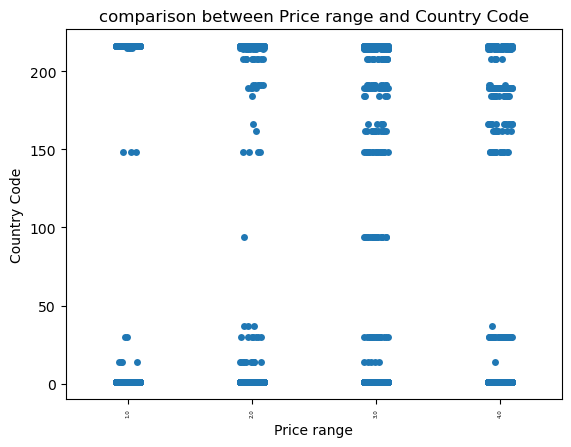

<Figure size 2800x200 with 0 Axes>

In [89]:
plt.title("comparison between Price range and Country Code")
sns.stripplot(x= "Price range", y= "Country Code", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

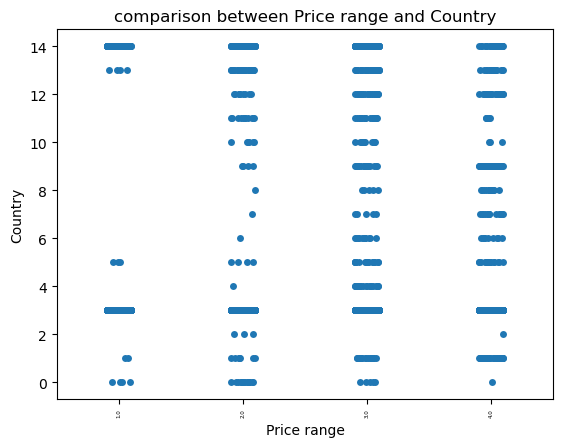

<Figure size 2800x200 with 0 Axes>

In [90]:
plt.title("comparison between Price range and Country")
sns.stripplot(x= "Price range", y= "Country", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

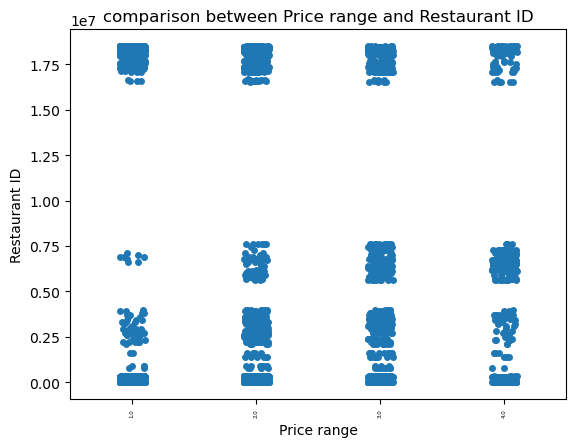

<Figure size 2800x200 with 0 Axes>

In [91]:
plt.title("comparison between Price range and Restaurant ID")
sns.stripplot(x= "Price range", y= "Restaurant ID", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

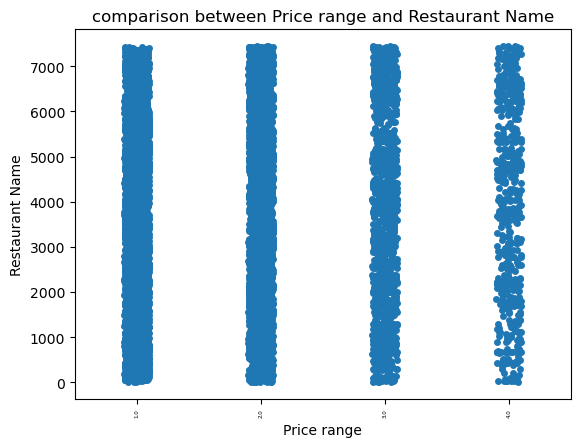

<Figure size 2800x200 with 0 Axes>

In [92]:
plt.title("comparison between Price range and Restaurant Name")
sns.stripplot(x= "Price range", y= "Restaurant Name", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

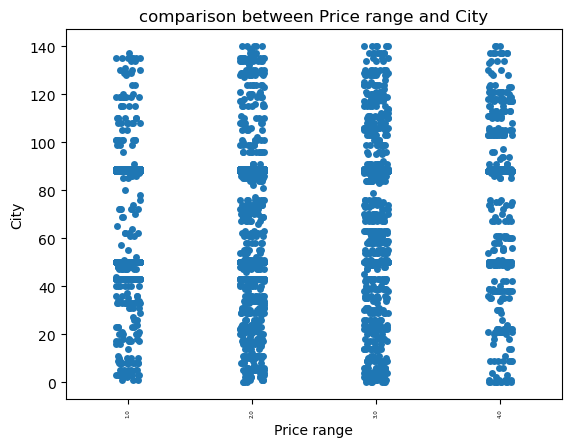

<Figure size 2800x200 with 0 Axes>

In [93]:
plt.title("comparison between Price range and City")
sns.stripplot(x= "Price range", y= "City", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

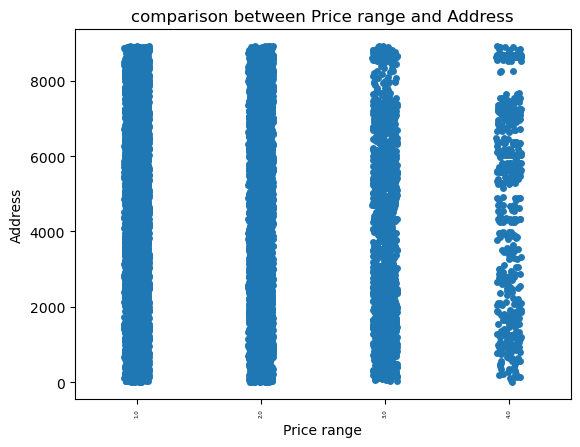

<Figure size 2800x200 with 0 Axes>

In [94]:
plt.title("comparison between Price range and Address")
sns.stripplot(x= "Price range", y= "Address", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

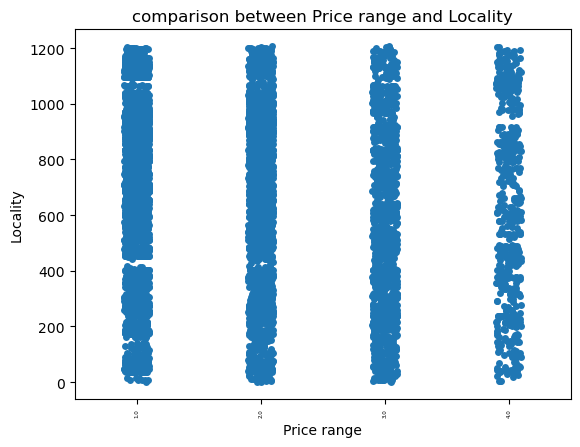

<Figure size 2800x200 with 0 Axes>

In [95]:
plt.title("comparison between Price range and Locality")
sns.stripplot(x= "Price range", y= "Locality", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

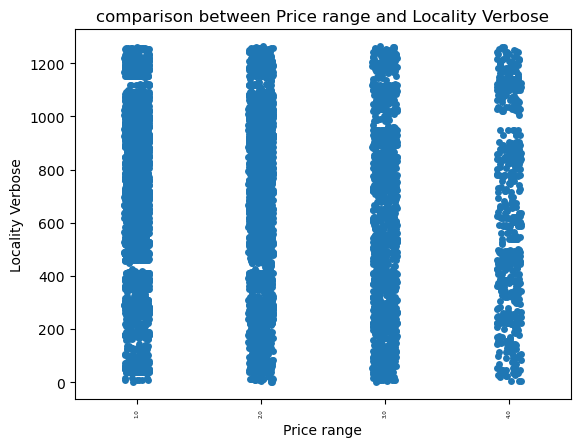

<Figure size 2800x200 with 0 Axes>

In [96]:
plt.title("comparison between Price range and Locality Verbose")
sns.stripplot(x= "Price range", y= "Locality Verbose", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

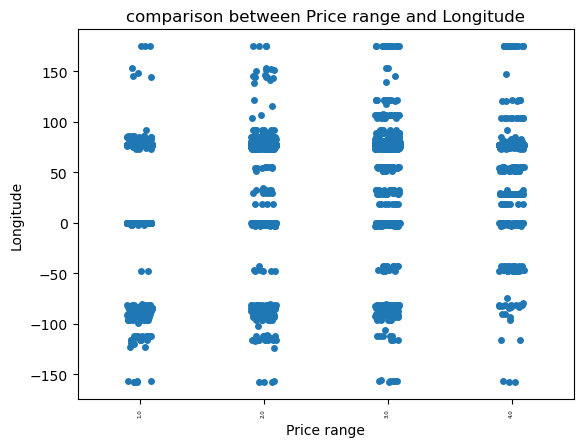

<Figure size 2800x200 with 0 Axes>

In [97]:
plt.title("comparison between Price range and Longitude")
sns.stripplot(x= "Price range", y= "Longitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

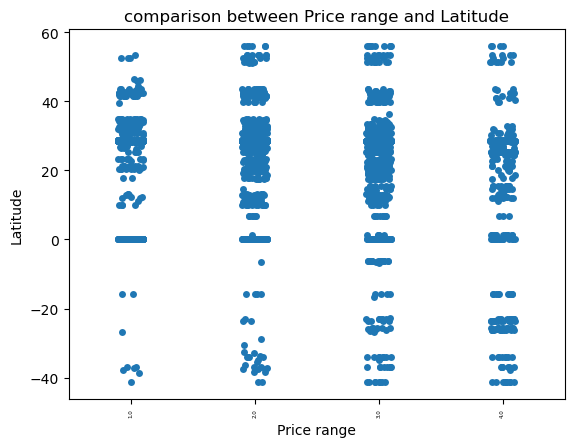

<Figure size 2800x200 with 0 Axes>

In [98]:
plt.title("comparison between Price range and Latitude")
sns.stripplot(x= "Price range", y= "Latitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

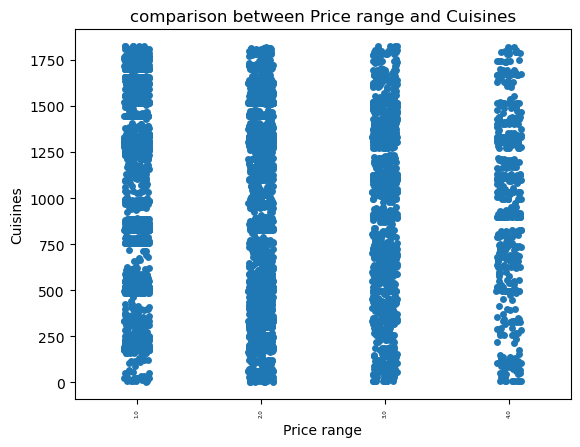

<Figure size 2800x200 with 0 Axes>

In [99]:
plt.title("comparison between Price range and Cuisines")
sns.stripplot(x= "Price range", y= "Cuisines", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

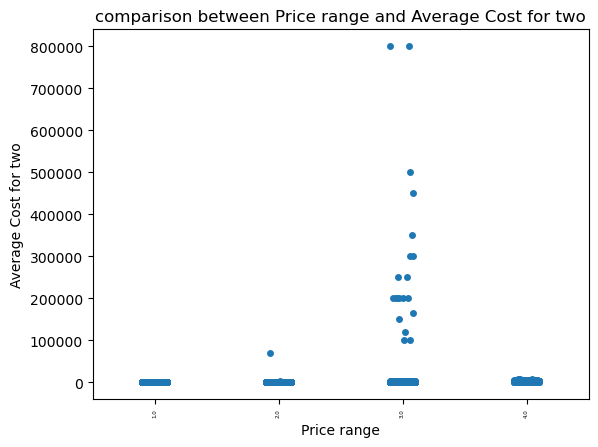

<Figure size 2800x200 with 0 Axes>

In [100]:
plt.title("comparison between Price range and Average Cost for two")
sns.stripplot(x= "Price range", y= "Average Cost for two", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

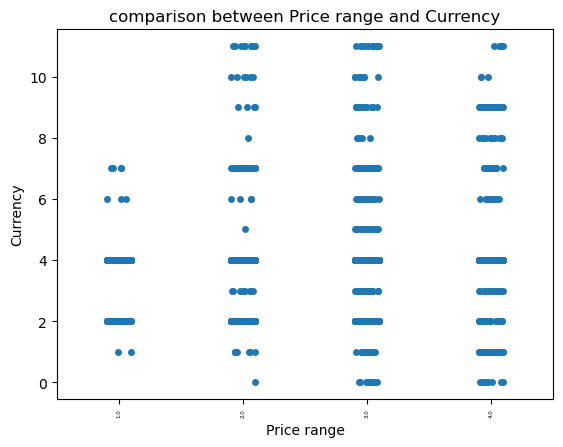

<Figure size 2800x200 with 0 Axes>

In [101]:
plt.title("comparison between Price range and Currency")
sns.stripplot(x= "Price range", y= "Currency", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

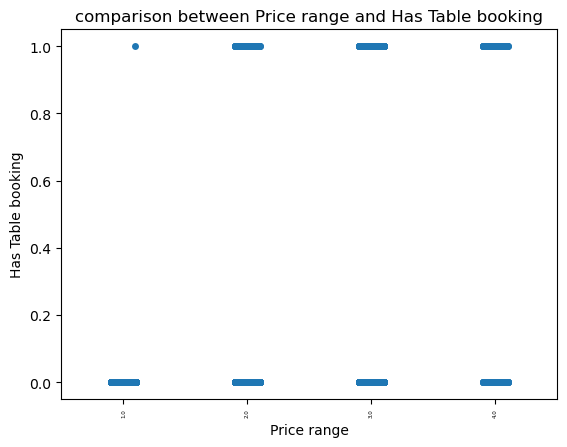

<Figure size 2800x200 with 0 Axes>

In [102]:
plt.title("comparison between Price range and Has Table booking")
sns.stripplot(x= "Price range", y= "Has Table booking", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

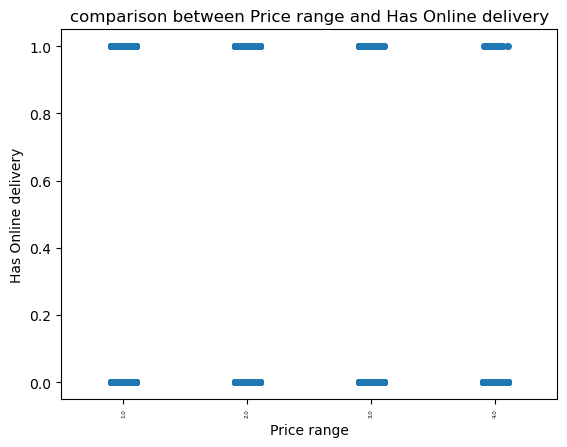

<Figure size 2800x200 with 0 Axes>

In [103]:
plt.title("comparison between Price range and Has Online delivery")
sns.stripplot(x= "Price range", y= "Has Online delivery", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

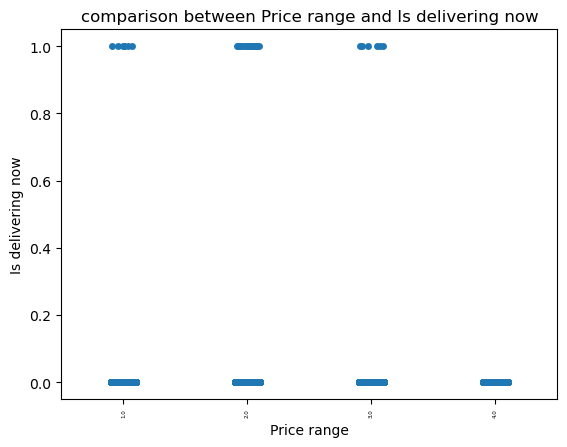

<Figure size 2800x200 with 0 Axes>

In [104]:
plt.title("comparison between Price range and Is delivering now")
sns.stripplot(x= "Price range", y= "Is delivering now", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

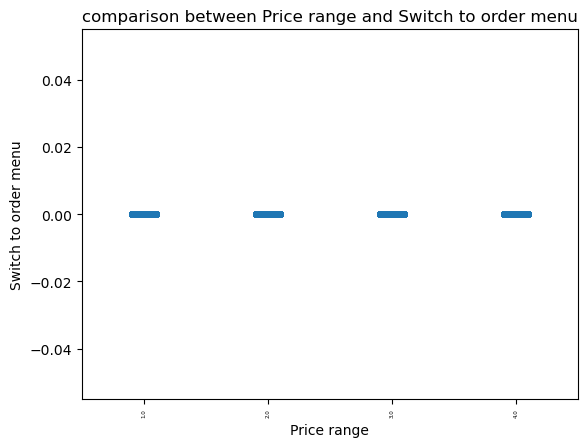

<Figure size 2800x200 with 0 Axes>

In [105]:
plt.title("comparison between Price range and Switch to order menu")
sns.stripplot(x= "Price range", y= "Switch to order menu", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

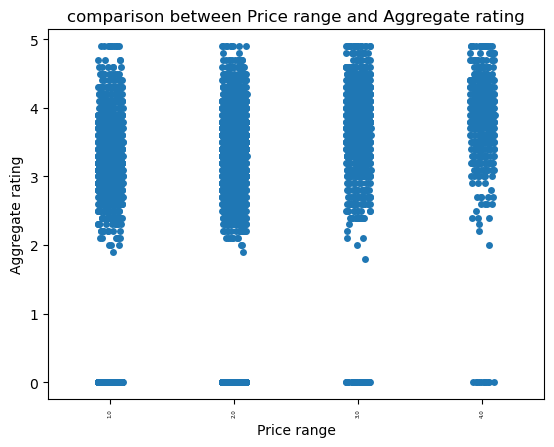

<Figure size 2800x200 with 0 Axes>

In [106]:
plt.title("comparison between Price range and Aggregate rating")
sns.stripplot(x= "Price range", y= "Aggregate rating", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

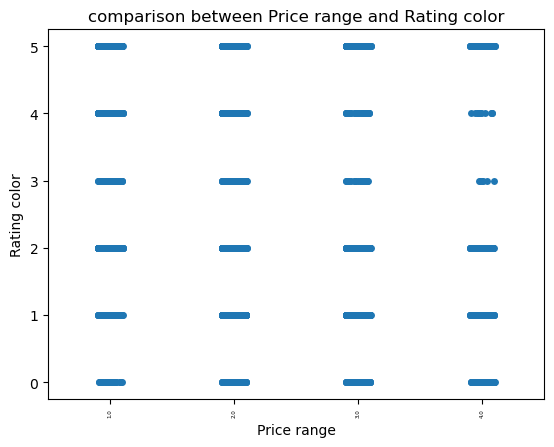

<Figure size 2800x200 with 0 Axes>

In [107]:
plt.title("comparison between Price range and Rating color")
sns.stripplot(x= "Price range", y= "Rating color", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

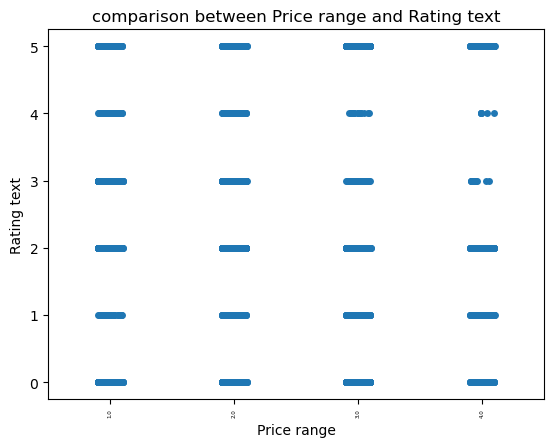

<Figure size 2800x200 with 0 Axes>

In [108]:
plt.title("comparison between Price range and Rating text")
sns.stripplot(x= "Price range", y= "Rating text", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

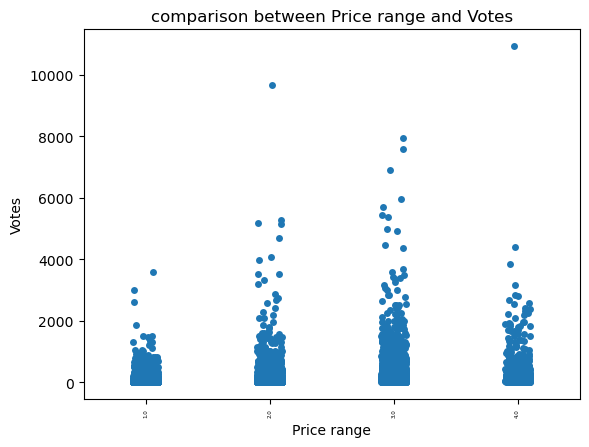

<Figure size 2800x200 with 0 Axes>

In [109]:
plt.title("comparison between Price range and Votes")
sns.stripplot(x= "Price range", y= "Votes", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

Scatterplots

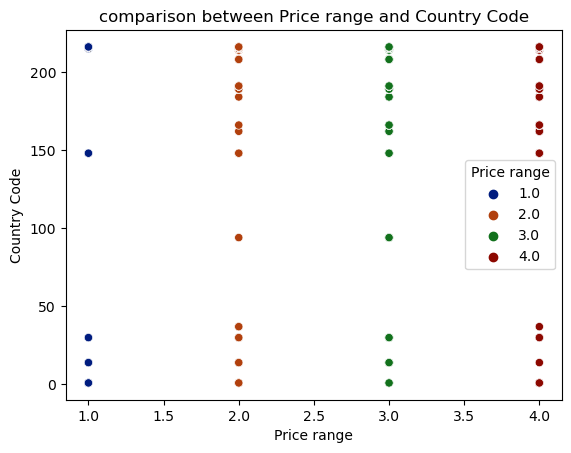

In [110]:
plt.title("comparison between Price range and Country Code")
sns.scatterplot(x= 'Price range', y= 'Country Code', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

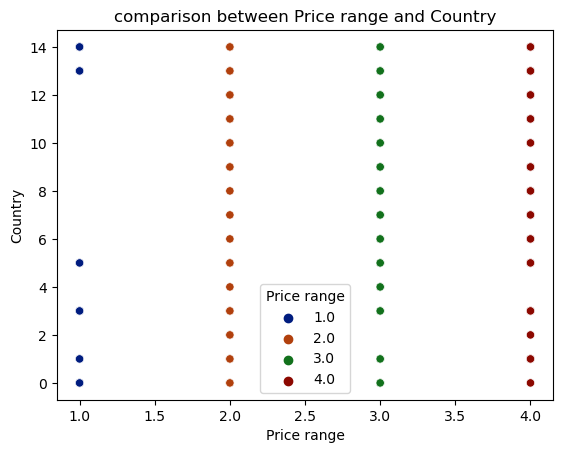

In [111]:
plt.title("comparison between Price range and Country")
sns.scatterplot(x= 'Price range', y= 'Country', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

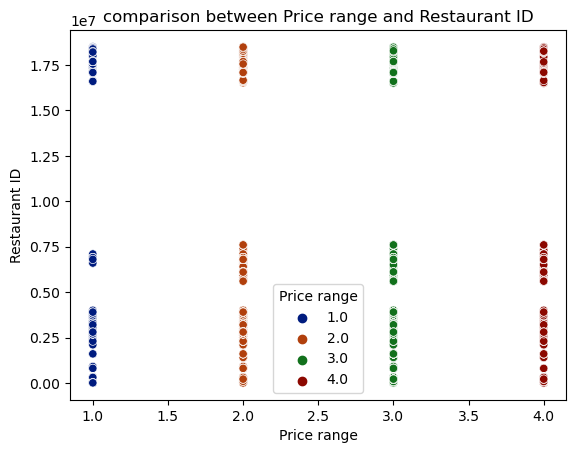

In [112]:
plt.title("comparison between Price range and Restaurant ID")
sns.scatterplot(x= 'Price range', y= 'Restaurant ID', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

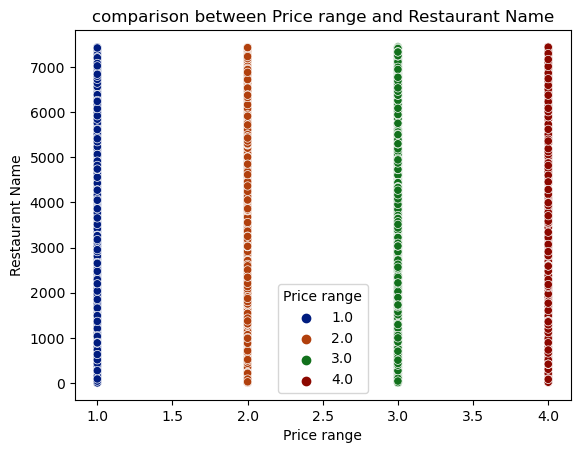

In [113]:
plt.title("comparison between Price range and Restaurant Name")
sns.scatterplot(x= 'Price range', y= 'Restaurant Name', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

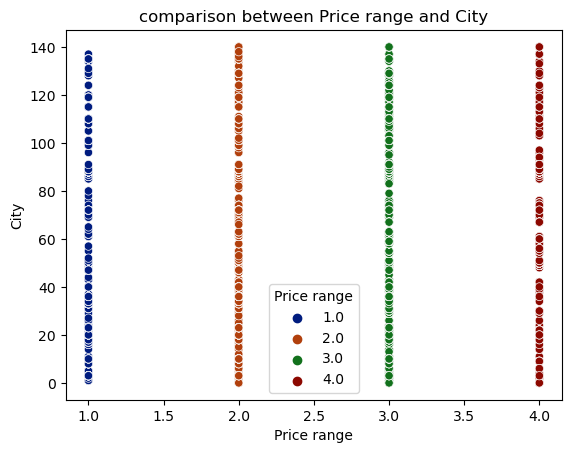

In [114]:
plt.title("comparison between Price range and City")
sns.scatterplot(x= 'Price range', y= 'City', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

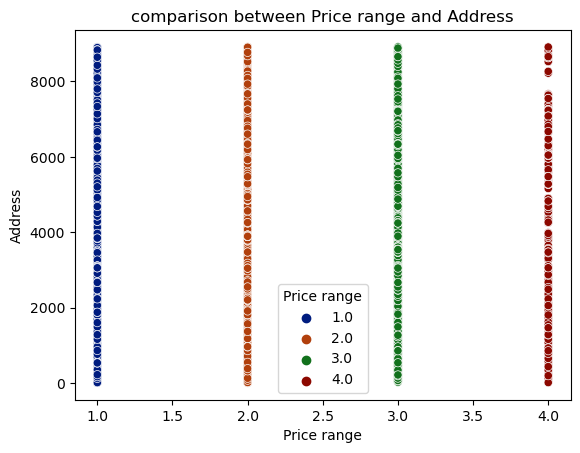

In [115]:
plt.title("comparison between Price range and Address")
sns.scatterplot(x= 'Price range', y= 'Address', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

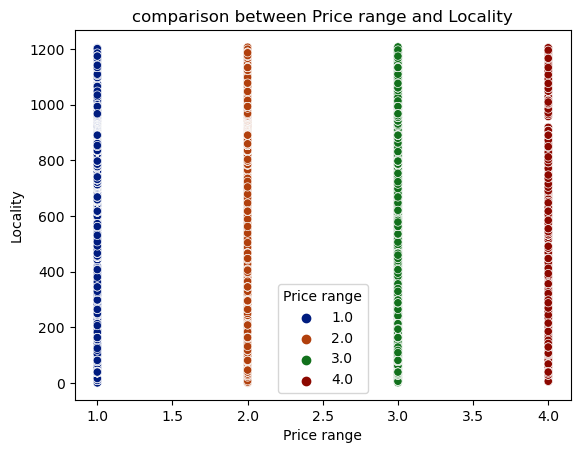

In [116]:
plt.title("comparison between Price range and Locality")
sns.scatterplot(x= 'Price range', y= 'Locality', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

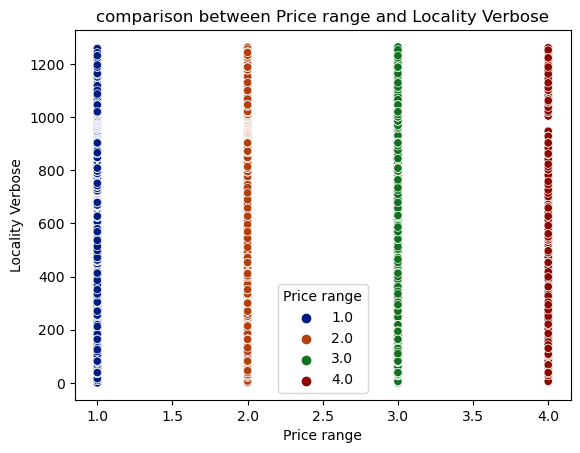

In [117]:
plt.title("comparison between Price range and Locality Verbose")
sns.scatterplot(x= 'Price range', y= 'Locality Verbose', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

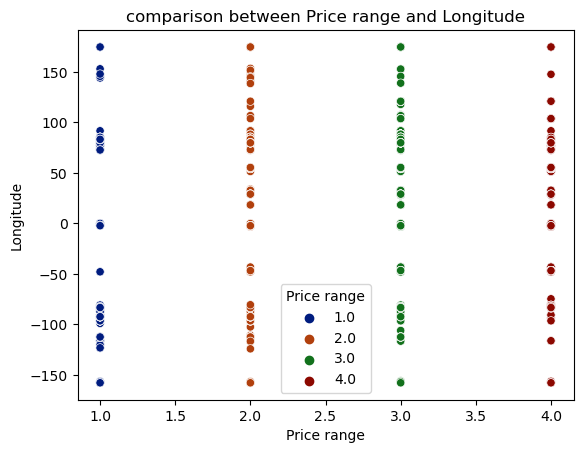

In [118]:
plt.title("comparison between Price range and Longitude")
sns.scatterplot(x= 'Price range', y= 'Longitude', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

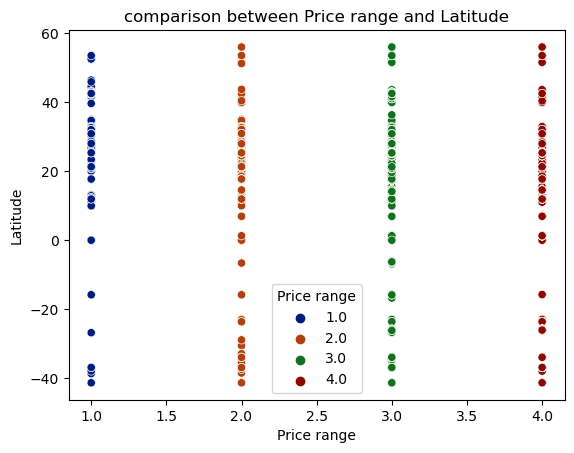

In [119]:
plt.title("comparison between Price range and Latitude")
sns.scatterplot(x= 'Price range', y= 'Latitude', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

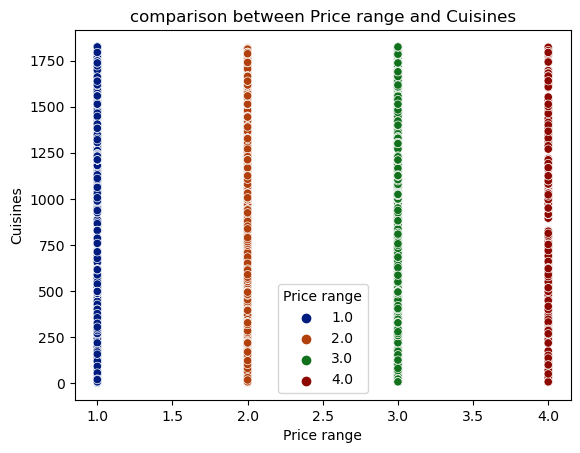

In [120]:
plt.title("comparison between Price range and Cuisines")
sns.scatterplot(x= 'Price range', y= 'Cuisines', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

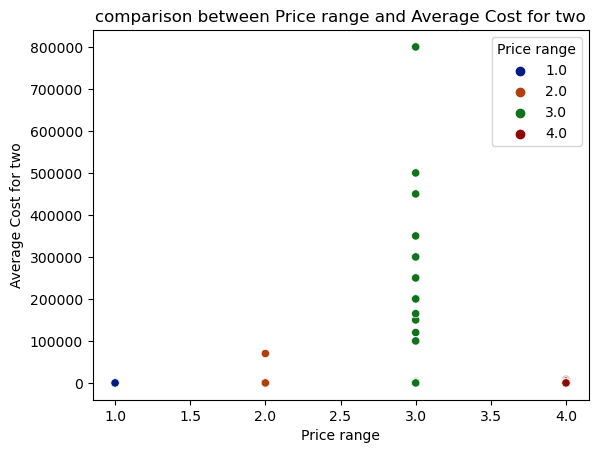

In [121]:
plt.title("comparison between Price range and Average Cost for two")
sns.scatterplot(x= 'Price range', y= 'Average Cost for two', data = zomato_data,hue='Price range', palette='dark')
plt.show()

most of the average cost for two lie in the price range number 2.

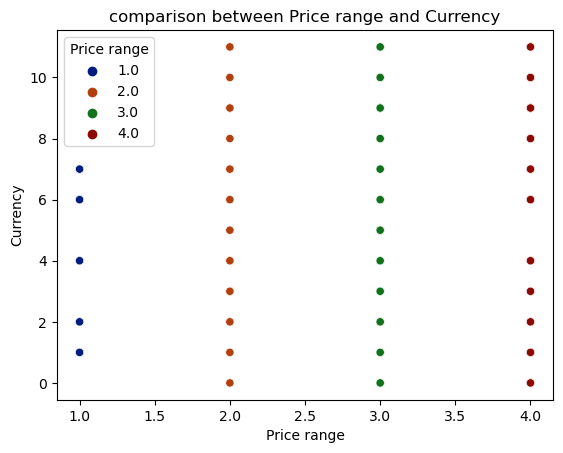

In [122]:
plt.title("comparison between Price range and Currency")
sns.scatterplot(x= 'Price range', y= 'Currency', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

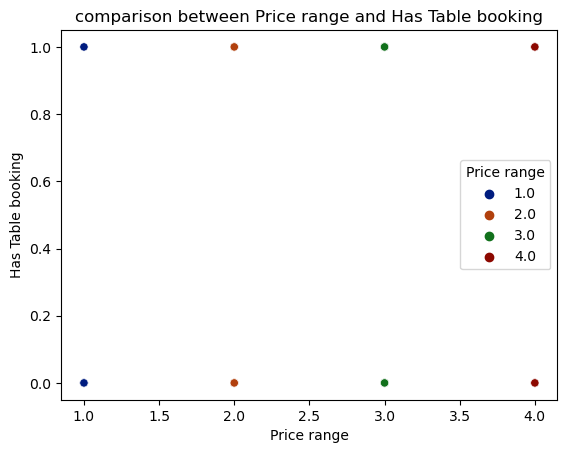

In [123]:
plt.title("comparison between Price range and Has Table booking")
sns.scatterplot(x= 'Price range', y= 'Has Table booking', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

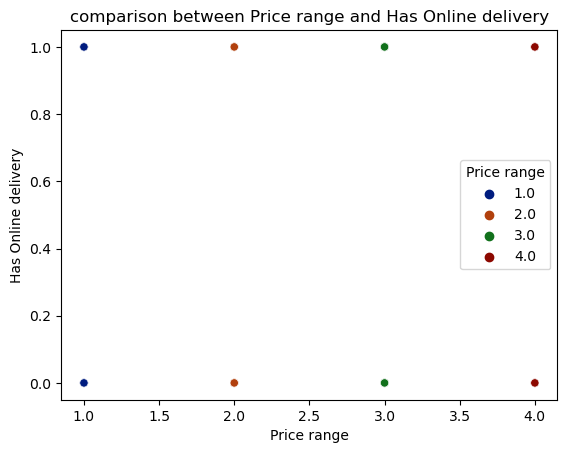

In [124]:
plt.title("comparison between Price range and Has Online delivery")
sns.scatterplot(x= 'Price range', y= 'Has Online delivery', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

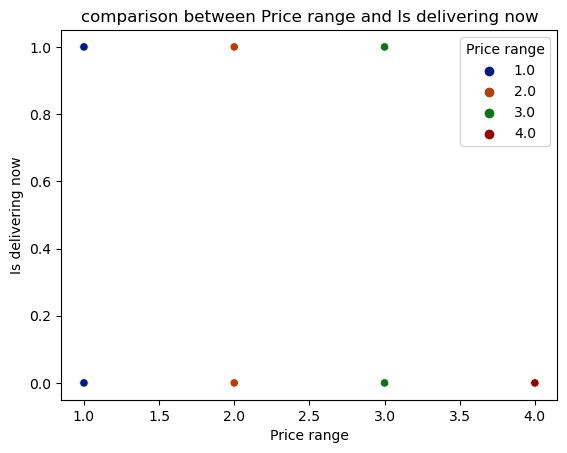

In [125]:
plt.title("comparison between Price range and Is delivering now")
sns.scatterplot(x= 'Price range', y= 'Is delivering now', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

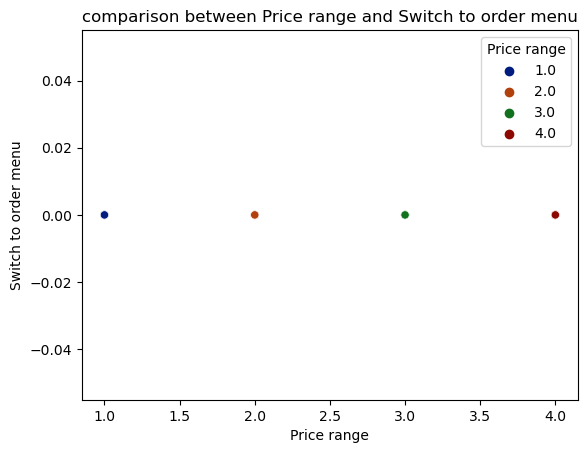

In [126]:
plt.title("comparison between Price range and Switch to order menu")
sns.scatterplot(x= 'Price range', y= 'Switch to order menu', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

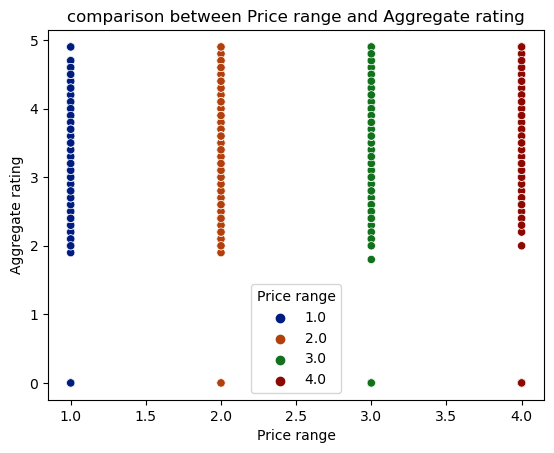

In [127]:
plt.title("comparison between Price range and Aggregate rating")
sns.scatterplot(x= 'Price range', y= 'Aggregate rating', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

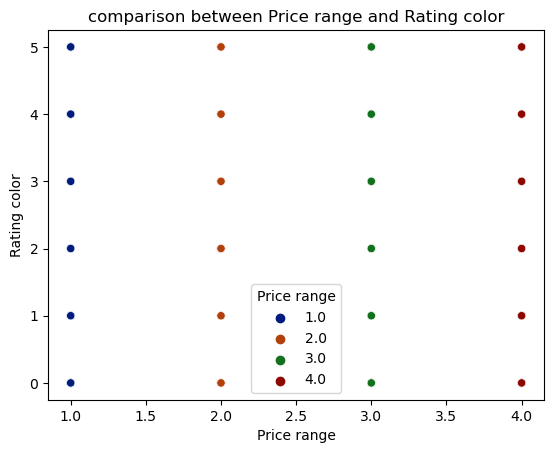

In [128]:
plt.title("comparison between Price range and Rating color")
sns.scatterplot(x= 'Price range', y= 'Rating color', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

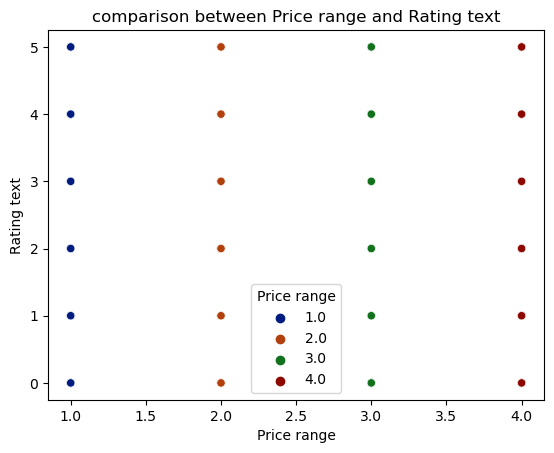

In [129]:
plt.title("comparison between Price range and Rating text")
sns.scatterplot(x= 'Price range', y= 'Rating text', data = zomato_data,hue='Price range', palette='dark')
plt.show()

no conclusive statement can be derived from the above plot.

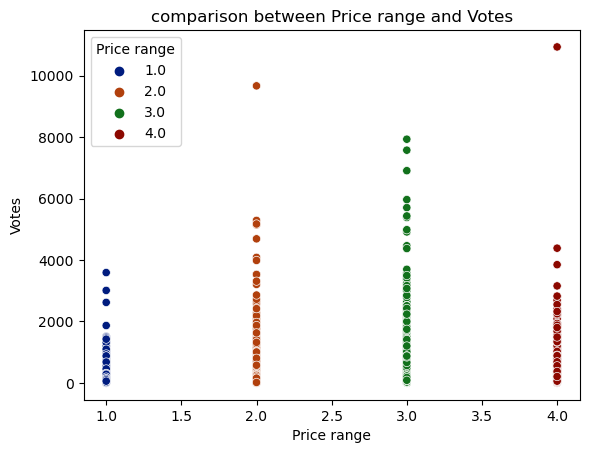

In [130]:
plt.title("comparison between Price range and Votes")
sns.scatterplot(x= 'Price range', y= 'Votes', data = zomato_data,hue='Price range', palette='dark')
plt.show()

most of the votes lie in the price range 3.0.

Barplots

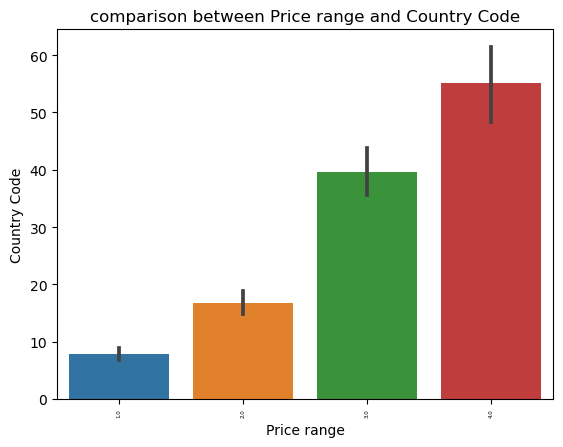

<Figure size 2800x200 with 0 Axes>

In [131]:
plt.title("comparison between Price range and Country Code")
sns.barplot(x= "Price range", y= "Country Code", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the country code lies in the price range number 4.

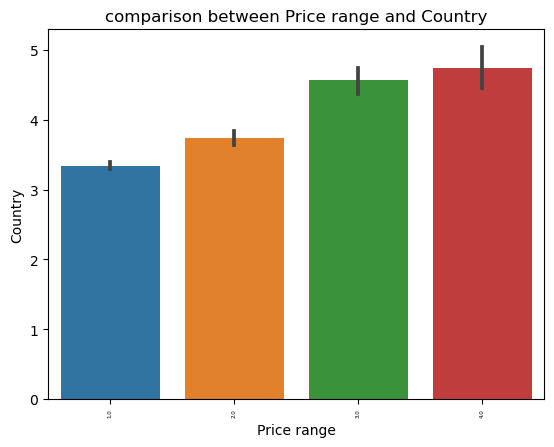

<Figure size 2800x200 with 0 Axes>

In [132]:
plt.title("comparison between Price range and Country")
sns.barplot(x= "Price range", y= "Country", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the country lies in the price range number 4

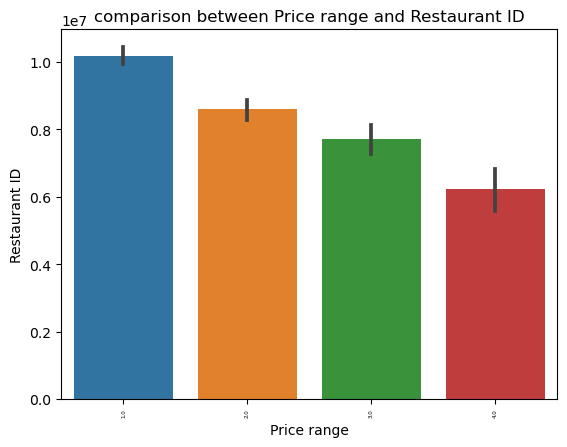

<Figure size 2800x200 with 0 Axes>

In [133]:
plt.title("comparison between Price range and Restaurant ID")
sns.barplot(x= "Price range", y= "Restaurant ID", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

Most of the restaurant id lies in the price range number 1.

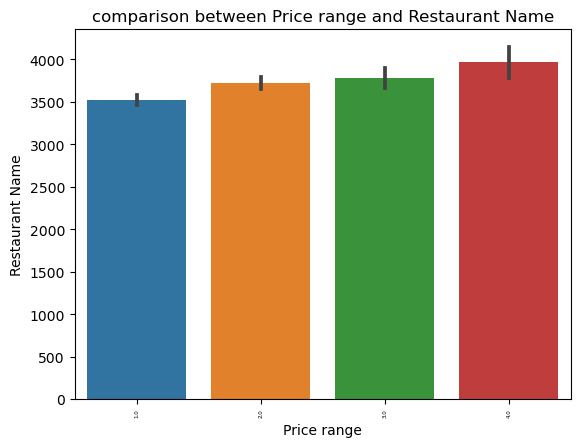

<Figure size 2800x200 with 0 Axes>

In [134]:
plt.title("comparison between Price range and Restaurant Name")
sns.barplot(x= "Price range", y= "Restaurant Name", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

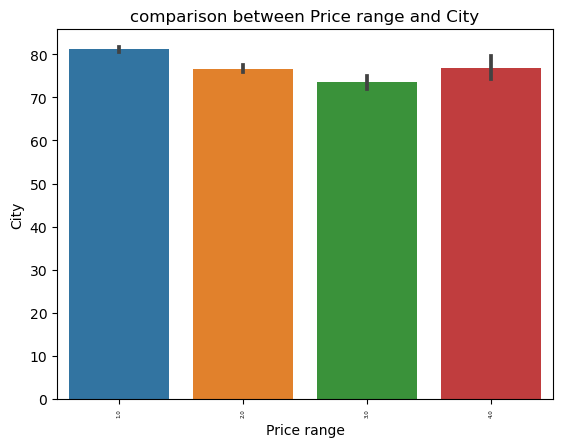

<Figure size 2800x200 with 0 Axes>

In [135]:
plt.title("comparison between Price range and City")
sns.barplot(x= "Price range", y= "City", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

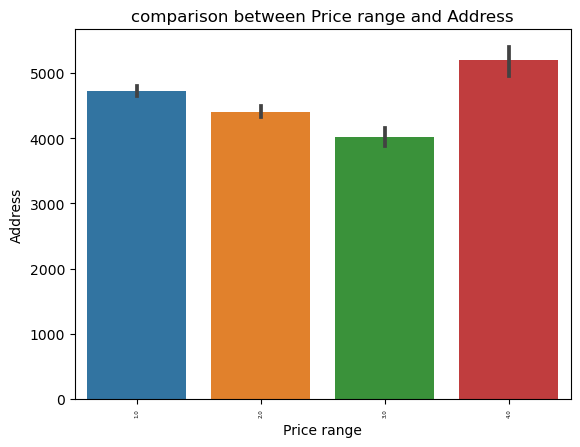

<Figure size 2800x200 with 0 Axes>

In [136]:
plt.title("comparison between Price range and Address")
sns.barplot(x= "Price range", y= "Address", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the addresses lies in price range number 4.

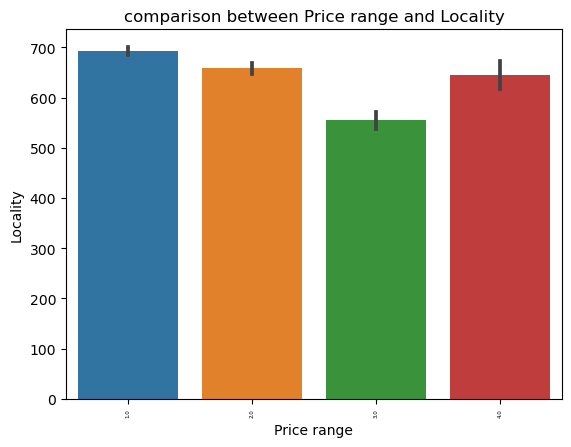

<Figure size 2800x200 with 0 Axes>

In [137]:
plt.title("comparison between Price range and Locality")
sns.barplot(x= "Price range", y= "Locality", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

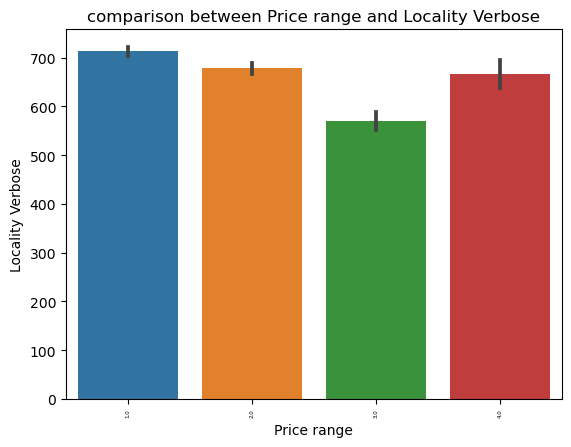

<Figure size 2800x200 with 0 Axes>

In [138]:
plt.title("comparison between Price range and Locality Verbose")
sns.barplot(x= "Price range", y= "Locality Verbose", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

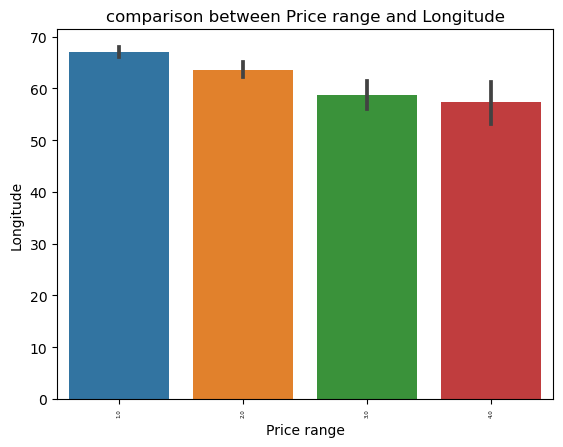

<Figure size 2800x200 with 0 Axes>

In [139]:
plt.title("comparison between Price range and Longitude")
sns.barplot(x= "Price range", y= "Longitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the longitudes lies in the price range 1

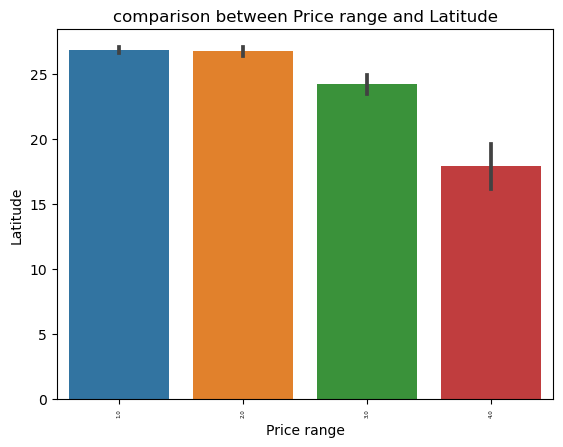

<Figure size 2800x200 with 0 Axes>

In [140]:
plt.title("comparison between Price range and Latitude")
sns.barplot(x= "Price range", y= "Latitude", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the latitude values lies in the price range 1.

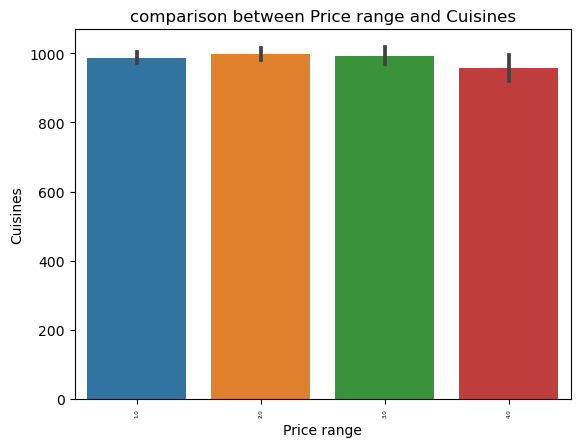

<Figure size 2800x200 with 0 Axes>

In [141]:
plt.title("comparison between Price range and Cuisines")
sns.barplot(x= "Price range", y= "Cuisines", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

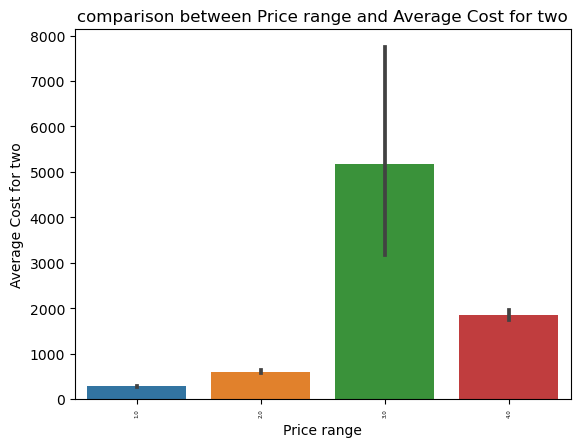

<Figure size 2800x200 with 0 Axes>

In [142]:
plt.title("comparison between Price range and Average Cost for two")
sns.barplot(x= "Price range", y= "Average Cost for two", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the average cost for two lies in the price range number 3.

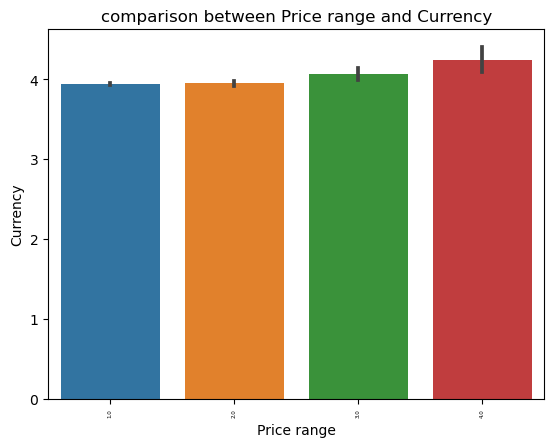

<Figure size 2800x200 with 0 Axes>

In [143]:
plt.title("comparison between Price range and Currency")
sns.barplot(x= "Price range", y= "Currency", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statement can be derived from the above plot.

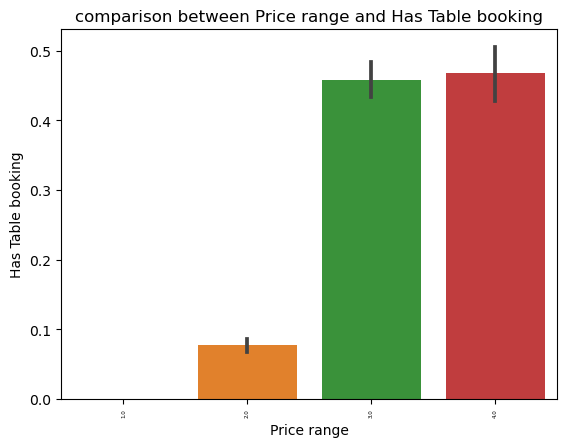

<Figure size 2800x200 with 0 Axes>

In [144]:
plt.title("comparison between Price range and Has Table booking")
sns.barplot(x= "Price range", y= "Has Table booking", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the people who has table booking lies in the price range 3 and 4. 

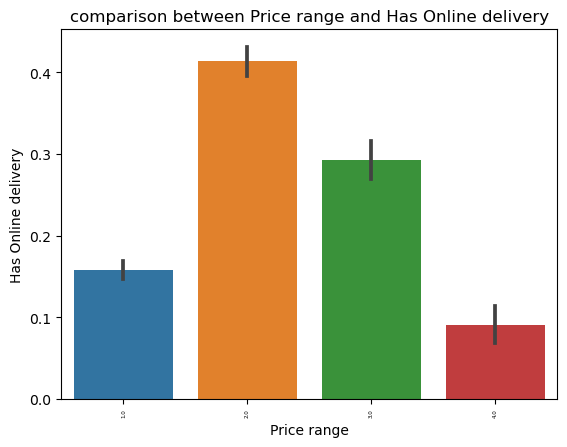

<Figure size 2800x200 with 0 Axes>

In [145]:
plt.title("comparison between Price range and Has Online delivery")
sns.barplot(x= "Price range", y= "Has Online delivery", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the people who has online delivery lies in the price range 2.

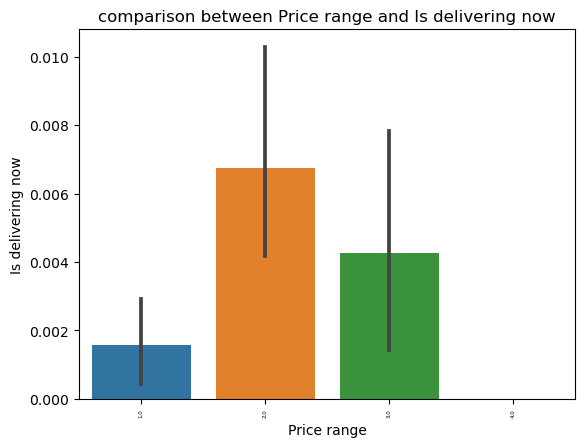

<Figure size 2800x200 with 0 Axes>

In [146]:
plt.title("comparison between Price range and Is delivering now")
sns.barplot(x= "Price range", y= "Is delivering now", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the people who is delivering now lies in the price range 2.0.

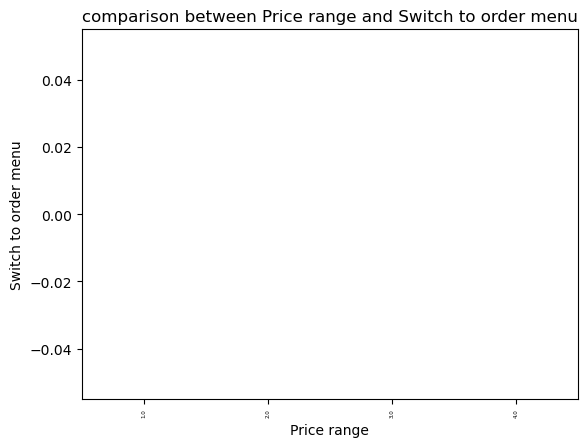

<Figure size 2800x200 with 0 Axes>

In [147]:
plt.title("comparison between Price range and Switch to order menu")
sns.barplot(x= "Price range", y= "Switch to order menu", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

In [ ]:
no conclusive statement can be derived from the above plot.

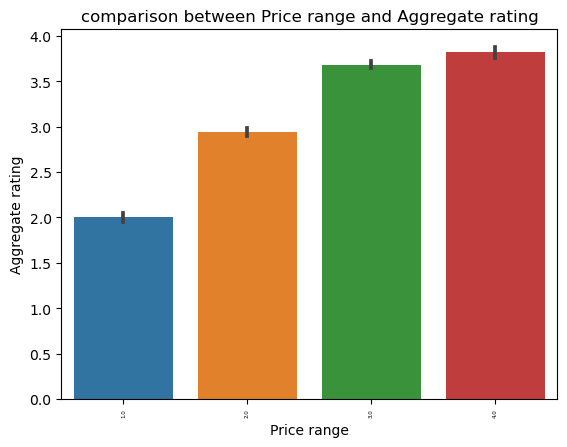

<Figure size 2800x200 with 0 Axes>

In [148]:
plt.title("comparison between Price range and Aggregate rating")
sns.barplot(x= "Price range", y= "Aggregate rating", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the aggregate rating lies in the price 3 and 4.

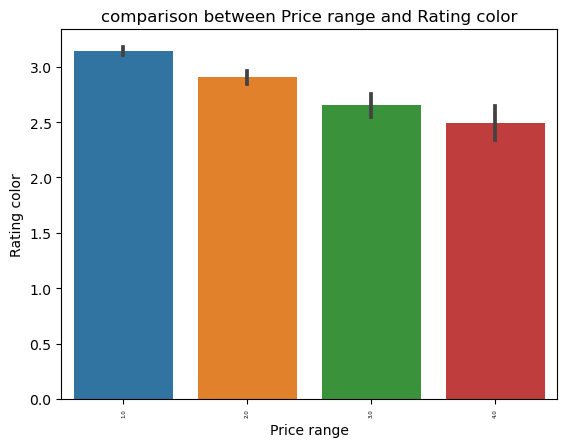

<Figure size 2800x200 with 0 Axes>

In [149]:
plt.title("comparison between Price range and Rating color")
sns.barplot(x= "Price range", y= "Rating color", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the rating color lies in the price range number 1 

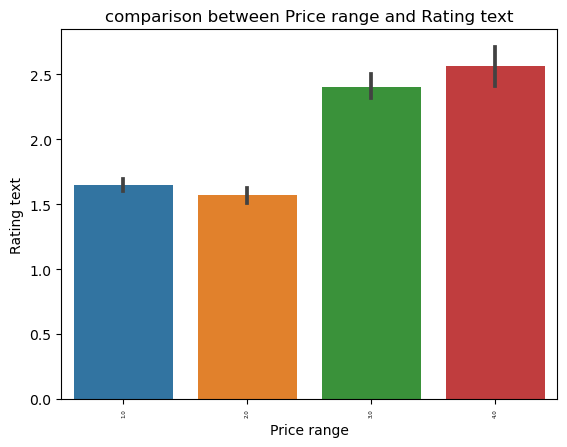

<Figure size 2800x200 with 0 Axes>

In [150]:
plt.title("comparison between Price range and Rating text")
sns.barplot(x= "Price range", y= "Rating text", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the rating text lies in the price range 4.0.

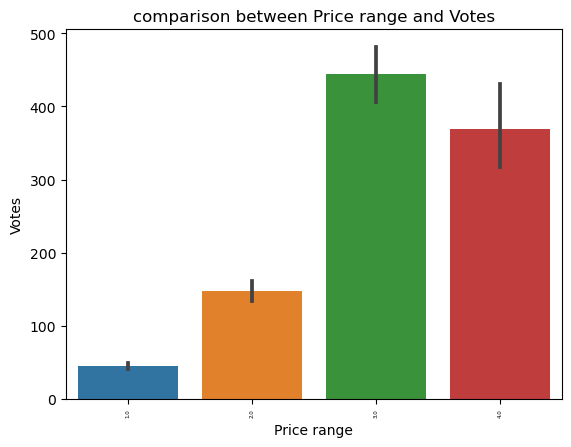

<Figure size 2800x200 with 0 Axes>

In [151]:
plt.title("comparison between Price range and Votes")
sns.barplot(x= "Price range", y= "Votes", data =zomato_data)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the votes lies in the price range 3.0.

In [ ]:
Catplots

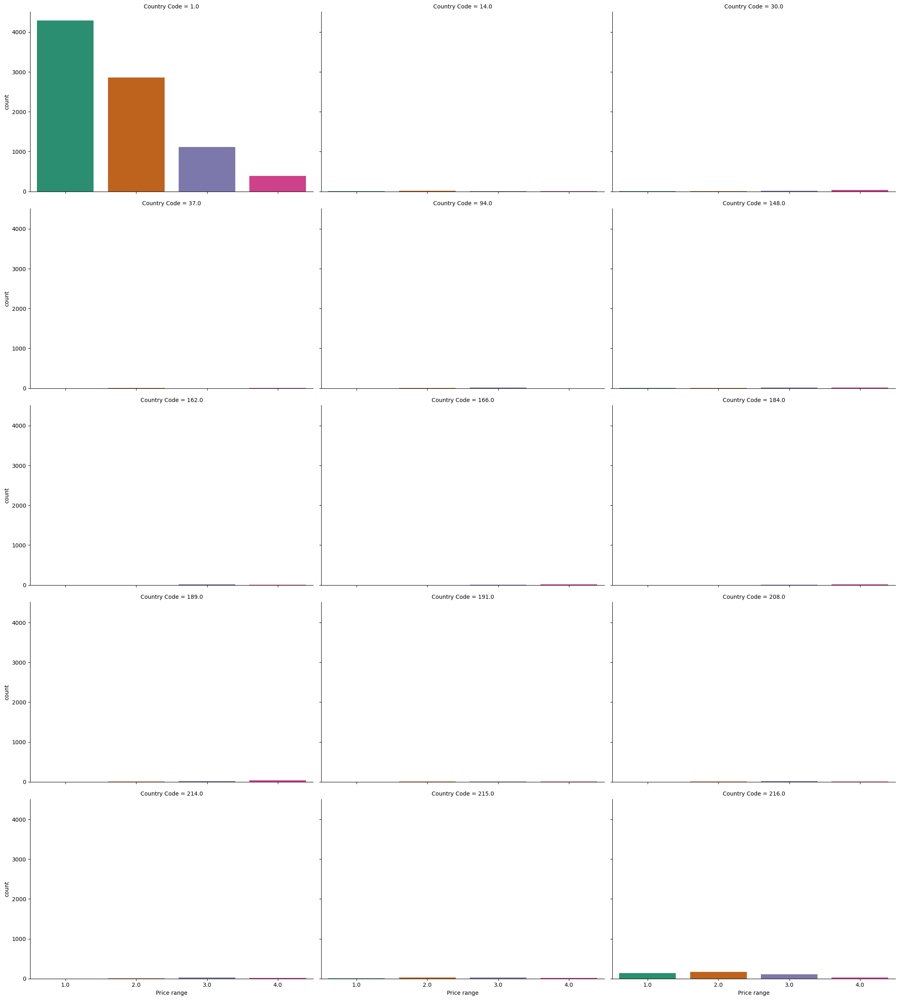

<Figure size 200x200 with 0 Axes>

In [152]:
sns.catplot(x= 'Price range', col= 'Country Code', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of points lie in country code 1.0.

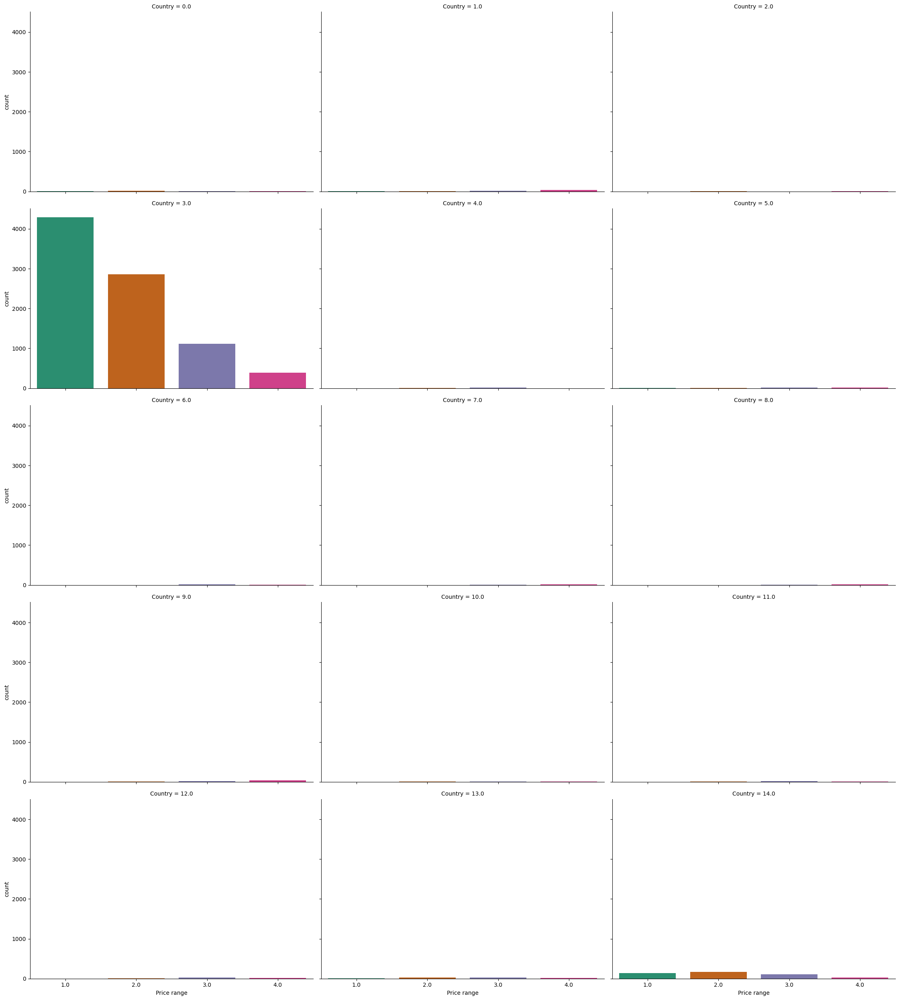

<Figure size 200x200 with 0 Axes>

In [153]:
sns.catplot(x= 'Price range', col= 'Country', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the poeople lie in the country number 3.0.

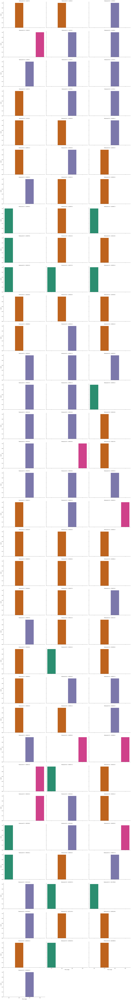

<Figure size 200x200 with 0 Axes>

In [155]:
sns.catplot(x= 'Price range', col= 'Restaurant ID', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

no conclusive statement can be derived from the above plot.

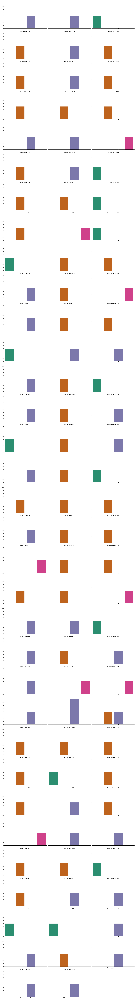

<Figure size 200x200 with 0 Axes>

In [156]:
sns.catplot(x= 'Price range', col= 'Restaurant Name', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

In [ ]:
no conclusive statement can be derived from the above plot.

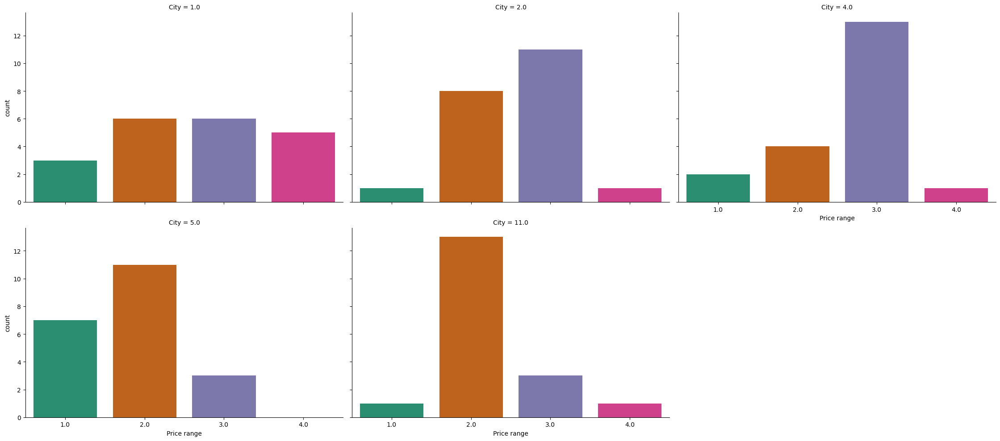

<Figure size 200x200 with 0 Axes>

In [157]:
sns.catplot(x= 'Price range', col= 'City', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

price range 3 is high in city 2 and 4, wheras price range 2 is high in city 4 and 11.  

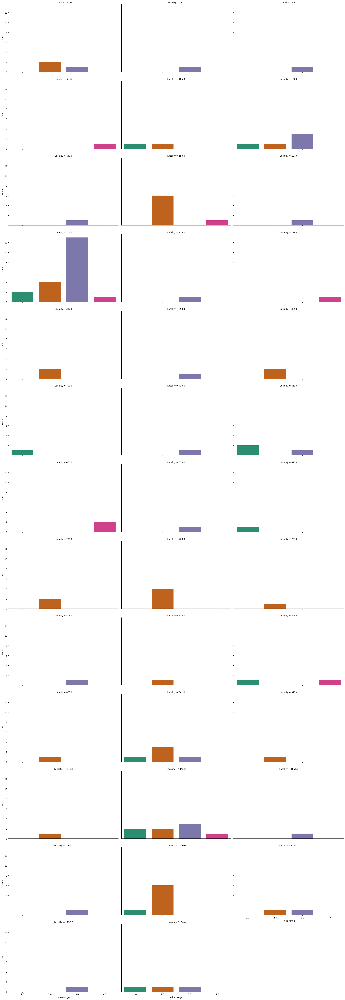

<Figure size 200x200 with 0 Axes>

In [158]:
sns.catplot(x= 'Price range', col= 'Locality', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the dots lies in locality 204.0.

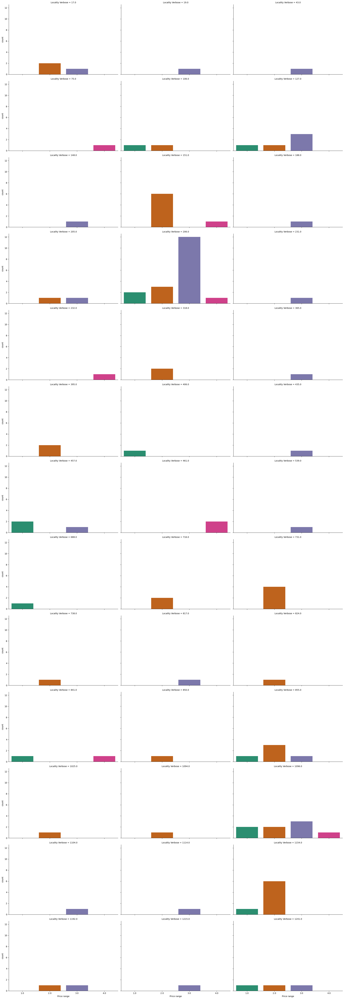

<Figure size 200x200 with 0 Axes>

In [159]:
sns.catplot(x= 'Price range', col= 'Locality Verbose', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range points lie in locality verbose 206.0

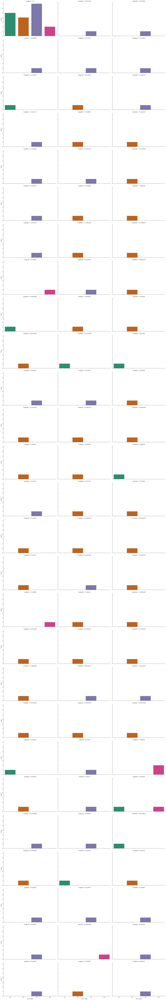

<Figure size 200x200 with 0 Axes>

In [160]:
sns.catplot(x= 'Price range', col= 'Longitude', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of price range points lie in longitude 0.0.

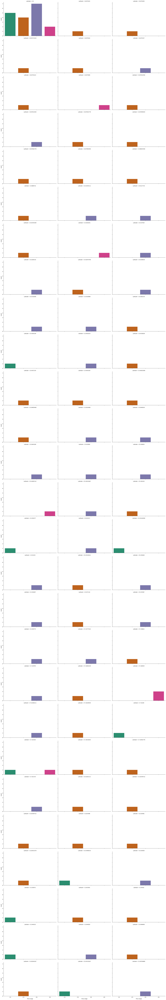

<Figure size 200x200 with 0 Axes>

In [161]:
sns.catplot(x= 'Price range', col= 'Latitude', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range data points lies in latitude 0.0

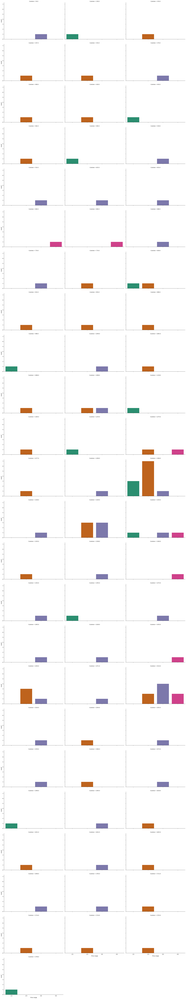

<Figure size 200x200 with 0 Axes>

In [162]:
sns.catplot(x= 'Price range', col= 'Cuisines', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range points lies in cusines 1306.

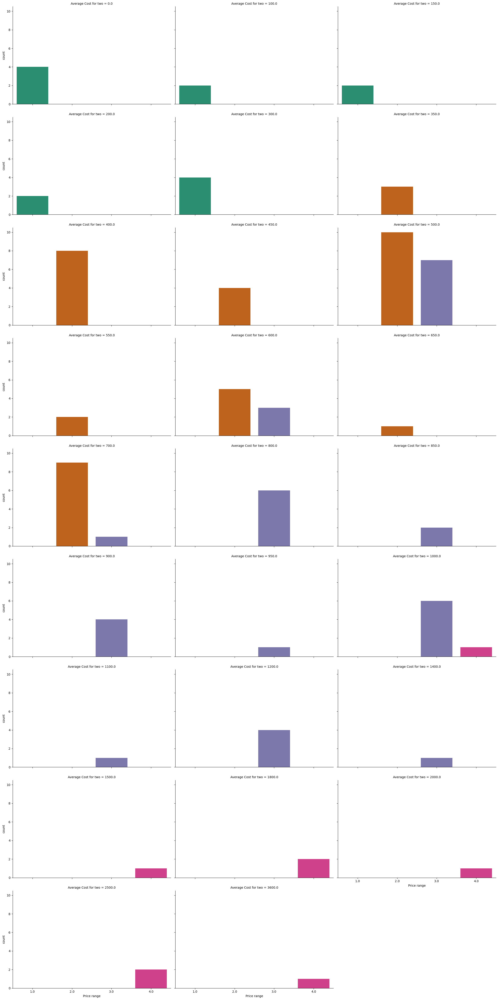

<Figure size 200x200 with 0 Axes>

In [163]:
sns.catplot(x= 'Price range', col= 'Average Cost for two', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range lies in average cost for two= 500.

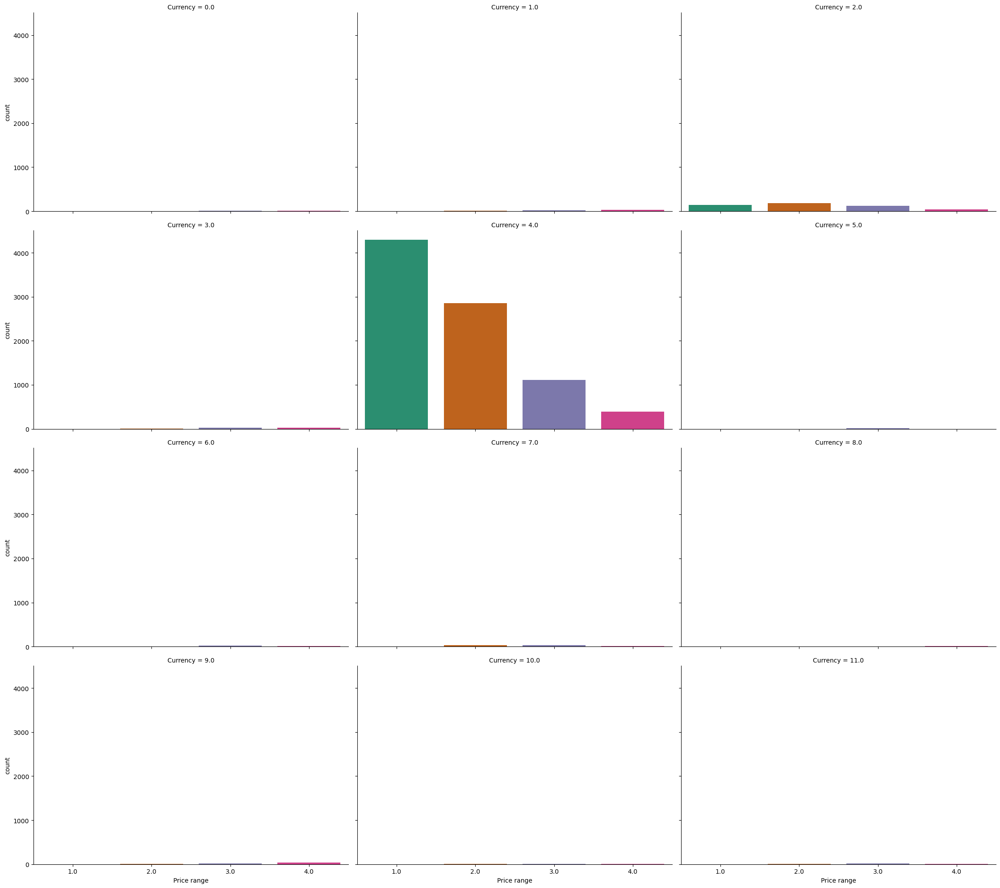

<Figure size 200x200 with 0 Axes>

In [165]:
sns.catplot(x= 'Price range', col= 'Currency', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range point lies currency 4.0.

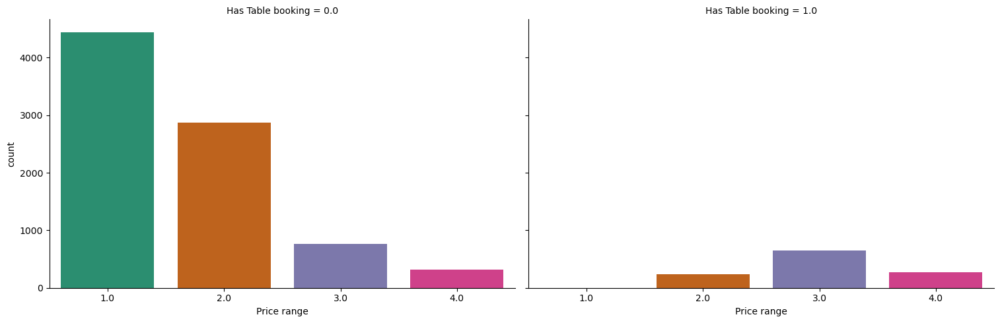

<Figure size 200x200 with 0 Axes>

In [166]:
sns.catplot(x= 'Price range', col= 'Has Table booking', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range were not for table booking.

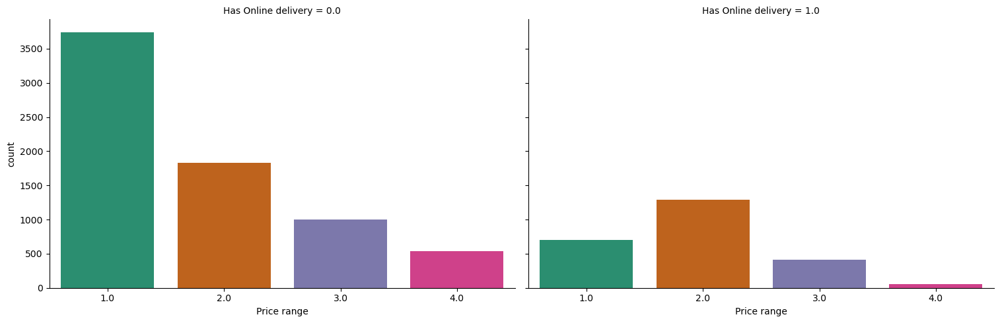

<Figure size 200x200 with 0 Axes>

In [167]:
sns.catplot(x= 'Price range', col= 'Has Online delivery', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range points did not have online delivery.

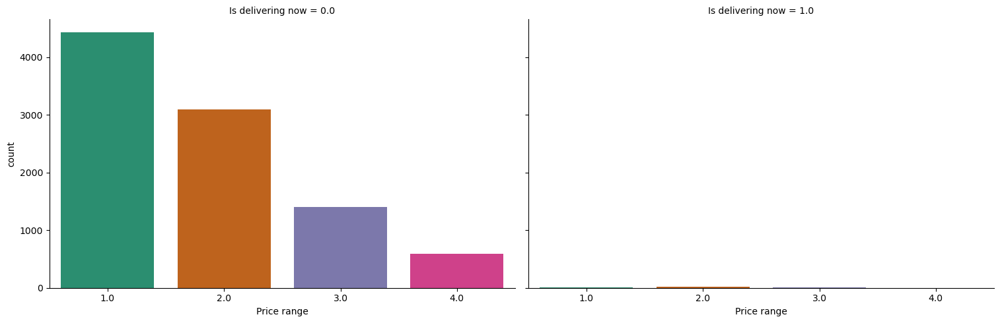

<Figure size 200x200 with 0 Axes>

In [168]:
sns.catplot(x= 'Price range', col= 'Is delivering now', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range points lies in not deliveing now.

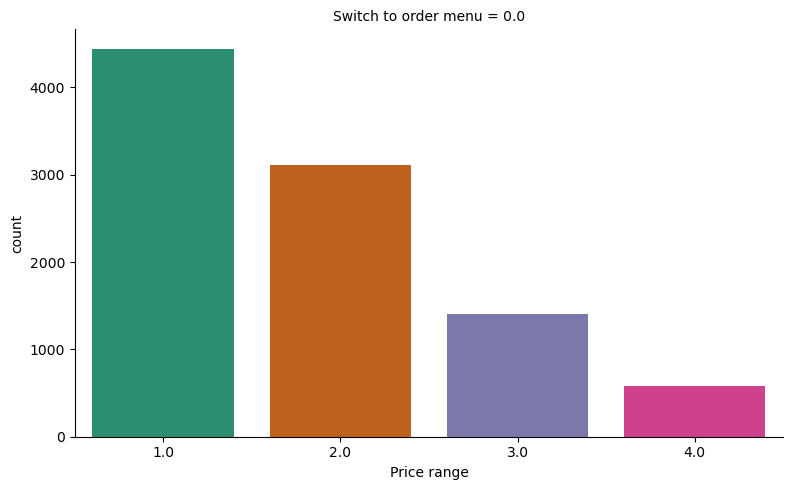

<Figure size 200x200 with 0 Axes>

In [169]:
sns.catplot(x= 'Price range', col= 'Switch to order menu', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

In [ ]:
most of the price range 1.0 switched to order menu.

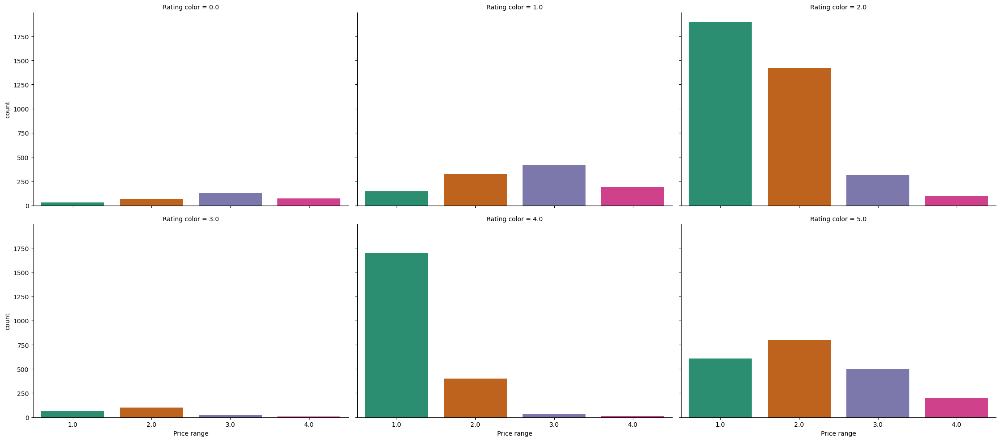

<Figure size 200x200 with 0 Axes>

In [170]:
sns.catplot(x= 'Price range', col= 'Rating color', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the rating color lies in 2.0.

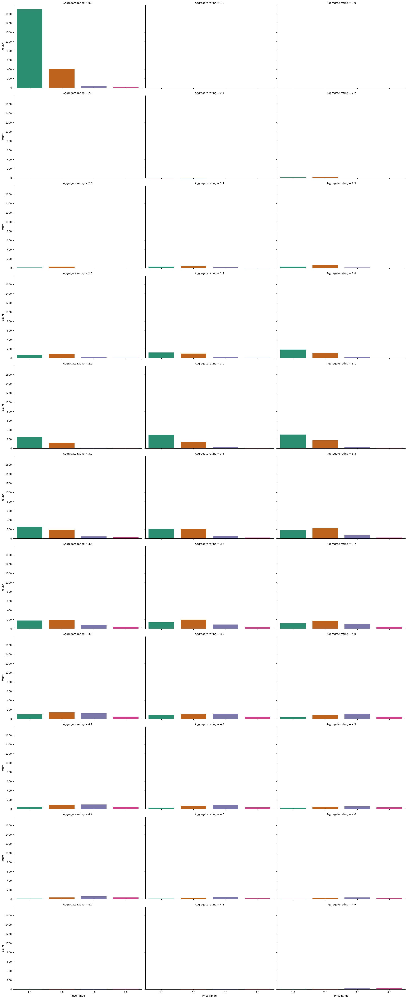

<Figure size 200x200 with 0 Axes>

In [171]:
sns.catplot(x= 'Price range', col= 'Aggregate rating', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the aggregate rating lies in 0.0.

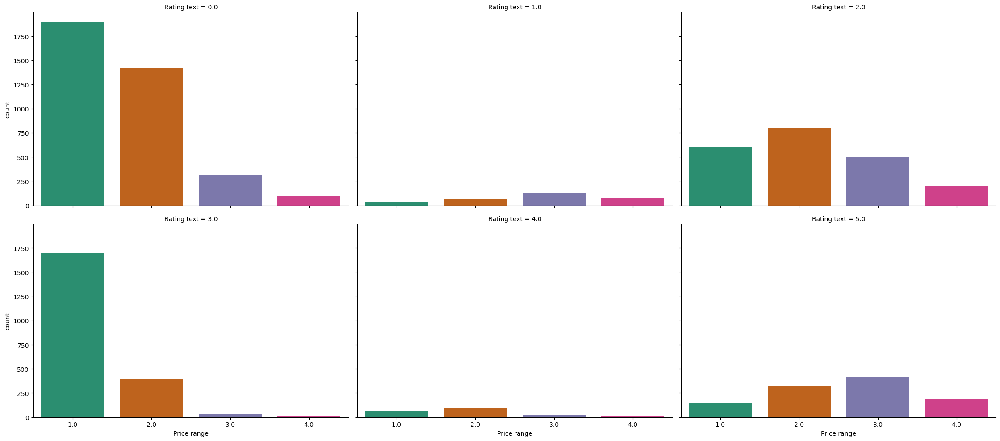

<Figure size 200x200 with 0 Axes>

In [172]:
sns.catplot(x= 'Price range', col= 'Rating text', data = zomato_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the rating text lies in 0.0.

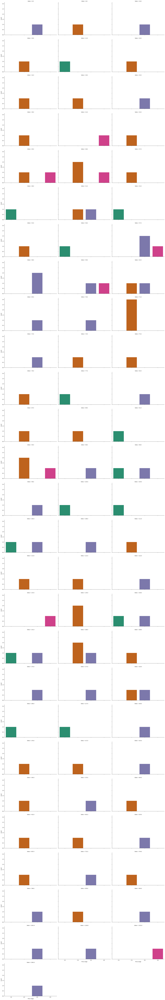

<Figure size 200x200 with 0 Axes>

In [174]:
sns.catplot(x= 'Price range', col= 'Votes', data = zomato_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)
plt.figure(figsize=(2,2))
plt.show()

most of the price range 2.0 lies in votes 71.0.

Multivariate analysis

Pairplots

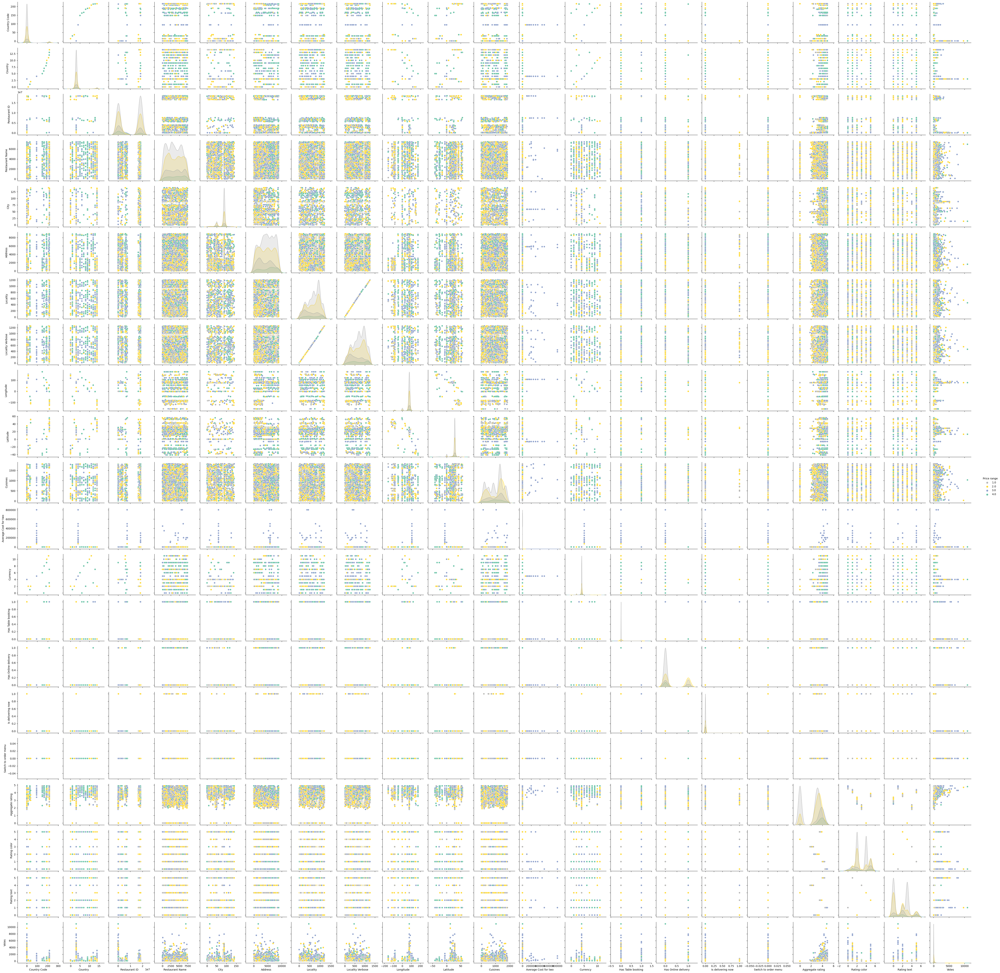

In [88]:
sns.pairplot(zomato_data,hue='Price range',palette="Set2_r")
plt.show()

locality and locality verbose have positive correlation with each other.
rest of the variables have little or no correlation at all.

In [ ]:
Distribution plot= output column

C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_16988\4265597410.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(zomato_data['Price range'],color="b", kde_kws={"shade":True}, hist=False)
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\distributions.py:2511: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  kdeplot(**{axis: a}, ax=ax, color=kde_color, **kde_kws)


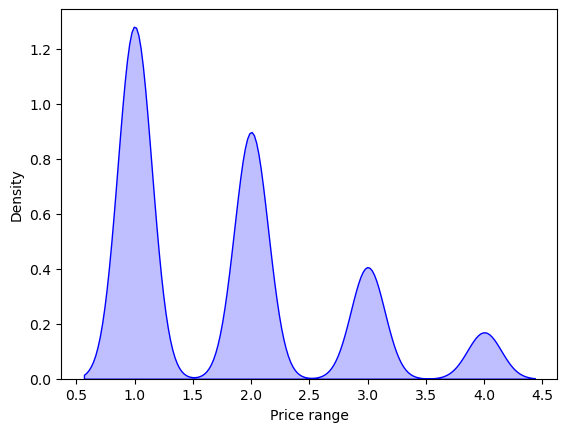

In [178]:
sns.distplot(zomato_data['Price range'],color="b", kde_kws={"shade":True}, hist=False)
plt.show()

most of the price range points is skewed to the left.

lets convert all the values in the database into float values using the ordinal encoding method.

In [179]:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in zomato_data.columns:
    if zomato_data[i].dtypes=='int64':
        zomato_data[i]=OE.fit_transform(zomato_data[i].values.reshape(-1,1))
zomato_data

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1.0,3.0,3400025.0,3201.0,1.0,4553.0,17.0,17.0,78.011544,27.161661,...,4.0,0.0,0.0,0.0,0.0,3.0,3.9,5.0,2.0,5.192494
1,1.0,3.0,3400341.0,5261.0,1.0,4605.0,17.0,17.0,0.000000,0.000000,...,4.0,0.0,0.0,0.0,0.0,2.0,3.5,5.0,2.0,4.140818
2,1.0,3.0,3400005.0,6919.0,1.0,6234.0,17.0,17.0,78.011608,27.160832,...,4.0,0.0,0.0,0.0,0.0,2.0,3.6,5.0,2.0,4.546836
3,1.0,3.0,3400021.0,1637.0,1.0,100.0,204.0,205.0,77.998092,27.195928,...,4.0,0.0,0.0,0.0,0.0,2.0,4.0,1.0,5.0,4.431048
4,1.0,3.0,3400017.0,4922.0,1.0,1316.0,204.0,205.0,78.007553,27.201725,...,4.0,0.0,0.0,0.0,0.0,3.0,4.2,1.0,5.0,5.614672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,14.0,17697389.0,6794.0,135.0,1279.0,1174.0,1231.0,-92.335523,42.498400,...,2.0,0.0,0.0,0.0,0.0,1.0,3.7,5.0,2.0,4.657010
9547,216.0,14.0,17697424.0,6839.0,135.0,2667.0,1174.0,1231.0,-92.335769,42.497919,...,2.0,0.0,0.0,0.0,0.0,1.0,3.5,5.0,2.0,3.870877
9548,216.0,14.0,17697332.0,6945.0,135.0,957.0,1174.0,1231.0,-92.323400,42.465580,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,5.383213
9549,216.0,14.0,17694056.0,6883.0,136.0,1910.0,1176.0,1233.0,-80.529488,40.396043,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,5.383213


lets sort the correlation based on the output column

In [181]:
correlation['Price range'].sort_values(ascending = False)

Price range             1.000000
Votes                   0.519227
Has Table booking       0.501925
Average Cost for two    0.449487
Aggregate rating        0.437944
Country Code            0.243327
Country                 0.178035
Rating text             0.164242
Has Online delivery     0.077918
Currency                0.075179
Restaurant Name         0.061275
Is delivering now       0.010940
Cuisines               -0.005489
Address                -0.034952
Longitude              -0.078939
City                   -0.105759
Locality Verbose       -0.112313
Locality               -0.114459
Restaurant ID          -0.134540
Rating color           -0.140468
Latitude               -0.166688
Switch to order menu         NaN
Name: Price range, dtype: float64

In [ ]:
lets visualise it using the boxplots

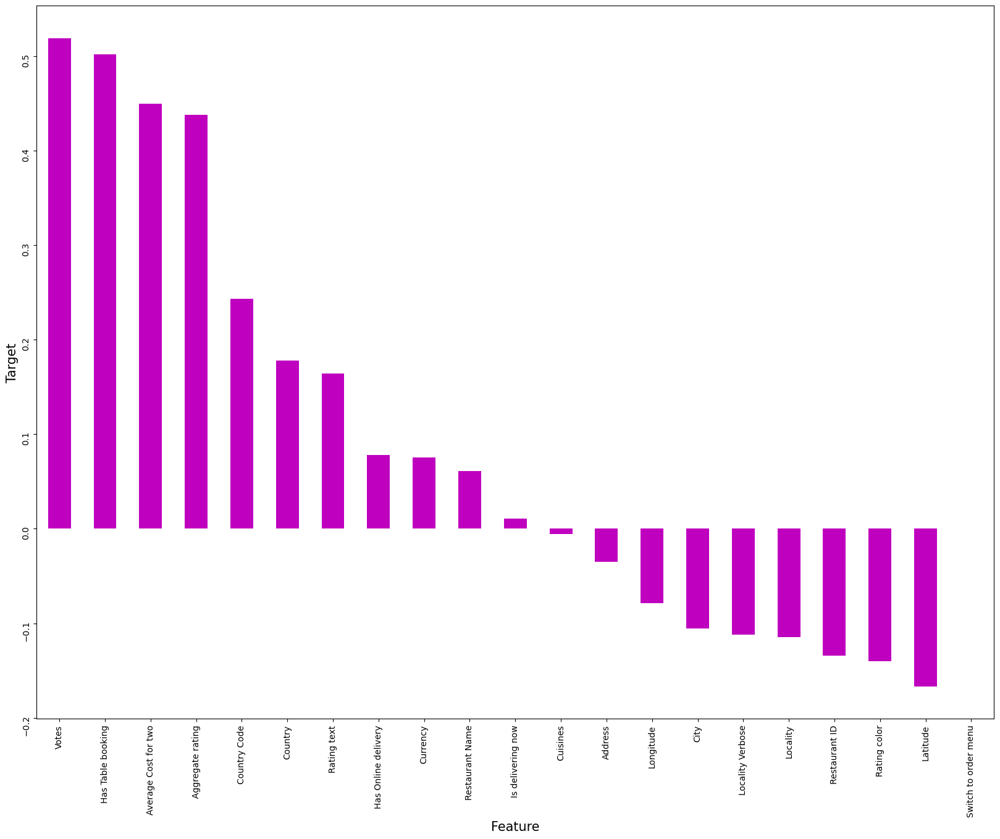

In [182]:
plt.figure(figsize = (20,15))
correlation['Price range'].sort_values(ascending=False).drop(['Price range']).plot(kind='bar',color="m")
plt.xlabel('Feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.yticks(rotation=90);
plt.show()

lets declare the x and y variable for our task number 2.

In [183]:
x = zomato_data.drop("Price range", axis=1)
y = zomato_data["Price range"]

lets scale it using the standard scaler 

In [184]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Aggregate rating,Rating color,Rating text,Votes
0,-0.306015,-0.277839,-0.642824,-0.211034,-3.332289,0.004116,-2.029851,-1.990609,0.334861,0.118764,...,0.481021,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.813580,1.371170,0.124686,0.564373
1,-0.306015,-0.277839,-0.642788,0.750323,-3.332289,0.024385,-2.029851,-1.990609,-1.546527,-2.348827,...,0.314548,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.549780,1.371170,0.124686,0.184617
2,-0.306015,-0.277839,-0.642826,1.524074,-3.332289,0.659328,-2.029851,-1.990609,0.334862,0.118689,...,0.050376,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.615730,1.371170,0.124686,0.331228
3,-0.306015,-0.277839,-0.642824,-0.940918,-3.332289,-1.731552,-1.437798,-1.423849,0.334536,0.121877,...,-0.109171,0.024395,-0.371446,-0.587547,-0.059771,0.0,0.879530,-1.308053,1.895070,0.289418
4,-0.306015,-0.277839,-0.642825,0.592119,-3.332289,-1.257585,-1.437798,-1.423849,0.334765,0.122404,...,0.628895,0.024395,-0.371446,-0.587547,-0.059771,0.0,1.011430,-1.308053,1.895070,0.716820
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,3.482693,3.870249,0.983529,1.465740,2.444146,-1.272007,1.633280,1.669214,-3.773364,1.512081,...,-1.571212,-2.163326,-0.371446,-0.587547,-0.059771,0.0,0.681680,1.371170,0.124686,0.371012
9547,3.482693,3.870249,0.983533,1.486740,2.444146,-0.730999,1.633280,1.669214,-3.773370,1.512037,...,-1.571212,-2.163326,-0.371446,-0.587547,-0.059771,0.0,0.549780,1.371170,0.124686,0.087142
9548,3.482693,3.870249,0.983522,1.536208,2.444146,-1.397515,1.633280,1.669214,-3.773071,1.509099,...,-1.355400,-2.163326,-0.371446,-0.587547,-0.059771,0.0,0.813580,1.371170,0.124686,0.633240
9549,3.482693,3.870249,0.983150,1.507274,2.487254,-1.026059,1.639612,1.675243,-3.488640,1.321086,...,-1.355400,-2.163326,-0.371446,-0.587547,-0.059771,0.0,0.813580,1.371170,0.124686,0.633240


Variance Inflation Factor

In [185]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

C:\ProgramData\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1754: RuntimeWarning: invalid value encountered in scalar divide
  return 1 - self.ssr/self.uncentered_tss


,VIF values,Features
0,46.792705,Country Code
1,66.142084,Country
2,1.413843,Restaurant ID
3,1.007848,Restaurant Name
4,1.087252,City
5,1.120519,Address
6,955.333000,Locality
7,954.301382,Locality Verbose
8,5.118918,Longitude
9,3.071353,Latitude


Due to low correlation or very high vif values, the following columns will be removed from our dataframe- 'Switch to order menu','Locality Verbose','Locality','Country','Country Code','Rating text','Has Online delivery','Currency','Restaurant Name','Is delivering now','Cuisines','Address','Longitude','City'

In [186]:
columns_with_low_corelation_and_high_VIF = ['Switch to order menu','Locality Verbose','Locality','Country','Country Code','Rating text','Has Online delivery','Currency','Restaurant Name','Is delivering now','Cuisines','Address','Longitude','City']
zomato_data = zomato_data.drop(columns=columns_with_low_corelation_and_high_VIF)

now lets repeat the above process until we get the new vif values of our new dataframe

In [187]:
x = zomato_data.drop("Price range", axis=1)
y = zomato_data["Price range"]

In [188]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,Restaurant ID,Latitude,Average Cost for two,Has Table booking,Aggregate rating,Rating color,Votes
0,-0.642824,0.118764,0.481021,-0.371446,0.813580,1.371170,0.564373
1,-0.642788,-2.348827,0.314548,-0.371446,0.549780,1.371170,0.184617
2,-0.642826,0.118689,0.050376,-0.371446,0.615730,1.371170,0.331228
3,-0.642824,0.121877,-0.109171,-0.371446,0.879530,-1.308053,0.289418
4,-0.642825,0.122404,0.628895,-0.371446,1.011430,-1.308053,0.716820
...,...,...,...,...,...,...,...
9546,0.983529,1.512081,-1.571212,-0.371446,0.681680,1.371170,0.371012
9547,0.983533,1.512037,-1.571212,-0.371446,0.549780,1.371170,0.087142
9548,0.983522,1.509099,-1.355400,-0.371446,0.813580,1.371170,0.633240
9549,0.983150,1.321086,-1.355400,-0.371446,0.813580,1.371170,0.633240


In [189]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,1.152130,Restaurant ID
1,1.030071,Latitude
2,1.202947,Average Cost for two
3,1.212091,Has Table booking
4,2.339746,Aggregate rating
5,1.165567,Rating color
6,2.257115,Votes


the vif values are corrected.

now lets balance the y value counts using the SMOTE analysis.

In [190]:
y.value_counts()

1.0    4444
2.0    3113
3.0    1408
4.0     586
Name: Price range, dtype: int64

In [191]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x1,y1 = SM.fit_resample(x,y)

In [192]:
y1.value_counts()

3.0    4444
2.0    4444
4.0    4444
1.0    4444
Name: Price range, dtype: int64

z-scores

In [194]:
from scipy.stats import zscore
out_features=zomato_data[['Restaurant ID', 'Latitude', 'Average Cost for two', 'Has Table booking', 'Aggregate rating','Rating color','Votes']]
z=np.abs(zscore(out_features))
z

,Restaurant ID,Latitude,Average Cost for two,Has Table booking,Aggregate rating,Rating color,Votes
0,0.642824,0.118764,0.481021,0.371446,0.813580,1.371170,0.564373
1,0.642788,2.348827,0.314548,0.371446,0.549780,1.371170,0.184617
2,0.642826,0.118689,0.050376,0.371446,0.615730,1.371170,0.331228
3,0.642824,0.121877,0.109171,0.371446,0.879530,1.308053,0.289418
4,0.642825,0.122404,0.628895,0.371446,1.011430,1.308053,0.716820
...,...,...,...,...,...,...,...
9546,0.983529,1.512081,1.571212,0.371446,0.681680,1.371170,0.371012
9547,0.983533,1.512037,1.571212,0.371446,0.549780,1.371170,0.087142
9548,0.983522,1.509099,1.355400,0.371446,0.813580,1.371170,0.633240
9549,0.983150,1.321086,1.355400,0.371446,0.813580,1.371170,0.633240


lets get the z score of all the rows is above 3/-3

In [195]:
np.where(z>3)

(array([ 102,  103,  104,  107,  111,  112,  115,  119,  181,  189,  190,
         191,  197,  200,  523,  539,  623,  624,  628,  629,  632,  634,
         840,  930,  931, 1237, 1242, 1676, 1678, 1680, 1683, 1687, 1690,
        1778, 1782, 1785, 1786, 1787, 1788, 1789, 1790, 1856, 1859, 1861,
        1864, 1866, 1868, 1871, 2011, 2384, 2389, 2392, 2394, 2402, 2404,
        2417, 2425, 2431, 2432, 2433, 2436, 2444, 2451, 2459, 2461, 2469,
        2470, 2471, 2477, 2483, 2486, 2488, 2491, 2492, 2493, 2495, 2692,
        2695, 2712, 2814, 2965, 2975, 2977, 3352, 3359, 3360, 3362, 3368,
        3369, 3370, 3463, 3463, 3464, 3554, 3696, 4014, 4025, 4049, 4383,
        4402, 5520, 5693, 6077, 6088, 6224, 6409, 6463, 6919, 7239, 7810,
        8533, 8543, 8652, 8653, 8654, 8655, 8656, 8657, 8658, 8659, 8660,
        8661, 8662, 8663, 8664, 8665, 8666, 8667, 8668, 8669, 8670, 8671,
        8672, 8673, 8674, 8675, 8676, 8677, 8678, 8679, 8680, 8681, 8682,
        8683, 8684, 8685, 8686, 8687, 

now lets check the new shape of our dataframe after removing the rows with z score above 3/-3

In [196]:
zomato_data_new=zomato_data[(z<3).all(axis=1)]
zomato_data_new.shape

(9224, 8)

now lets check the data loss percentage after removal of all the rows

In [197]:
data_loss_percentage = ((zomato_data.shape[0] - zomato_data_new.shape[0]) / zomato_data.shape[0]) * 100
print("Data Loss Percentage:", data_loss_percentage)

Data Loss Percentage: 3.423725264370223


the data loss percentage is within the limits, now lets declare the x and y variable of our new dataframe and balance it using the SMOTE analysis.

In [198]:
x = zomato_data_new.drop("Price range", axis=1)
y = zomato_data_new["Price range"]

In [199]:
y.value_counts()

1.0    4431
2.0    3059
3.0    1266
4.0     468
Name: Price range, dtype: int64

In [200]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x1,y1 = SM.fit_resample(x,y)

In [201]:
y1.value_counts()

3.0    4431
2.0    4431
4.0    4431
1.0    4431
Name: Price range, dtype: int64

Predictions

In [202]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, accuracy_score

lets find the best accuracy score using the random forest classifier with train test split of 70-30

In [203]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
maxaccuracy = 0
maxrandomstate = 0
for i in range(1,200):
      x_train,x_test,y_train,y_test = train_test_split(x1,y1, test_size = 0.30, random_state=i)
      RFC = RandomForestClassifier()
      RFC.fit(x_train,y_train)
pred=RFC.predict(x_test)
acc = accuracy_score(y_test, pred)
if acc>maxaccuracy:
    maxaccuracy=acc
    maxrandomstate=i
print("the best accuracy score",maxaccuracy,"at the following random state",maxrandomstate)

the best accuracy score 0.9827002632568634 at the following random state 199


we got the best accuracy score of 0.9827002632568634 at the following random state 199

lets train the model using the maximum random state with a test sixe 70-30.

In [204]:
x_train,x_test,y_train,y_test = train_test_split(x1,y1, test_size = 0.30, random_state=maxrandomstate)

We will be using the following classifiers= RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, Support Vector Classifier, KNN Neighbours classifier, Decision Trees Classifier and Logistic Regression.

In [205]:
RFC = RandomForestClassifier()
RFC.fit(x_train,y_train)
pred=RFC.predict(x_test)
print(accuracy_score(y_test, pred))
print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

0.9823241820233171
[[1396   16    0    1]
 [   5 1221   18    1]
 [   0   17 1277   12]
 [   0    2   22 1330]]
              precision    recall  f1-score   support

         1.0       1.00      0.99      0.99      1413
         2.0       0.97      0.98      0.98      1245
         3.0       0.97      0.98      0.97      1306
         4.0       0.99      0.98      0.99      1354

    accuracy                           0.98      5318
   macro avg       0.98      0.98      0.98      5318
weighted avg       0.98      0.98      0.98      5318



Random Forest Classifier gives an accuracy score of 0.9823241820233171 gives a precision, recall and f1 score ranging from 0.99 to 1.00

In [206]:
LogReg = LogisticRegression(max_iter=6000)
LogReg.fit(x_train,y_train)
predLogReg=LogReg.predict(x_test)
print(accuracy_score(y_test, predLogReg))
print(confusion_matrix(y_test,predLogReg))
print(classification_report(y_test,predLogReg))

0.2657013915005641
[[1413    0    0    0]
 [1245    0    0    0]
 [1306    0    0    0]
 [1354    0    0    0]]
              precision    recall  f1-score   support

         1.0       0.27      1.00      0.42      1413
         2.0       0.00      0.00      0.00      1245
         3.0       0.00      0.00      0.00      1306
         4.0       0.00      0.00      0.00      1354

    accuracy                           0.27      5318
   macro avg       0.07      0.25      0.10      5318
weighted avg       0.07      0.27      0.11      5318



C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Logistic Regression gives an accuracy score of 0.2657013915005641 gives a precision, recall and f1 score ranging from 0.42 to 1.00

In [207]:
GradBoos = GradientBoostingClassifier()
GradBoos.fit(x_train,y_train)
predGradBoos=GradBoos.predict(x_test)
print(accuracy_score(y_test, predGradBoos))
print(confusion_matrix(y_test,predGradBoos))
print(classification_report(y_test,predGradBoos))

0.9708537044001504
[[1401    8    0    4]
 [   7 1224   11    3]
 [   1   35 1242   28]
 [   2    4   52 1296]]
              precision    recall  f1-score   support

         1.0       0.99      0.99      0.99      1413
         2.0       0.96      0.98      0.97      1245
         3.0       0.95      0.95      0.95      1306
         4.0       0.97      0.96      0.97      1354

    accuracy                           0.97      5318
   macro avg       0.97      0.97      0.97      5318
weighted avg       0.97      0.97      0.97      5318



Gradient Boost classification gives an accuracy score of 0.9708537044001504 gives a precision, recall and f1 score ranging from 0.99 to .99

In [208]:
BagClass = BaggingClassifier()
BagClass.fit(x_train,y_train)
predBagClass=BagClass.predict(x_test)
print(accuracy_score(y_test, predBagClass))
print(confusion_matrix(y_test,predBagClass))
print(classification_report(y_test,predBagClass))

0.981383978939451
[[1398    8    4    3]
 [   4 1227   10    4]
 [   0   17 1273   16]
 [   0    6   27 1321]]
              precision    recall  f1-score   support

         1.0       1.00      0.99      0.99      1413
         2.0       0.98      0.99      0.98      1245
         3.0       0.97      0.97      0.97      1306
         4.0       0.98      0.98      0.98      1354

    accuracy                           0.98      5318
   macro avg       0.98      0.98      0.98      5318
weighted avg       0.98      0.98      0.98      5318



Bagging classification gives an accuracy score of 0.981383978939451 gives a precision, recall and f1 score ranging from 0.99 to 1.00

In [209]:
Extrees = ExtraTreesClassifier()
Extrees.fit(x_train,y_train)
predExtrees=Extrees.predict(x_test)
print(accuracy_score(y_test, predExtrees))
print(confusion_matrix(y_test,predExtrees))
print(classification_report(y_test,predExtrees))

0.9821361414065438
[[1391   21    0    1]
 [   4 1215   25    1]
 [   1   14 1282    9]
 [   0    3   16 1335]]
              precision    recall  f1-score   support

         1.0       1.00      0.98      0.99      1413
         2.0       0.97      0.98      0.97      1245
         3.0       0.97      0.98      0.98      1306
         4.0       0.99      0.99      0.99      1354

    accuracy                           0.98      5318
   macro avg       0.98      0.98      0.98      5318
weighted avg       0.98      0.98      0.98      5318



Extra Trees classification gives an accuracy score of 0.9821361414065438 gives a precision, recall and f1 score ranging from 0.98 to 1.00

In [210]:
SVC = SVC()
SVC.fit(x_train,y_train)
predSVC=SVC.predict(x_test)
print(accuracy_score(y_test, predSVC))
print(confusion_matrix(y_test,predSVC))
print(classification_report(y_test,predSVC,zero_division=1))

0.3294471605866867
[[775   1   0 637]
 [538   6   0 701]
 [471  16   0 819]
 [363  20   0 971]]
              precision    recall  f1-score   support

         1.0       0.36      0.55      0.44      1413
         2.0       0.14      0.00      0.01      1245
         3.0       1.00      0.00      0.00      1306
         4.0       0.31      0.72      0.43      1354

    accuracy                           0.33      5318
   macro avg       0.45      0.32      0.22      5318
weighted avg       0.45      0.33      0.23      5318



Support Vector Classifier gives an accuracy score 0.3294471605866867 with a precision, recall and f1 score ranging from 0.36 to 0.44.

In [211]:
AdaBoos = AdaBoostClassifier()
AdaBoos.fit(x_train,y_train)
Adapred=AdaBoos.predict(x_test)
print(accuracy_score(y_test, Adapred))
print(confusion_matrix(y_test,Adapred))
print(classification_report(y_test,Adapred))

0.6423467468973298
[[1383   29    1    0]
 [  16 1184   14   31]
 [   1  556  443  306]
 [   0  413  535  406]]
              precision    recall  f1-score   support

         1.0       0.99      0.98      0.98      1413
         2.0       0.54      0.95      0.69      1245
         3.0       0.45      0.34      0.39      1306
         4.0       0.55      0.30      0.39      1354

    accuracy                           0.64      5318
   macro avg       0.63      0.64      0.61      5318
weighted avg       0.64      0.64      0.62      5318



Adaboost Classifier gives an accuracy score 0.6423467468973298 with a precision, recall and f1 score ranging from 0.98 to 0.99.

In [212]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(x_train, y_train)
pred = knn.predict(x_test)
print("Accuracy Score:", accuracy_score(y_test, pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred))
print("Classification Report:")
print(classification_report(y_test, pred))

Accuracy Score: 0.550582925911997
Confusion Matrix:
[[781 422 154  56]
 [357 622 191  75]
 [226 266 665 149]
 [157 145 192 860]]
Classification Report:
              precision    recall  f1-score   support

         1.0       0.51      0.55      0.53      1413
         2.0       0.43      0.50      0.46      1245
         3.0       0.55      0.51      0.53      1306
         4.0       0.75      0.64      0.69      1354

    accuracy                           0.55      5318
   macro avg       0.56      0.55      0.55      5318
weighted avg       0.56      0.55      0.56      5318



K NEIGHBOURS Classifier gives an accuracy score 0.550582925911997 with a precision, recall and f1 score ranging from 0.51 to 0.55.

In [213]:
from sklearn.tree import DecisionTreeClassifier
DTC = DecisionTreeClassifier()
DTC.fit(x_train,y_train)
predDTC=DTC.predict(x_test)
print(accuracy_score(y_test, predDTC))
print(confusion_matrix(y_test,predDTC))
print(classification_report(y_test,predDTC))

0.9798796540052651
[[1401    8    2    2]
 [   7 1227    5    6]
 [   0   15 1263   28]
 [   0    3   31 1320]]
              precision    recall  f1-score   support

         1.0       1.00      0.99      0.99      1413
         2.0       0.98      0.99      0.98      1245
         3.0       0.97      0.97      0.97      1306
         4.0       0.97      0.97      0.97      1354

    accuracy                           0.98      5318
   macro avg       0.98      0.98      0.98      5318
weighted avg       0.98      0.98      0.98      5318



Decision Tree Classifier gives an accuracy score of 0.9798796540052651 with a precision, recall and f1 score ranging from .99 to 1.00.

Logistic Regression R2 score

lets get the first 30 original values

In [214]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
x_train, x_test, y_train, y_test = train_test_split(x1,y1, test_size=0.30, random_state=42)
LogRegmodel = LogisticRegression(max_iter=1000)
LogRegmodel.fit(x_train, y_train)
true_values = y_test
predicted_values = LogRegmodel.predict(x_test)

In [215]:
first_30_true_values = y_test[:30]

In [216]:
first_30_true_values

17190    4.0
1090     1.0
4918     1.0
12303    3.0
2078     1.0
14247    4.0
7038     1.0
2701     1.0
1147     2.0
11537    3.0
8267     1.0
14805    4.0
9070     2.0
13164    3.0
15218    4.0
12110    3.0
4714     3.0
2814     3.0
14497    4.0
17342    4.0
10520    2.0
12698    3.0
11521    3.0
7685     3.0
10927    3.0
13189    3.0
16136    4.0
6096     1.0
16036    4.0
7662     3.0
Name: Price range, dtype: float64

now lets get the predicted values from logistic regression

In [217]:
first_30_predicted_values = predicted_values[:30]

In [ ]:
first_30_predicted_values

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

now lets get the r2 score

In [219]:
from sklearn.metrics import r2_score
predicted_values = [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]
true_values = [4.0,1.0,1.0,3.0,1.0,4.0,1.0,1.0,2.0,3.0,1.0,4.0,2.0,3.0,4.0,3.0,3.0,3.0,4.0,4.0,2.0,3.0,3.0,3.0,3.0,3.0,4.0,1.0,4.0,3.0]
r2 = r2_score(true_values, predicted_values)
print("R2 Score:", r2)

R2 Score: -2.3884297520661155


Cross Validation Scores 

In [220]:
X = x
y = y
classifier = ExtraTreesClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.93550136 0.96260163 0.98590786 0.96802168 0.69088937]
Mean Score: 0.9085843782515918
Standard Deviation: 0.11004109819311028


In [221]:
X = x
y = y
classifier = BaggingClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.9495935  0.9701897  0.99891599 0.9902439  0.70065076]
Mean Score: 0.9219187697299965
Standard Deviation: 0.11193962783383704


In [222]:
X = x
y = y
classifier = GradientBoostingClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.95230352 0.97289973 1.         0.98915989 0.68167028]
Mean Score: 0.9192066851254197
Standard Deviation: 0.1198523235286029


In [223]:
X = x
y = y
classifier = RandomForestClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.95230352 0.9701897  0.99945799 0.98861789 0.70065076]
Mean Score: 0.9222439729820291
Standard Deviation: 0.11195840597361408


In [224]:
X = x
y = y
classifier = LogisticRegression(max_iter=1000)
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='r2')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [-0.75495714 -0.75467339 -0.75467339 -0.75382667 -0.75454393]
Mean Score: -0.7545349044783035
Standard Deviation: 0.00037903126318809984


In [225]:
from sklearn.svm import SVC
X = x
y = y
classifier = SVC()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.50731707 0.49756098 0.4802168  0.48075881 0.52277657]
Mean Score: 0.49772604624093963
Standard Deviation: 0.016211136515790772


In [226]:
X = x
y = y
classifier = AdaBoostClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.76531165 0.66775068 0.66937669 0.69918699 0.70010846]
Mean Score: 0.7003468952260021
Standard Deviation: 0.03533691775750642


In [227]:
X = x
y = y
classifier = KNeighborsClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.45094851 0.47371274 0.48292683 0.48401084 0.42462039]
Mean Score: 0.46324386128893824
Standard Deviation: 0.022677002334012913


In [228]:
X = x
y = y
classifier = DecisionTreeClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.94308943 0.97073171 0.99945799 0.98699187 0.68329718]
Mean Score: 0.9167136365506823
Standard Deviation: 0.11822227838779625


After careful analysis of cv scores , we found that the bagging classifier is the best model for our dataframe since it has least r2 - cv score of 0.0594652092

Hyperparameter Tuning

We will be using the following parameters for our bagging classifier model- 'n_estimators': [10, 50, 100, 200],'max_samples': [1.0, 0.8, 0.6],'max_features': [1.0, 0.8, 0.6],'bootstrap': [True, False],'bootstrap_features': [True, False],'random_state': [10, 50, 1000]

In [229]:
from sklearn.model_selection import GridSearchCV

In [233]:
parameters = {'n_estimators': [10, 50, 100, 200],'max_samples': [1.0, 0.8, 0.6],'max_features': [1.0, 0.8, 0.6],'bootstrap': [True, False],'bootstrap_features': [True, False],'random_state': [10, 50, 1000]}

In [234]:
GSCV=GridSearchCV(BaggingClassifier(),parameters,cv=5,n_jobs=-1)

In [235]:
GSCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=BaggingClassifier(), n_jobs=-1,
             param_grid={'bootstrap': [True, False],
                         'bootstrap_features': [True, False],
                         'max_features': [1.0, 0.8, 0.6],
                         'max_samples': [1.0, 0.8, 0.6],
                         'n_estimators': [10, 50, 100, 200],
                         'random_state': [10, 50, 1000]})

now lets get the best parameters for our selected model

In [236]:
GSCV.best_params_

{'bootstrap': False,
 'bootstrap_features': False,
 'max_features': 0.6,
 'max_samples': 1.0,
 'n_estimators': 200,
 'random_state': 10}

now lets apply the parameters to our selected model and get the accuracy score

In [237]:
Selected_model = BaggingClassifier(bootstrap= False,bootstrap_features= False,max_features= 0.6,max_samples= 1.0,n_estimators= 200,random_state=10)
Selected_model.fit(x_train,y_train)
pred = Selected_model.predict(x_test)
accuracy= accuracy_score(y_test,pred)
print(accuracy*100)

98.79654005265137


Wwe got an accuracy score of 98.79654005265137. 

In [ ]:
ROC-AUC score - Multiclass

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
C:\ProgramData\anaconda3\Lib\site-packages\sk

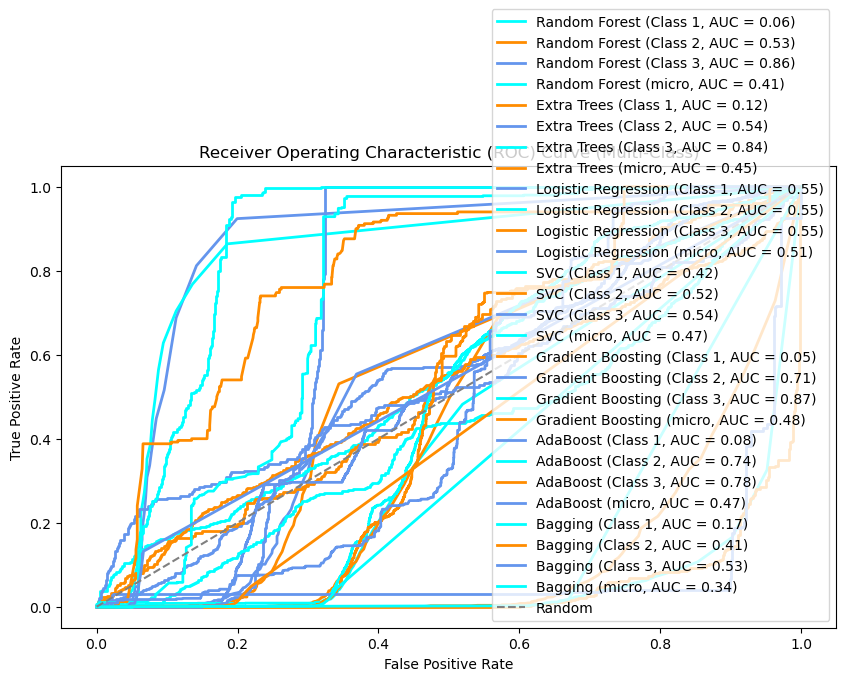

Random Forest: ROC AUC = 0.41
Extra Trees: ROC AUC = 0.45
Logistic Regression: ROC AUC = 0.51
SVC: ROC AUC = 0.47
Gradient Boosting: ROC AUC = 0.48
AdaBoost: ROC AUC = 0.47
Bagging: ROC AUC = 0.34


In [242]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.preprocessing import label_binarize
from itertools import cycle

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

n_classes = len(np.unique(y))

y_test_bin = label_binarize(y_test, classes=list(range(n_classes)))

classifiers = [
    ("Random Forest", RandomForestClassifier()),
    ("Extra Trees", ExtraTreesClassifier()),
    ("Logistic Regression", LogisticRegression()),
    ("SVC", SVC(probability=True)),  
    ("Gradient Boosting", GradientBoostingClassifier()),
    ("AdaBoost", AdaBoostClassifier()),
    ("Bagging", BaggingClassifier())
]

roc_auc_scores = {}

plt.figure(figsize=(10, 6))
colors = cycle(['aqua', 'darkorange', 'cornflowerblue'])

for classifiername, classifier in classifiers:
    classifier.fit(x_train, y_train)
    y_pred_probability = classifier.predict_proba(x_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    
    for i in range(n_classes):
        try:
            fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_probability[:, i])
            roc_auc[i] = roc_auc_score(y_test_bin[:, i], y_pred_probability[:, i])
            plt.plot(fpr[i], tpr[i], color=next(colors), lw=2,
                     label=f'{classifiername} (Class {i}, AUC = {roc_auc[i]:.2f})')
        except ValueError:
            continue
    
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_pred_probability.ravel())
    roc_auc["micro"] = roc_auc_score(y_test_bin, y_pred_probability, average="micro")

    plt.plot(fpr["micro"], tpr["micro"], color=next(colors), lw=2,
             label=f'{classifiername} (micro, AUC = {roc_auc["micro"]:.2f})')

    roc_auc_scores[classifiername] = roc_auc["micro"]

plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve (Multi-Class)')
plt.legend(loc="lower right")
plt.show()

for name, roc_auc in roc_auc_scores.items():
    print(f'{name}: ROC AUC = {roc_auc:.2f}')


Saving the model

We will be using the joblib method to save the file and model.

In [243]:
import joblib
joblib.dump(Selected_model,"Price_Range_Analysis.pkl")

['Price_Range_Analysis.pkl']

In [244]:
model = joblib.load("Price_Range_Analysis.pkl")
prediction = model.predict(x_test)
prediction

array([2., 1., 2., ..., 2., 2., 1.])

now lets compare the original values with our predicted values

In [245]:
finaldata = np.array(y_test)
pricetype = pd.DataFrame()
pricetype["ourprediction"] = prediction
pricetype["originalvalues"] = finaldata
pricetype

,ourprediction,originalvalues
0,2.0,2.0
1,1.0,1.0
2,2.0,2.0
3,1.0,1.0
4,1.0,1.0
...,...,...
1840,1.0,1.0
1841,1.0,1.0
1842,2.0,2.0
1843,2.0,2.0


We can see that our model has performed well, which leads us to conclude the project.